In [1]:
import pandas as pd
import plotly.figure_factory as ff
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from IPython.display import display
from plotly.subplots import make_subplots
pd.set_option('display.float_format', lambda x: '%.2f'%x)
pd.set_option('display.max_colwidth', None)
from prophet import Prophet
import scipy.stats as stats
from statsmodels.graphics.gofplots import qqplot
from statsmodels.stats.multicomp import pairwise_tukeyhsd
import seaborn as sns
import matplotlib.pyplot as plt

### Loading the data and simple check

In [2]:
#reading the data
drug_df =pd.read_csv("F:/DS2024/Projects/Marketing Strategy Dashboard/data_drug.csv", index_col=0, parse_dates=['month'], dayfirst=True)
display(drug_df.head())

,accID,accType,accSize,accTargets,district,month,sales,qty,strategy1,strategy2,strategy3,salesVisit1,salesVisit2,salesVisit3,salesVisit4,salesVisit5,compBrand
1,XYZ-987002,Pharmacy,700,25,3,2013-10-01,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,4
2,XYZ-987002,Pharmacy,700,25,3,2013-11-01,852365,8,0.00,0.00,0.00,0.00,0.00,0.00,0.00,75000.00,4
3,XYZ-987002,Pharmacy,700,25,3,2013-12-01,2557096,25,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,4
4,XYZ-987002,Pharmacy,700,25,3,2014-01-01,4261826,41,0.00,0.00,0.00,0.00,825000.00,300000.00,0.00,0.00,4
5,XYZ-987002,Pharmacy,700,25,3,2014-02-01,5966556,57,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,4


In [3]:
#missing value check
drug_df.isnull().sum()

accID          0
accType        0
accSize        0
accTargets     0
district       0
month          0
sales          0
qty            0
strategy1      0
strategy2      0
strategy3      0
salesVisit1    0
salesVisit2    0
salesVisit3    0
salesVisit4    0
salesVisit5    0
compBrand      0
dtype: int64

In [4]:
#Calculating net income, net income per unit and unit_price
#Net Income = Gross Income - Expenses = Sales - total_expenditures
#unit_price = sales/qty
#net_income_per_unit = net_income/qty
drug_df['total_expenditures'] = drug_df['strategy1'] + drug_df['strategy2']+ drug_df['strategy3'] + drug_df['salesVisit1'] + drug_df['salesVisit2'] + drug_df['salesVisit3'] + drug_df['salesVisit4'] + drug_df['salesVisit5']
drug_df['strategy_expenditures'] =  drug_df['strategy1'] + drug_df['strategy2']+ drug_df['strategy3']
drug_df['salesVisit_expenditures'] = drug_df['total_expenditures'] - drug_df['strategy_expenditures']
drug_df['net_income'] = drug_df['sales'] - drug_df['total_expenditures']
drug_df['net_income_per_unit'] = drug_df['net_income'].divide(drug_df['qty'].abs()).replace(np.inf, 0).replace(-np.inf, 0) #.round(2)
drug_df['unit_price'] = drug_df['sales'].divide(drug_df['qty'].abs()).replace(np.inf, 0).replace(-np.inf, 0) #.round(2)
drug_df = drug_df.fillna(0)
#drug_df = drug_df.round(2)

In [5]:
for column_name in drug_df.columns:
    unique_values = len(drug_df[column_name].unique())
    print("Dataset has '{unique_values}' unique '{column_name}'".format(column_name = column_name, unique_values = unique_values))

Dataset has '124' unique 'accID'
Dataset has '4' unique 'accType'
Dataset has '71' unique 'accSize'
Dataset has '39' unique 'accTargets'
Dataset has '1' unique 'district'
Dataset has '24' unique 'month'
Dataset has '160' unique 'sales'
Dataset has '133' unique 'qty'
Dataset has '219' unique 'strategy1'
Dataset has '754' unique 'strategy2'
Dataset has '29' unique 'strategy3'
Dataset has '27' unique 'salesVisit1'
Dataset has '67' unique 'salesVisit2'
Dataset has '69' unique 'salesVisit3'
Dataset has '16' unique 'salesVisit4'
Dataset has '6' unique 'salesVisit5'
Dataset has '2' unique 'compBrand'
Dataset has '986' unique 'total_expenditures'
Dataset has '886' unique 'strategy_expenditures'
Dataset has '98' unique 'salesVisit_expenditures'
Dataset has '1381' unique 'net_income'
Dataset has '1134' unique 'net_income_per_unit'
Dataset has '163' unique 'unit_price'


As mentioned,

> accType is four types, so for calculation we have to consider each accType

> New competitor drug entrance into the market,m again we have to consider the data before and after the new competitor. Therefore we need to do the 8 different analysis -> 4*2(accType*compBrand) = 8

> district has a single value through the data, so its not important

In [6]:
drug_df.describe().T

,count,mean,std,min,25%,50%,75%,max
accSize,2976.00,364.23,417.46,0.00,60.00,240.00,522.50,2460.00
accTargets,2976.00,15.02,17.41,1.00,2.00,9.50,20.25,102.00
district,2976.00,3.00,0.00,3.00,3.00,3.00,3.00,3.00
sales,2976.00,4251099.72,7564507.53,-5540374.00,0.00,852365.00,5114191.00,51994276.00
qty,2976.00,40.49,72.14,-21.00,0.00,8.00,49.00,500.00
strategy1,2976.00,33322.08,168150.04,0.00,0.00,0.00,0.00,2662031.00
strategy2,2976.00,159399.68,401764.51,0.00,0.00,0.00,18949.50,3161384.00
strategy3,2976.00,6924.98,89119.39,0.00,0.00,0.00,0.00,2236600.00
salesVisit1,2976.00,30544.35,240670.30,0.00,0.00,0.00,0.00,6750000.00
salesVisit2,2976.00,470539.31,789997.91,0.00,0.00,150000.00,600000.00,7125000.00


Findings:
> Negative and Zero values in sales and quantities indicates return of the product and month with zero order. Lets analyze the return order, no order and successful order

### Return orders, no order and successful orders

#### Return Orders

In [7]:
#creating dataset with all the return orders
return_orders = drug_df[drug_df['qty']<0]
display(return_orders)
display(return_orders.accType.value_counts())


,accID,accType,accSize,accTargets,district,month,sales,qty,strategy1,strategy2,...,salesVisit3,salesVisit4,salesVisit5,compBrand,total_expenditures,strategy_expenditures,salesVisit_expenditures,net_income,net_income_per_unit,unit_price
622,XYZ-987036,Hospital,130,8,3,2015-07-01,-4261826,-16,0.00,0.00,...,0.00,0.00,0.00,5,375000.00,0.00,375000.00,-4636826.00,-289801.62,-266364.12
623,XYZ-987036,Hospital,130,8,3,2015-08-01,-5540374,-21,54000.00,0.00,...,0.00,0.00,0.00,5,429000.00,54000.00,375000.00,-5969374.00,-284255.90,-263827.33
633,XYZ-987037,Hospital,300,14,3,2014-06-01,-1491639,-3,97979.00,0.00,...,375000.00,75000.00,0.00,4,1222979.00,97979.00,1125000.00,-2714618.00,-904872.67,-497213.00
705,XYZ-987045,Hospital,370,15,3,2014-06-01,-852365,-8,0.00,0.00,...,450000.00,0.00,0.00,4,750000.00,0.00,750000.00,-1602365.00,-200295.62,-106545.62
709,XYZ-987045,Hospital,370,15,3,2014-10-01,-852365,-8,0.00,0.00,...,600000.00,0.00,0.00,4,900000.00,0.00,900000.00,-1752365.00,-219045.62,-106545.62
1264,XYZ-987083,Polyclinic,200,4,3,2015-01-01,-213091,-1,0.00,0.00,...,0.00,0.00,0.00,4,300000.00,0.00,300000.00,-513091.00,-513091.00,-213091.00
1530,XYZ-987096,Hospital,280,11,3,2015-03-01,-2130913,-8,0.00,0.00,...,1425000.00,0.00,0.00,4,1425000.00,0.00,1425000.00,-3555913.00,-444489.12,-266364.12
1534,XYZ-987096,Hospital,280,11,3,2015-07-01,-1278548,-5,0.00,0.00,...,1050000.00,0.00,0.00,5,1050000.00,0.00,1050000.00,-2328548.00,-465709.60,-255709.60
2329,XYZ-987150,Hospital,240,9,3,2013-10-01,-852365,-8,0.00,0.00,...,0.00,0.00,0.00,4,0.00,0.00,0.00,-852365.00,-106545.62,-106545.62
2336,XYZ-987150,Hospital,240,9,3,2014-05-01,-596656,-6,0.00,0.00,...,150000.00,0.00,0.00,4,450000.00,0.00,450000.00,-1046656.00,-174442.67,-99442.67


Hospital      10
Polyclinic     1
Name: accType, dtype: int64

Note: 
>1. We can see that the return orders in the presence dof strategy 1
>2. Chances of return is high when accType = hospital

In [8]:
return_orders_small_agg = return_orders.groupby("compBrand").agg({'qty':'sum', 'sales':'sum', 'net_income':'sum'}).reset_index()
return_orders_small_agg.columns = ['compBrand', 'return_qty', 'sales_loss', 'net_income_loss']

display(return_orders_small_agg)

,compBrand,return_qty,sales_loss,net_income_loss
0,4,-50,-7841759,-13339738.00
1,5,-42,-11080748,-12934748.00


In [9]:
return_orders_aggregation = return_orders.groupby(['accType', "compBrand"])['accSize',
       'sales', 'qty', 'strategy1', 'strategy2', 'strategy3', 'salesVisit1',
       'salesVisit2', 'salesVisit3', 'salesVisit4', 'salesVisit5',
       'net_income','total_expenditures', 'strategy_expenditures',
       'salesVisit_expenditures'].apply(lambda x : x.sum()).reset_index()
return_orders_aggregation['percentage_profit'] = (return_orders_aggregation['net_income'].divide(return_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
return_orders_aggregation['percentage_strategy1'] = (return_orders_aggregation['strategy1'].divide(return_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
return_orders_aggregation['percentage_strategy2'] = (return_orders_aggregation['strategy2'].divide(return_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
return_orders_aggregation['percentage_strategy3'] = (return_orders_aggregation['strategy3'].divide(return_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
return_orders_aggregation['percentage_salesVisit'] = (return_orders_aggregation['salesVisit_expenditures'].divide(return_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
return_orders_aggregation = return_orders_aggregation.fillna(0)
return_orders_aggregation = return_orders_aggregation.round(2)
return_orders_aggregation['percentage_loss'] = return_orders_aggregation['percentage_profit'].abs()
display(return_orders_aggregation.head(5))

C:\Users\SHUBHAM HARDE\AppData\Local\Temp\ipykernel_8124\3835801246.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  return_orders_aggregation = return_orders.groupby(['accType', "compBrand"])['accSize',


,accType,compBrand,accSize,sales,qty,strategy1,strategy2,strategy3,salesVisit1,salesVisit2,...,net_income,total_expenditures,strategy_expenditures,salesVisit_expenditures,percentage_profit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit,percentage_loss
0,Hospital,4,1960.00,-7628668.00,-49.00,97979.00,0.00,0.00,0.00,1575000.00,...,-12826647.00,5197979.00,97979.00,5100000.00,-246.76,1.88,0.00,0.00,98.12,246.76
1,Hospital,5,540.00,-11080748.00,-42.00,54000.00,0.00,0.00,0.00,750000.00,...,-12934748.00,1854000.00,54000.00,1800000.00,-697.67,2.91,0.00,0.00,97.09,697.67
2,Polyclinic,4,200.00,-213091.00,-1.00,0.00,0.00,0.00,0.00,300000.00,...,-513091.00,300000.00,0.00,300000.00,-171.03,0.00,0.00,0.00,100.00,171.03


Note: in Polyclinic, only one order got return, So we are not considering Polyclinic further of return analysis

In [10]:
fig = px.sunburst(return_orders_aggregation[return_orders_aggregation['accType'] != 'Polyclinic'], path=['accType', 'compBrand',  'percentage_strategy1', 'percentage_strategy2', 'percentage_strategy3',
                                                   'percentage_salesVisit', 'percentage_loss'], values='percentage_loss', color = 'percentage_loss', 
                  hover_data = ['accType', 'compBrand',  'percentage_strategy1', 'percentage_strategy2', 'percentage_strategy3','percentage_salesVisit', 'percentage_loss'] )
fig.update_layout(title = "Return order analysis", title_font_color="red", title_x=0.475)
fig.write_html("Return order analysis.html")
fig.show()

In Return orders:
>1. percentage_loss is suppose to be 100% in all the cases but here we have calculated based on return sales with expendatures 

>2. Approximately **99%** of the return order comes from **Hospital**

>3. Chances of return are high if we only use **stratergy1** along with **salesVisits** in the ratio  of 1/40

>4. net_loss in the presence of a new drug is more than twice for **Hospital**

#### Succesful Orders

In [11]:
#creating dataset with all the successful orders
successful_orders = drug_df[(drug_df['qty'] > 0) & (drug_df['sales'] > 0)]
successful_orders_small_agg = successful_orders.groupby("compBrand").agg({"qty": "sum", "sales": "sum", "net_income": "sum"}).reset_index()
successful_orders_small_agg.columns = ['compBrand', 'placed_qty', 'sales','net_income']
display(successful_orders_small_agg)

,compBrand,placed_qty,sales,net_income
0,4,85298,8970802557,6728082722.00
1,5,35279,3699818908,3065700542.00


In [12]:
successful_return_orders_comparison = pd.merge(successful_orders_small_agg, return_orders_small_agg, on='compBrand', how='inner')
successful_return_orders_comparison['precentage_return'] = ((successful_return_orders_comparison['return_qty']/successful_return_orders_comparison['placed_qty'])*100).abs().round(2)
successful_return_orders_comparison['precentage_sale_loss'] = ((successful_return_orders_comparison['sales_loss']/successful_return_orders_comparison['sales'])*100).abs().round(2)
successful_return_orders_comparison['precentage_net_income_loss_on_return'] = ((successful_return_orders_comparison['net_income_loss']/successful_return_orders_comparison['net_income'])*100).abs().round(2)
display(successful_return_orders_comparison)

,compBrand,placed_qty,sales,net_income,return_qty,sales_loss,net_income_loss,precentage_return,precentage_sale_loss,precentage_net_income_loss_on_return
0,4,85298,8970802557,6728082722.00,-50,-7841759,-13339738.00,0.06,0.09,0.20
1,5,35279,3699818908,3065700542.00,-42,-11080748,-12934748.00,0.12,0.30,0.42


In [13]:
successful_orders_aggregation = successful_orders.groupby(['accType', "compBrand"])['accSize',
       'sales', 'qty', 'strategy1', 'strategy2', 'strategy3', 'salesVisit1',
       'salesVisit2', 'salesVisit3', 'salesVisit4', 'salesVisit5',
       'net_income','total_expenditures', 'strategy_expenditures',
       'salesVisit_expenditures'].apply(lambda x : x.sum()).reset_index()
successful_orders_aggregation['percentage_profit'] = (successful_orders_aggregation['net_income'].divide(successful_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
successful_orders_aggregation['percentage_strategy1'] = (successful_orders_aggregation['strategy1'].divide(successful_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
successful_orders_aggregation['percentage_strategy2'] = (successful_orders_aggregation['strategy2'].divide(successful_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
successful_orders_aggregation['percentage_strategy3'] = (successful_orders_aggregation['strategy3'].divide(successful_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
successful_orders_aggregation['percentage_salesVisit'] = (successful_orders_aggregation['salesVisit_expenditures'].divide(successful_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
successful_orders_aggregation = successful_orders_aggregation.round(2)
display(successful_orders_aggregation.head(10))

C:\Users\SHUBHAM HARDE\AppData\Local\Temp\ipykernel_8124\1552486922.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,accType,compBrand,accSize,sales,qty,strategy1,strategy2,strategy3,salesVisit1,salesVisit2,...,salesVisit5,net_income,total_expenditures,strategy_expenditures,salesVisit_expenditures,percentage_profit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,283510.00,4957739446.00,47329.00,33774878.00,172244171.00,9664049.00,29775000.00,406425000.00,...,3225000.00,3858706348.00,1099033098.00,215683098.00,883350000.00,351.10,3.07,15.67,0.88,80.38
1,Hospital,5,73658.00,1900987438.00,18007.00,4130388.00,58747188.00,4046342.00,7650000.00,126975000.00,...,375000.00,1592188520.00,308798918.00,66923918.00,241875000.00,515.61,1.34,19.02,1.31,78.33
2,Pharmacy,4,356931.00,3553851383.00,33618.00,40644245.00,127955747.00,4853400.00,37425000.00,401700000.00,...,3525000.00,2507172991.00,1046678392.00,173453392.00,873225000.00,239.54,3.88,12.22,0.46,83.43
3,Pharmacy,5,80976.00,1581904543.00,15200.00,7417608.00,47095630.00,910584.00,9075000.00,136875000.00,...,225000.00,1297055721.00,284848822.00,55423822.00,229425000.00,455.35,2.60,16.53,0.32,80.54
4,Polyclinic,4,18760.00,190290517.00,1805.00,430905.00,2585051.00,0.00,150000.00,34950000.00,...,150000.00,135824561.00,54465956.00,3015956.00,51450000.00,249.38,0.79,4.75,0.00,94.46
5,Polyclinic,5,10368.00,153851906.00,1469.00,0.00,3796453.00,0.00,75000.00,16725000.00,...,0.00,126055453.00,27796453.00,3796453.00,24000000.00,453.49,0.00,13.66,0.00,86.34
6,Private Clinic,4,15336.00,268921211.00,2546.00,77631.00,7439758.00,0.00,0.00,21525000.00,...,375000.00,226378822.00,42542389.00,7517389.00,35025000.00,532.13,0.18,17.49,0.00,82.33
7,Private Clinic,5,3290.00,63075021.00,603.00,0.00,3642558.00,256615.00,75000.00,4275000.00,...,300000.00,50400848.00,12674173.00,3899173.00,8775000.00,397.67,0.00,28.74,2.02,69.24


In [14]:
fig = px.sunburst(successful_orders_aggregation, path=['accType', 'compBrand',  'percentage_strategy1', 'percentage_strategy2', 'percentage_strategy3',
                                                       'percentage_salesVisit', 'percentage_profit'], values='percentage_profit', color = 'percentage_profit', 
                  hover_data = ['accType', 'compBrand',  'percentage_strategy1', 'percentage_strategy2', 'percentage_strategy3','percentage_salesVisit', 'percentage_profit'] )
fig.update_layout(title = "Placed order analysis", title_font_color="red", title_x=0.475)
fig.write_html("Placed order analysis.html")
fig.show()

In successful orders:
>1. Whether the new drug is presenent or not, most effiective strategy is to use **strategy2** with the **salesVisits** in the ratio of 1/4.

>2. In **Hospital**, when new durg is presenent then, worst strategy = **strategy1**

>3. In **Pharmacy**, when new durg is presenent then, worst strategy = **strategy1** and **strategy3**

>4. In **Private Clinic**, not clear through ghraph

>5. In **Polyclinic**, when new durg is presenent then, worst strategy = **strategy1** 

#### No Orders

In [15]:
#creating dataset with all no orders
no_orders = drug_df[drug_df['qty'] == 0]

no_orders_small_agg = no_orders.groupby("compBrand").agg({"qty": "sum", "sales": "sum", "net_income": "sum"}).reset_index()
no_orders_small_agg.columns = ['compBrand', 'qty', 'sales_loss_zero','net_income_loss_zero']
no_orders_small_agg = no_orders_small_agg[['compBrand','net_income_loss_zero']]
display(no_orders_small_agg)

,compBrand,net_income_loss_zero
0,4,-512272571.00
1,5,-38160953.00


In [16]:
successful_return_no_orders_comparison = pd.merge(successful_return_orders_comparison, no_orders_small_agg, on='compBrand', how='inner')
successful_return_no_orders_comparison['precentage_net_income_loss'] = (((successful_return_no_orders_comparison['net_income_loss'] + successful_return_no_orders_comparison['net_income_loss_zero'])/successful_return_no_orders_comparison['net_income'])*100).abs().round(2)
display(successful_return_no_orders_comparison[['compBrand', 'placed_qty', 'return_qty', 'precentage_return', 'precentage_sale_loss', 'precentage_net_income_loss_on_return', 'precentage_net_income_loss']])

,compBrand,placed_qty,return_qty,precentage_return,precentage_sale_loss,precentage_net_income_loss_on_return,precentage_net_income_loss
0,4,85298,-50,0.06,0.09,0.20,7.81
1,5,35279,-42,0.12,0.30,0.42,1.67


In [17]:
no_orders_aggregation = no_orders.groupby(['accType', "compBrand"])['accSize',
       'sales', 'qty', 'strategy1', 'strategy2', 'strategy3', 'salesVisit1',
       'salesVisit2', 'salesVisit3', 'salesVisit4', 'salesVisit5',
       'net_income','total_expenditures', 'strategy_expenditures',
       'salesVisit_expenditures'].apply(lambda x : x.sum()).reset_index()
no_orders_aggregation['percentage_profit'] = (no_orders_aggregation['net_income'].divide(no_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
no_orders_aggregation['percentage_strategy1'] = (no_orders_aggregation['strategy1'].divide(no_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
no_orders_aggregation['percentage_strategy2'] = (no_orders_aggregation['strategy2'].divide(no_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
no_orders_aggregation['percentage_strategy3'] = (no_orders_aggregation['strategy3'].divide(no_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
no_orders_aggregation['percentage_salesVisit'] = (no_orders_aggregation['salesVisit_expenditures'].divide(no_orders_aggregation['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
no_orders_aggregation = no_orders_aggregation.round(2)
no_orders_aggregation = no_orders_aggregation.fillna(0)
display(no_orders_aggregation.head(10))

C:\Users\SHUBHAM HARDE\AppData\Local\Temp\ipykernel_8124\2323339326.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,accType,compBrand,accSize,sales,qty,strategy1,strategy2,strategy3,salesVisit1,salesVisit2,...,salesVisit5,net_income,total_expenditures,strategy_expenditures,salesVisit_expenditures,percentage_profit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,107352.00,0.00,0.00,7205615.00,28640790.00,795320.00,4875000.00,104625000.00,...,1575000.00,-265616725.00,265616725.00,36641725.00,228975000.00,-100.00,2.71,10.78,0.30,86.21
1,Hospital,5,4510.00,0.00,0.00,0.00,989550.00,0.00,0.00,5475000.00,...,0.00,-12014550.00,12014550.00,989550.00,11025000.00,-100.00,0.00,8.24,0.00,91.76
2,Pharmacy,4,56849.00,0.00,0.00,3184058.00,6928169.00,0.00,225000.00,23625000.00,...,150000.00,-79937227.00,79937227.00,10112227.00,69825000.00,-100.00,3.98,8.67,0.00,87.35
3,Pharmacy,5,1780.00,0.00,0.00,0.00,0.00,0.00,0.00,3075000.00,...,0.00,-4125000.00,4125000.00,0.00,4125000.00,-100.00,0.00,0.00,0.00,100.00
4,Polyclinic,4,54980.00,0.00,0.00,1406941.00,11045266.00,0.00,1275000.00,84750000.00,...,75000.00,-145052207.00,145052207.00,12452207.00,132600000.00,-100.00,0.97,7.61,0.00,91.42
5,Polyclinic,5,4420.00,0.00,0.00,501649.00,390754.00,0.00,75000.00,12075000.00,...,75000.00,-16867403.00,16867403.00,892403.00,15975000.00,-100.00,2.97,2.32,0.00,94.71
6,Private Clinic,4,6704.00,0.00,0.00,186625.00,2872348.00,82439.00,0.00,9825000.00,...,75000.00,-21666412.00,21666412.00,3141412.00,18525000.00,-100.00,0.86,13.26,0.38,85.50
7,Private Clinic,5,1118.00,0.00,0.00,54000.00,0.00,0.00,0.00,3525000.00,...,0.00,-5154000.00,5154000.00,54000.00,5100000.00,-100.00,1.05,0.00,0.00,98.95


In [18]:
fig = px.sunburst(no_orders_aggregation, path=['accType', 'compBrand',  'percentage_strategy1', 'percentage_strategy2', 'percentage_strategy3',
                                               'percentage_salesVisit', 'total_expenditures'], values='total_expenditures', color = 'compBrand', 
                   hover_data = ['accType', 'compBrand',  'percentage_strategy1', 'percentage_strategy2', 'percentage_strategy3','percentage_salesVisit', 'total_expenditures'] )
fig.update_layout(title = "zero order analysis", title_font_color="red", title_x=0.475)
fig.write_html("zero order analysis.html")
fig.show()

In zero orders:
>1. zero orders in months mean, either no order is placed or order places qual to order return

>2. Hospitals has the highest expendatures with zero orders in the absence of new
competitor

>3. Polyclinc has the highest expendatures with zero orders in the presence of new
competitor

In [19]:
successful_return_no_orders_comparison

,compBrand,placed_qty,sales,net_income,return_qty,sales_loss,net_income_loss,precentage_return,precentage_sale_loss,precentage_net_income_loss_on_return,net_income_loss_zero,precentage_net_income_loss
0,4,85298,8970802557,6728082722.00,-50,-7841759,-13339738.00,0.06,0.09,0.20,-512272571.00,7.81
1,5,35279,3699818908,3065700542.00,-42,-11080748,-12934748.00,0.12,0.30,0.42,-38160953.00,1.67


Findings:
Over all
>Chances of order getting return is twice in the presence of new drug

>Chances of sales lost is more than thrice in the presence of new drug

In Return orders:
>percentage_loss is suppose to be 100% in all the cases but here we have calculated based on return sales with expenditures

>Approximately 99% of the return order comes from Hospital

>Chances of return are high if we only use stratergy1 along with salesVisits in the ratio of 1/40

>net_loss in the presence of a new drug is more than twice for Hospital

In successful orders:
>Whether the new drug is present or not, most effective strategy is to use strategy2 with the salesVisits in the ratio of 1/4.

>In Hospital, when new durg is presenent then, worst strategy = strategy1

>In Pharmacy, when new durg is presenent then, worst strategy = strategy1 and strategy3

>In Private Clinic, not clear through ghraph

>In Polyclinic, when new durg is presenent then, worst strategy = strategy1

In zero orders:
>zero orders in months mean, either no order is placed or order places qual to order return

>Hospitals has the highest expenditures with zero orders in the absence of new competitor

>Polyclinc has the highest expenditures with zero orders in the presence of new competitor

We will verify our findings with statical tests with a much deeper analysis

## Checking the distribution and density with accType

In [20]:
fig = go.Figure()
accTypes = drug_df['accType'].unique()
for accType in accTypes:
    fig.add_trace(go.Violin(x=drug_df['accType'][drug_df['accType'] == accType],
                            y=drug_df['net_income'][drug_df['accType'] == accType],
                            name=accType,
                            box_visible=True,
                            meanline_visible=True))
    
fig.update_layout(title = "Distribution and density of net_income", title_font_color="red",)
fig.update_xaxes(title = 'accType',title_font_family="Arial")
fig.update_traces(points='all', # show all points
                  jitter=0.05,  # add some jitter on points for better visibility
                  scalemode='count')
fig.write_html("Distribution and density of net_income.html")
fig.show()

Distribution and density of net_income

>net_income = 0, is the highly dense region in all of the accType except Pharmacy

>net_income in Pharmacy:

            a. Mean = 7381283 SGD

            b. Median = 2910322 SGD

            c. More dense towards positive net_income

>net_income in Hospital:

            a. Mean = 3760783 SGD

            b. Median = 852365 SGD

            c. dense towards positive net_income

>net_income in Polyclinic:

            a. Mean = 118389.7 SGD

            b. Median = 0 SGD

            c. very little dense towards positive net_income

>net_income in Private Clinic:

            a. Mean = 946815.4 SGD

            b. Median = 0 SGD

            c. little dense towards positive net_income

From the above stats we can conclude that Chances of loss is very low in Pharmacy and very high in Polyclinic and Private Clinic

In [21]:
import plotly.graph_objects as go
fig = go.Figure()
accTypes = drug_df['accType'].unique()
pointpos_net_income_per_unit = [-0.35,-0.76,-0.55,-0.3]
pointpos_unit_price = [0.6,0.66,0.5,0.35]

show_legend = [True,False,False,False]
for accType, i in zip(accTypes, range(len(accTypes))):
    fig.add_trace(go.Violin(x=successful_orders['accType'][successful_orders['accType'] == accType],
                            y=successful_orders['net_income_per_unit'][successful_orders['accType'] == accType],
                            name = 'net_income_per_unit',
                            line_color='lightseagreen',
                            #box_visible=True,
                            pointpos=pointpos_net_income_per_unit[i],
                            side='negative',
                            showlegend=show_legend[i]))
    
    fig.add_trace(go.Violin(x=successful_orders['accType'][successful_orders['accType'] == accType],
                            y=successful_orders['unit_price'][successful_orders['accType'] == accType],
                            name = 'unit_price',
                            line_color='mediumpurple',
                            #box_visible=True,
                            pointpos=pointpos_unit_price[i],
                            side='positive',
                            showlegend=show_legend[i]))
    
fig.update_layout(title = "Distribution and density of net_income_per_unit vs unit_price for successfull orders", title_font_color="red",
                  violingap=0, violingroupgap=0, violinmode='overlay')
fig.update_xaxes(title = 'accType',title_font_family="Arial")
fig.update_traces(meanline_visible=True,
                  points='all', # show all points
                  jitter=0.05,  # add some jitter on points for better visibility
                  scalemode='count'
                  ) 
fig.write_html("Distribution and density of net_income_per_unit vs unit_price.html")
fig.show()

Distribution and density of net_income_per_unit vs unit_price

>In Pharmacy:

            a. Average profit on per unit = 21470.49 SGD/qty

            b. Average selling price per unit = 106287.7 SGD/qty

            c. Average expenditure per unit = 84817.21 SGD/qty --> b-a

            d. Percentage profit per unit = 25.31% --> (a/c)*100

>In Hospital:

            a. Average profit on per unit = 59963.84 SGD/qty

            b. Average selling price per unit = 106823 SGD/qty

            c. Average expenditure per unit = 46859.16 SGD/qty

            d. Percentage profit per unit = 127.97%

>In Polyclinc:

            a. Average profit on per unit = 69256.18 SGD/qty

            b. Average selling price per unit = 106727.4 SGD/qty

            c. Average expenditure per unit = 37471.22 SGD/qty

            d. Percentage profit per unit = 184.83%

>In Private clinic:

            a. Average profit on per unit = 80109.3 SGD/qty

            b. Average selling price per unit = 112185.9 SGD/qty

            c. Average expenditure per unit = 32076.6 SGD/qty
    
            d. Percentage profit per unit = 249.74%

> Findings

Pharmacy has the highest mean of net income i.e., 7381283 SGD
Polyclinic has the lowest mean of net income i.e., 118389.7 SGD
Chances of loss are low in Pharmacy and high in Polyclinic and Private Clinic
In the private clinic, we have the highest selling price per unit(112185.9 SGD/qty) and the lowest expenditure per unit( 32076.6 SGD/qty). Because of this here were getting 249.74% profit per unit on average.

## Analysing the combination of strategies

In [22]:
#adding quaters to analyse strategies performace in a quater
drug_df['quarter'] = pd.PeriodIndex(drug_df.month, freq='Q')

In [23]:
def aggregation_func(drug_df, list_of_strategies, include_salesVisit = False, quarter = False):
  """
  drug_df : pandas data frame
  list_of_strategies : strategies in the form of list e.g., ['strategy1] or ['strategy1', 'strategy2'] or [] for no strategy
  include_salesVisit: default "False", if "True" then include salesVisit expenditures
  quarter: default "False", if "True" then do the quarter wise aggregation

  This function will do the strategy wise aggregation
  """
  if isinstance(list_of_strategies, list):
    if(all(x in ['strategy1', 'strategy2', 'strategy3'] for x in list_of_strategies)):
      n_strategies = len(list_of_strategies)
      if (n_strategies == 0  and include_salesVisit == False):
        print("drug_df[(drug_df['total_expenditures'] == 0)]")
        temp_df = drug_df[(drug_df['total_expenditures'] == 0)]
      elif (n_strategies == 0  and include_salesVisit == True):
        print("drug_df[(drug_df['strategy_expenditures'] == 0) & (drug_df['salesVisit_expenditures'] > 0)]")
        temp_df = drug_df[(drug_df['strategy_expenditures'] == 0) & (drug_df['salesVisit_expenditures'] > 0)]
      else:
        temp_sing = n_strategies
        if include_salesVisit:
          expenditures_addition_str = "drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == "
        else:
          expenditures_addition_str = "drug_df[(drug_df['total_expenditures'] == "
        expenditures_and_str = ""
        for strategy in list_of_strategies:
          expenditures_addition_str = expenditures_addition_str + "drug_df['"+strategy+"']"
          expenditures_and_str = expenditures_and_str + " & (drug_df['"+strategy+"'] > 0)"
          temp_sing = temp_sing - 1
          if temp_sing > 0:
            expenditures_addition_str = expenditures_addition_str + " + "
          else:
            expenditures_str = expenditures_addition_str + ")"
            expenditures_str = expenditures_str + expenditures_and_str + "]"
        print(expenditures_str)
        temp_df = eval(expenditures_str)
      if quarter:
        print('quarter aggregation')
        temp_df_agg = temp_df.groupby(["accType", "compBrand", "quarter"]).agg({"qty": "sum", "sales": "sum", "net_income": "sum", 
                                                                  "strategy1": "sum", "strategy2": "sum", "strategy3": "sum",
                                                                  "total_expenditures": "sum", "strategy_expenditures": "sum","salesVisit_expenditures": "sum"}
                                                                  ).reset_index()
      else:
        print('without quarter aggregation')
        temp_df_agg = temp_df.groupby(["accType", "compBrand"]).agg({"qty": "sum", "sales": "sum", "net_income": "sum", 
                                                                    "strategy1": "sum", "strategy2": "sum", "strategy3": "sum",
                                                                    "total_expenditures": "sum", "strategy_expenditures": "sum","salesVisit_expenditures": "sum"}
                                                                    ).reset_index()
      temp_df_agg['unit_price'] = temp_df_agg['sales']/temp_df_agg['qty']
      temp_df_agg['net_income_per_unit'] = temp_df_agg['net_income']/temp_df_agg['qty']
      temp_df_agg['expenditures_per_unit'] = temp_df_agg['unit_price'] - temp_df_agg['net_income_per_unit']
      temp_df_agg['percentage_profit'] = (temp_df_agg['net_income'].divide(temp_df_agg['total_expenditures'].abs()).replace(np.inf, 0).round(4))*100
      temp_df_agg['percentage_strategy1'] = (temp_df_agg['strategy1']/temp_df_agg['total_expenditures'])*100
      temp_df_agg['percentage_strategy2'] = (temp_df_agg['strategy2']/temp_df_agg['total_expenditures'])*100
      temp_df_agg['percentage_strategy3'] = (temp_df_agg['strategy3']/temp_df_agg['total_expenditures'])*100
      temp_df_agg['percentage_salesVisit'] = (temp_df_agg['salesVisit_expenditures']/temp_df_agg['total_expenditures'])*100

      return temp_df_agg
    else:
      raise KeyError(", ".join(list_of_strategies) + " is not in ['strategy1', 'strategy2', 'strategy3']")
  else:
    raise TypeError("Please pass strategies in the form of list e.g., ['strategy1] or ['strategy1', 'strategy2'] or [] for no strategy")




In [24]:
imp_cols_for_analysis = ['accType', 'compBrand', 'sales', 'net_income', 'unit_price', 'net_income_per_unit','expenditures_per_unit',
       'percentage_strategy1','percentage_strategy2', 'percentage_strategy3','percentage_salesVisit']

In [25]:
#this list will store the data with all types of strategies
List_of_all_types_of_data = []

In [26]:
data_with_zero_expenditures = aggregation_func(drug_df, [], False)
List_of_all_types_of_data.append('data_with_zero_expenditures')
display(data_with_zero_expenditures[imp_cols_for_analysis])

drug_df[(drug_df['total_expenditures'] == 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,229371468,229371468.00,105994.21,105994.21,0.00,NaN,NaN,NaN,NaN
1,Hospital,5,14490207,14490207.00,105001.50,105001.50,0.00,NaN,NaN,NaN,NaN
2,Pharmacy,4,52889259,52889259.00,107063.28,107063.28,0.00,NaN,NaN,NaN,NaN
3,Pharmacy,5,11933112,11933112.00,104676.42,104676.42,0.00,NaN,NaN,NaN,NaN
4,Polyclinic,4,36651699,36651699.00,105019.19,105019.19,0.00,NaN,NaN,NaN,NaN
5,Polyclinic,5,31111328,31111328.00,104751.95,104751.95,0.00,NaN,NaN,NaN,NaN
6,Private Clinic,4,5114191,5114191.00,213091.29,213091.29,0.00,NaN,NaN,NaN,NaN
7,Private Clinic,5,6818921,6818921.00,104906.48,104906.48,0.00,NaN,NaN,NaN,NaN


In [27]:
data_only_with_salesVisit_expenditures = aggregation_func(drug_df, [], True)
List_of_all_types_of_data.append('data_only_with_salesVisit_expenditures')
display(data_only_with_salesVisit_expenditures[imp_cols_for_analysis])

drug_df[(drug_df['strategy_expenditures'] == 0) & (drug_df['salesVisit_expenditures'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,1891994983,1386419983.00,104455.09,76542.81,27912.27,0.00,0.00,0.00,100.00
1,Hospital,5,686878479,584578479.00,104372.96,88828.21,15544.75,0.00,0.00,0.00,100.00
2,Pharmacy,4,850404740,617604740.00,107892.00,78356.35,29535.65,0.00,0.00,0.00,100.00
3,Pharmacy,5,281706693,240381693.00,104879.63,89494.30,15385.33,0.00,0.00,0.00,100.00
4,Polyclinic,4,115495475,-30229525.00,105959.15,-27733.51,133692.66,0.00,0.00,0.00,100.00
5,Polyclinic,5,92907799,58557799.00,104743.85,66017.81,38726.04,0.00,0.00,0.00,100.00
6,Private Clinic,4,161523199,127848199.00,104953.35,83072.25,21881.09,0.00,0.00,0.00,100.00
7,Private Clinic,5,18752032,11477032.00,105348.49,64477.71,40870.79,0.00,0.00,0.00,100.00


In [28]:
data_only_with_strategy1_expenditures = aggregation_func(drug_df, ['strategy1'], False)
List_of_all_types_of_data.append('data_only_with_strategy1_expenditures')
display(data_only_with_strategy1_expenditures[imp_cols_for_analysis])

drug_df[(drug_df['total_expenditures'] == drug_df['strategy1']) & (drug_df['strategy1'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,11080747,10698031.00,135131.06,130463.79,4667.27,100.00,0.00,0.00,0.00
1,Pharmacy,4,852365,57109.00,106545.62,7138.62,99407.00,100.00,0.00,0.00,0.00
2,Polyclinic,4,0,-183750.00,NaN,-inf,NaN,100.00,0.00,0.00,0.00
3,Polyclinic,5,0,-408440.00,NaN,-inf,NaN,100.00,0.00,0.00,0.00
4,Private Clinic,4,0,-104233.00,NaN,-inf,NaN,100.00,0.00,0.00,0.00


In [29]:
data_with_strategy1_and_salesVisit_expenditures = aggregation_func(drug_df, ['strategy1'], True)
List_of_all_types_of_data.append('data_with_strategy1_and_salesVisit_expenditures')
display(data_with_strategy1_and_salesVisit_expenditures[imp_cols_for_analysis])

drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy1']) & (drug_df['strategy1'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,559279413,426113148.00,105944.20,80718.54,25225.66,18.79,0.00,0.00,81.21
1,Hospital,5,90776892,76592434.00,100195.25,84539.11,15656.13,15.93,0.00,0.00,84.07
2,Pharmacy,4,297560682,190662277.00,105705.39,67730.83,37974.57,9.84,0.00,0.00,90.16
3,Pharmacy,5,28724707,25621328.00,103699.30,92495.77,11203.53,13.00,0.00,0.00,87.00
4,Polyclinic,4,7671287,4395670.00,103666.04,59400.95,44265.09,33.60,0.00,0.00,66.40
5,Polyclinic,5,0,-318209.00,NaN,-inf,NaN,29.29,0.00,0.00,70.71
6,Private Clinic,4,3409461,3024438.00,103317.00,91649.64,11667.36,41.56,0.00,0.00,58.44
7,Private Clinic,5,0,-354000.00,NaN,-inf,NaN,15.25,0.00,0.00,84.75


In [30]:
data_only_with_strategy2_expenditures = aggregation_func(drug_df, ['strategy2'], False)
List_of_all_types_of_data.append('data_only_with_strategy2_expenditures')
display(data_only_with_strategy2_expenditures[imp_cols_for_analysis])

drug_df[(drug_df['total_expenditures'] == drug_df['strategy2']) & (drug_df['strategy2'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,14490208,11715263.00,103501.49,83680.45,19821.04,0.00,100.00,0.00,0.00
1,Hospital,5,33242242,31965710.00,103882.01,99892.84,3989.16,0.00,100.00,0.00,0.00
2,Pharmacy,4,8097469,7214695.00,122688.92,109313.56,13375.36,0.00,100.00,0.00,0.00
3,Polyclinic,4,0,-774674.00,NaN,-inf,NaN,0.00,100.00,0.00,0.00
4,Polyclinic,5,2557095,1641345.00,106545.62,68389.38,38156.25,0.00,100.00,0.00,0.00
5,Private Clinic,4,0,-223000.00,NaN,-inf,NaN,0.00,100.00,0.00,0.00


In [31]:
data_with_strategy2_and_salesVisit_expenditures = aggregation_func(drug_df, ['strategy2'], True)
List_of_all_types_of_data.append('data_with_strategy2_and_salesVisit_expenditures')
display(data_with_strategy2_and_salesVisit_expenditures[imp_cols_for_analysis])

drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy2']) & (drug_df['strategy2'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,1667439384,1140275808.00,104456.52,71432.43,33024.09,0.00,29.31,0.00,70.69
1,Hospital,5,932913688,763087276.00,106278.62,86931.79,19346.82,0.00,30.44,0.00,69.56
2,Pharmacy,4,1132409760,730664895.00,104872.18,67666.69,37205.49,0.00,18.72,0.00,81.28
3,Pharmacy,5,898137193,720747071.00,103878.93,83361.91,20517.02,0.00,19.16,0.00,80.84
4,Polyclinic,4,27701869,-16930424.00,104142.36,-63648.21,167790.58,0.00,26.06,0.00,73.94
5,Polyclinic,5,27275684,18604227.00,104504.54,71280.56,33223.97,0.00,37.73,0.00,62.27
6,Private Clinic,4,98874360,70130786.00,104078.27,73821.88,30256.39,0.00,35.03,0.00,64.97
7,Private Clinic,5,32389877,23872319.00,104147.51,76759.87,27387.65,0.00,42.77,0.00,57.23


In [32]:
data_only_with_strategy3_expenditures = aggregation_func(drug_df, ['strategy3'], False)
List_of_all_types_of_data.append('data_only_with_strategy3_expenditures')
display(data_only_with_strategy3_expenditures[imp_cols_for_analysis])

drug_df[(drug_df['total_expenditures'] == drug_df['strategy3']) & (drug_df['strategy3'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit


In [33]:
data_with_strategy3_and_salesVisit_expenditures = aggregation_func(drug_df, ['strategy3'], True)
List_of_all_types_of_data.append('data_with_strategy3_and_salesVisit_expenditures')
display(data_with_strategy3_and_salesVisit_expenditures[imp_cols_for_analysis])

drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy3']) & (drug_df['strategy3'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,33242242,14079667.00,103882.01,43998.96,59883.05,0.00,0.00,40.51,59.49
1,Hospital,5,28128051,21882103.00,103793.55,80745.77,23047.78,0.00,0.00,14.74,85.26
2,Pharmacy,4,27275686,17359446.00,104105.67,66257.43,37848.24,0.00,0.00,33.44,66.56
3,Private Clinic,5,5114191,3432576.00,104371.24,70052.57,34318.67,0.00,0.00,15.26,84.74


In [34]:
data_only_with_strategy1_and_strategy2_expenditures = aggregation_func(drug_df, ['strategy1', 'strategy2'], False)
List_of_all_types_of_data.append('data_only_with_strategy1_and_strategy2_expenditures')
display(data_only_with_strategy1_and_strategy2_expenditures[imp_cols_for_analysis])

drug_df[(drug_df['total_expenditures'] == drug_df['strategy1'] + drug_df['strategy2']) & (drug_df['strategy1'] > 0) & (drug_df['strategy2'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,1704730,439374.00,106545.62,27460.88,79084.75,34.87,65.13,0.00,0.00


In [35]:
data_with_strategy1_strategy2_and_salesVisit_expenditures = aggregation_func(drug_df, ['strategy1', 'strategy2'], True)
List_of_all_types_of_data.append('data_with_strategy1_strategy2_and_salesVisit_expenditures')
display(data_with_strategy1_strategy2_and_salesVisit_expenditures[imp_cols_for_analysis])

drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy1'] + drug_df['strategy2']) & (drug_df['strategy1'] > 0) & (drug_df['strategy2'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,527017394,355085745.00,103580.46,69788.86,33791.60,8.85,23.49,0.00,67.66
1,Hospital,5,76712865,61903197.00,107440.99,86699.16,20741.83,13.00,27.24,0.00,59.76
2,Pharmacy,4,1145152623,784158654.00,104905.88,71835.71,33070.17,9.01,16.18,0.00,74.81
3,Pharmacy,5,346912630,284144473.00,103928.29,85124.17,18804.12,8.88,20.14,0.00,70.98
4,Polyclinic,4,2557096,-2669733.00,102283.84,-106789.32,209073.16,10.59,23.41,0.00,66.01


In [36]:
data_only_with_strategy1_and_strategy3_expenditures = aggregation_func(drug_df, ['strategy1', 'strategy3'], False)
List_of_all_types_of_data.append('data_only_with_strategy1_and_strategy3_expenditures')
display(data_only_with_strategy1_and_strategy3_expenditures[imp_cols_for_analysis])

drug_df[(drug_df['total_expenditures'] == drug_df['strategy1'] + drug_df['strategy3']) & (drug_df['strategy1'] > 0) & (drug_df['strategy3'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit


In [37]:
data_with_strategy1_strategy3_and_salesVisit_expenditures = aggregation_func(drug_df, ['strategy1', 'strategy3'], True)
List_of_all_types_of_data.append('data_with_strategy1_strategy3_and_salesVisit_expenditures')
display(data_with_strategy1_strategy3_and_salesVisit_expenditures[imp_cols_for_analysis])

drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy1'] + drug_df['strategy3']) & (drug_df['strategy1'] > 0) & (drug_df['strategy3'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit


In [38]:
data_only_with_strategy2_and_strategy3_expenditures = aggregation_func(drug_df, ['strategy2', 'strategy3'], False)
List_of_all_types_of_data.append('data_only_with_strategy2_and_strategy3_expenditures')
display(data_only_with_strategy2_and_strategy3_expenditures[imp_cols_for_analysis])

drug_df[(drug_df['total_expenditures'] == drug_df['strategy2'] + drug_df['strategy3']) & (drug_df['strategy2'] > 0) & (drug_df['strategy3'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit


In [39]:
data_with_strategy2_strategy3_and_salesVisit_expenditures = aggregation_func(drug_df, ['strategy2', 'strategy3'], True)
List_of_all_types_of_data.append('data_with_strategy2_strategy3_and_salesVisit_expenditures')
display(data_with_strategy2_strategy3_and_salesVisit_expenditures[imp_cols_for_analysis])

drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy2'] + drug_df['strategy3']) & (drug_df['strategy2'] > 0) & (drug_df['strategy3'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,14064026,5307846.00,114341.67,43153.22,71188.46,0.00,21.33,26.42,52.25
1,Hospital,5,26764266,12739816.00,104141.11,49571.27,54569.84,0.00,19.42,22.29,58.29
2,Pharmacy,4,39208799,26624689.00,104002.12,70622.52,33379.60,0.00,3.15,12.22,84.63
3,Private Clinic,4,0,-1077971.00,NaN,-inf,NaN,0.00,1.90,7.65,90.45


In [40]:
data_only_with_strategies_expenditures = aggregation_func(drug_df, ['strategy1', 'strategy2', 'strategy3'], False)
List_of_all_types_of_data.append('data_only_with_strategies_expenditures')
display(data_only_with_strategies_expenditures[imp_cols_for_analysis])

drug_df[(drug_df['total_expenditures'] == drug_df['strategy1'] + drug_df['strategy2'] + drug_df['strategy3']) & (drug_df['strategy1'] > 0) & (drug_df['strategy2'] > 0) & (drug_df['strategy3'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit


In [41]:
data_with_all_type_of_expenditures = aggregation_func(drug_df, ['strategy1', 'strategy2', 'strategy3'], True)
List_of_all_types_of_data.append('data_with_all_type_of_expenditures')
display(data_with_all_type_of_expenditures[imp_cols_for_analysis])

drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy1'] + drug_df['strategy2'] + drug_df['strategy3']) & (drug_df['strategy1'] > 0) & (drug_df['strategy2'] > 0) & (drug_df['strategy3'] > 0)]
without quarter aggregation


,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,4,0,-1994540.00,NaN,-inf,NaN,0.71,27.43,19.21,52.64
1,Pharmacy,5,14490208,10103044.00,104246.10,72683.77,31562.33,32.79,10.56,20.76,35.90


In [42]:
#combining all the strategies to single dataframe called over_all_data_comparison
over_all_data_comparison = pd.DataFrame(columns = ['type_of_agg','accType', 'compBrand', 'qty', 'sales', 'net_income', 'strategy1',
       'strategy2', 'strategy3', 'total_expenditures', 'strategy_expenditures',
       'salesVisit_expenditures', 'unit_price', 'net_income_per_unit',
       'expenditures_per_unit', 'percentage_profit',
       'percentage_strategy1', 'percentage_strategy2',
       'percentage_strategy3', 'percentage_salesVisit'] )


for agg_data in List_of_all_types_of_data:
  exec(agg_data+"['type_of_agg']" + "=" + "agg_data")
  over_all_data_comparison = pd.concat([over_all_data_comparison, eval(agg_data)], ignore_index=True)

over_all_data_comparison = over_all_data_comparison.sort_values(by=['accType', "compBrand"], ignore_index=True)
over_all_data_comparison = over_all_data_comparison.round(2)
display(over_all_data_comparison.head(100))

,type_of_agg,accType,compBrand,qty,sales,net_income,strategy1,strategy2,strategy3,total_expenditures,strategy_expenditures,salesVisit_expenditures,unit_price,net_income_per_unit,expenditures_per_unit,percentage_profit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,data_with_zero_expenditures,Hospital,4,2164,229371468,229371468.00,0.00,0.00,0.00,0.00,0.00,0.00,105994.21,105994.21,0.00,0.00,NaN,NaN,NaN,NaN
1,data_only_with_salesVisit_expenditures,Hospital,4,18113,1891994983,1386419983.00,0.00,0.00,0.00,505575000.00,0.00,505575000.00,104455.09,76542.81,27912.27,274.23,0.00,0.00,0.00,100.00
2,data_only_with_strategy1_expenditures,Hospital,4,82,11080747,10698031.00,382716.00,0.00,0.00,382716.00,382716.00,0.00,135131.06,130463.79,4667.27,2795.29,100.00,0.00,0.00,0.00
3,data_with_strategy1_and_salesVisit_expenditures,Hospital,4,5279,559279413,426113148.00,25016265.00,0.00,0.00,133166265.00,25016265.00,108150000.00,105944.20,80718.54,25225.66,319.99,18.79,0.00,0.00,81.21
4,data_only_with_strategy2_expenditures,Hospital,4,140,14490208,11715263.00,0.00,2774945.00,0.00,2774945.00,2774945.00,0.00,103501.49,83680.45,19821.04,422.18,0.00,100.00,0.00,0.00
5,data_with_strategy2_and_salesVisit_expenditures,Hospital,4,15963,1667439384,1140275808.00,0.00,154488576.00,0.00,527163576.00,154488576.00,372675000.00,104456.52,71432.43,33024.09,216.30,0.00,29.31,0.00,70.69
6,data_with_strategy3_and_salesVisit_expenditures,Hospital,4,320,33242242,14079667.00,0.00,0.00,7762575.00,19162575.00,7762575.00,11400000.00,103882.01,43998.96,59883.05,73.47,0.00,0.00,40.51,59.49
7,data_only_with_strategy1_and_strategy2_expenditures,Hospital,4,16,1704730,439374.00,441232.00,824124.00,0.00,1265356.00,1265356.00,0.00,106545.62,27460.88,79084.75,34.72,34.87,65.13,0.00,0.00
8,data_with_strategy1_strategy2_and_salesVisit_expenditures,Hospital,4,5088,527017394,355085745.00,15224039.00,40382610.00,0.00,171931649.00,55606649.00,116325000.00,103580.46,69788.86,33791.60,206.53,8.85,23.49,0.00,67.66
9,data_with_strategy2_strategy3_and_salesVisit_expenditures,Hospital,4,123,14064026,5307846.00,0.00,1867506.00,2313674.00,8756180.00,4181180.00,4575000.00,114341.67,43153.22,71188.46,60.62,0.00,21.33,26.42,52.25


In [50]:
print(List_of_all_types_of_data)

['data_with_zero_expenditures', 'data_only_with_salesVisit_expenditures', 'data_only_with_strategy1_expenditures', 'data_with_strategy1_and_salesVisit_expenditures', 'data_only_with_strategy2_expenditures', 'data_with_strategy2_and_salesVisit_expenditures', 'data_only_with_strategy3_expenditures', 'data_with_strategy3_and_salesVisit_expenditures', 'data_only_with_strategy1_and_strategy2_expenditures', 'data_with_strategy1_strategy2_and_salesVisit_expenditures', 'data_only_with_strategy1_and_strategy3_expenditures', 'data_with_strategy1_strategy3_and_salesVisit_expenditures', 'data_only_with_strategy2_and_strategy3_expenditures', 'data_with_strategy2_strategy3_and_salesVisit_expenditures', 'data_only_with_strategies_expenditures', 'data_with_all_type_of_expenditures']


In [43]:
#handing the null and infinity values after the aggregation for plotting
over_all_data_comparison_exp = over_all_data_comparison.fillna(0).replace(-np.inf, 0).replace(np.inf, 0)

In [44]:
labels = ['Sales_4', 'net_income_4', 'Sales_5', 'net_income_5']
colors = ['RGB(227,207,87)', 'RGB(0,0,205)', 'RGB(255,97,3)', 'RGB(5,5,5)']

line_size = [2, 4, 2, 4]

for accType_ in over_all_data_comparison_exp['accType'].unique():
  temp_over_all_data_comparison_exp = over_all_data_comparison_exp[over_all_data_comparison_exp['accType'] == accType_]
  x_data = [list(temp_over_all_data_comparison_exp['type_of_agg'].unique()),
            list(temp_over_all_data_comparison_exp['type_of_agg'].unique()),
            list(temp_over_all_data_comparison_exp['type_of_agg'].unique()),
            list(temp_over_all_data_comparison_exp['type_of_agg'].unique())]
  y_data = [list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 4]['sales']),
            list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 4]['net_income']),
            list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 5]['sales']),
            list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 5]['net_income'])]

  text_data = [list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 4]['qty']),
        list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 4]['qty']),
        list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 5]['qty']),
        list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 5]['qty'])]

  fig = go.Figure()

  for i in range(len(y_data)):
    if (i % 2) == 0:
      cat_val = 'sales'
    else:
      cat_val = 'net_income'
    fig.add_trace(go.Scatter(x=x_data[i], y=y_data[i], mode='lines',
        name=labels[i],
        line=dict(color=colors[i], width=line_size[i]),
        text = text_data[i],
        connectgaps=True,
        hovertemplate= '<b>type_of_agg</b>: %{x}<br>'+
                       '<b>'+cat_val+'<b>: %{y}<br>' +
                       '<b>qty</b>: %{text}<br>',
    ))

  fig.update_layout(title = "sales vs net_income from "+accType_, title_font_color="red", yaxis=dict(tickformat="20,.2f"))
  fig.write_html("sales vs net_income from "+accType_+".html")
  fig.show()

In Hospital net_income and sale
>Without the new drug, best strategy is data_only_with_salesVisit_expenditures

>With the new drug, top2 best strategy is data_only_with_strategy2_expenditures

In Pharmacy net_income and sale
>Without the new drug, best strategy is data_with_strategy1_strategy2_and_salesVisit_expenditures

>With the new drug, best strategy is data_with_strategy1_and_salesVisit_expenditures

In Polyclinic net_income and sale
>Without the new drug, best strategy is data_with_strategy1_and_salesVisit_expenditures

>With the new drug, best strategy is data_only_with_salesVisit_expenditures

In Private Clinic net_income and sale
>Without the new drug, best strategy is data_only_with_salesVisit_expenditures

>With the new drug, best strategy is data_only_with_strategy2_expenditures

In [45]:
labels = ['unit_price_4', 'net_income_per_unit_4', 'unit_price_5', 'net_income_per_unit_5']
colors = ['RGB(227,207,87)', 'RGB(0,0,205)', 'RGB(255,97,3)', 'RGB(5,5,5)']

line_size = [2, 4, 2, 4]

for accType_ in over_all_data_comparison_exp['accType'].unique():
  temp_over_all_data_comparison_exp = over_all_data_comparison_exp[over_all_data_comparison_exp['accType'] == accType_]
  x_data = [list(temp_over_all_data_comparison_exp['type_of_agg'].unique()),
            list(temp_over_all_data_comparison_exp['type_of_agg'].unique()),
            list(temp_over_all_data_comparison_exp['type_of_agg'].unique()),
            list(temp_over_all_data_comparison_exp['type_of_agg'].unique())]
  y_data = [list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 4]['unit_price']),
            list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 4]['net_income_per_unit']),
            list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 5]['unit_price']),
            list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 5]['net_income_per_unit'])]

  text_data = [list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 4]['qty']),
        list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 4]['qty']),
        list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 5]['qty']),
        list(temp_over_all_data_comparison_exp[temp_over_all_data_comparison_exp['compBrand'] == 5]['qty'])]


  fig = go.Figure()

  for i in range(len(y_data)):
      fig.add_trace(go.Scatter(x=x_data[i], y=y_data[i], mode='lines',
          name=labels[i],
          line=dict(color=colors[i], width=line_size[i]),
          text = text_data[i],
          connectgaps=True,
          hovertemplate= '<b>type_of_agg</b>: %{x}<br>'+
                       '<b>'+cat_val+'<b>: %{y}<br>' +
                       '<b>qty</b>: %{text}<br>',
      ))

  fig.update_layout(title = "unit_price vs net_income_per_unit from "+accType_, title_font_color="red",yaxis=dict(tickformat="20,.2f"))
  fig.write_html("unit_price vs net_income_per_unit from "+accType_+".html")
  fig.show()

In Hospital for net_income_per_inut
>Without the new drug, best strategy is data_only_with_strategy1_expenditures

>With the new drug, best strategy is data_with_strategy1_and_salesVisit_expenditures

In Pharmacy net_income_per_inut
>Without the new drug, best strategy is data_only_with_strategy2_expenditures

>With the new drug, top2 strategeis is data_with_zero_expenditures

In Polyclinic net_income_per_inut
>Without the new drug, best strategy is data_with_zero_expenditures

>With the new drug, best strategy is data_only_with_strategy2_expenditures


In Private Clinic net_income_per_inut
>Without the new drug, best strategy is data_with_zero_expenditures

>With the new drug, best strategy is data_with_zero_expenditures

In [46]:
fig = px.scatter_3d(over_all_data_comparison, x='type_of_agg', y='net_income', z='qty', color='accType', symbol = 'compBrand', width=900, height=900, hover_data= over_all_data_comparison)
fig.update_layout(title = "type_of_agg vs net_income vs qty for each accType and compBrand", title_font_color="red", yaxis=dict(tickformat="20,.2f"))
fig.write_html("type_of_agg vs net_income vs qty for each accType and compBrand.html")
fig.show()

1. Most quantity is sold by the hospital with the highest net_income whether the new drug is present or not

2. Using strategy1, strategy2 or strategy3 is not a profitable strategy alone, to boost the sale combined with the sales visits.

In [47]:
index_of_best_results = over_all_data_comparison.groupby(["accType", "compBrand"])['net_income'].transform(max) == over_all_data_comparison['net_income']
data_with_best_result = over_all_data_comparison[index_of_best_results]
imp_cols_for_analysis_best_result = ['type_of_agg']
imp_cols_for_analysis_best_result.extend(imp_cols_for_analysis)
display(data_with_best_result[imp_cols_for_analysis_best_result])

,type_of_agg,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
1,data_only_with_salesVisit_expenditures,Hospital,4,1891994983,1386419983.00,104455.09,76542.81,27912.27,0.00,0.00,0.00,100.00
15,data_with_strategy2_and_salesVisit_expenditures,Hospital,5,932913688,763087276.00,106278.62,86931.79,19346.82,0.00,30.44,0.00,69.56
26,data_with_strategy1_strategy2_and_salesVisit_expenditures,Pharmacy,4,1145152623,784158654.00,104905.88,71835.71,33070.17,9.01,16.18,0.00,74.81
31,data_with_strategy2_and_salesVisit_expenditures,Pharmacy,5,898137193,720747071.00,103878.93,83361.91,20517.02,0.00,19.16,0.00,80.84
34,data_with_zero_expenditures,Polyclinic,4,36651699,36651699.00,105019.19,105019.19,0.00,NaN,NaN,NaN,NaN
42,data_only_with_salesVisit_expenditures,Polyclinic,5,92907799,58557799.00,104743.85,66017.81,38726.04,0.00,0.00,0.00,100.00
48,data_only_with_salesVisit_expenditures,Private Clinic,4,161523199,127848199.00,104953.35,83072.25,21881.09,0.00,0.00,0.00,100.00
57,data_with_strategy2_and_salesVisit_expenditures,Private Clinic,5,32389877,23872319.00,104147.51,76759.87,27387.65,0.00,42.77,0.00,57.23


In [48]:
index_of_worst_results = over_all_data_comparison.groupby(["accType", "compBrand"])['net_income'].transform(min) == over_all_data_comparison['net_income']
data_with_worst_result = over_all_data_comparison[index_of_worst_results]
display(data_with_worst_result[imp_cols_for_analysis_best_result])

,type_of_agg,accType,compBrand,sales,net_income,unit_price,net_income_per_unit,expenditures_per_unit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
10,data_with_all_type_of_expenditures,Hospital,4,0,-1994540.00,NaN,-inf,NaN,0.71,27.43,19.21,52.64
18,data_with_strategy2_strategy3_and_salesVisit_expenditures,Hospital,5,26764266,12739816.00,104141.11,49571.27,54569.84,0.00,19.42,22.29,58.29
21,data_only_with_strategy1_expenditures,Pharmacy,4,852365,57109.00,106545.62,7138.62,99407.00,100.00,0.00,0.00,0.00
33,data_with_all_type_of_expenditures,Pharmacy,5,14490208,10103044.00,104246.10,72683.77,31562.33,32.79,10.56,20.76,35.90
35,data_only_with_salesVisit_expenditures,Polyclinic,4,115495475,-30229525.00,105959.15,-27733.51,133692.66,0.00,0.00,0.00,100.00
43,data_only_with_strategy1_expenditures,Polyclinic,5,0,-408440.00,NaN,-inf,NaN,100.00,0.00,0.00,0.00
53,data_with_strategy2_strategy3_and_salesVisit_expenditures,Private Clinic,4,0,-1077971.00,NaN,-inf,NaN,0.00,1.90,7.65,90.45
56,data_with_strategy1_and_salesVisit_expenditures,Private Clinic,5,0,-354000.00,NaN,-inf,NaN,15.25,0.00,0.00,84.75


>Most quantity is sold by the hospital with the highest net_income whether the new drug is present or not

>Using strategy1, strategy2 or strategy3 is not a profitable strategy alone, to boost the sale combined with the sales visits.

>Combining all of the strategy is worst case

The best strategy in each category: 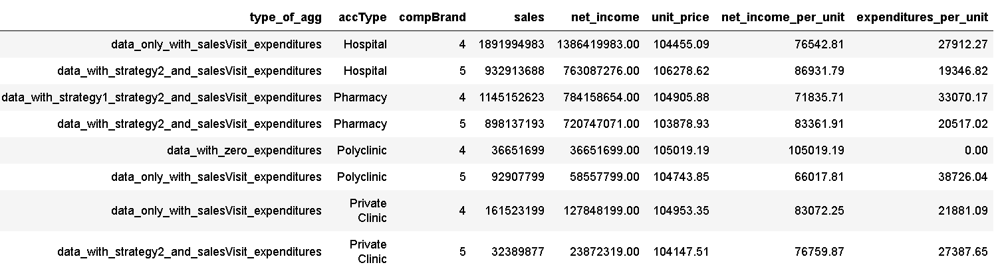

The worst strategy in each category: 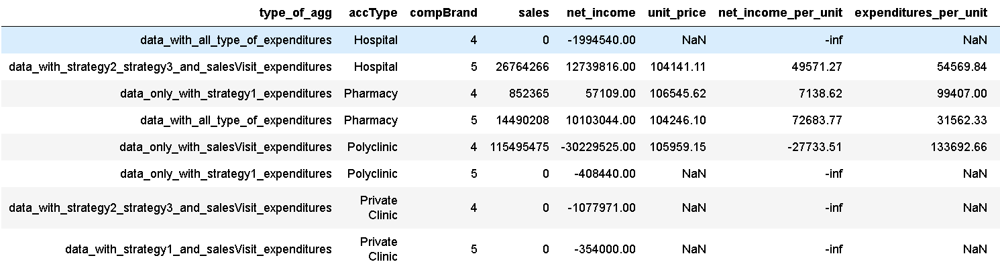

### Time Series Analysis for New Drug

Here we will be forecasting each accID independent of the new drug with the same expenditures that are spent in the presence of the new drug. This will help us in calculating the impact of new drug.

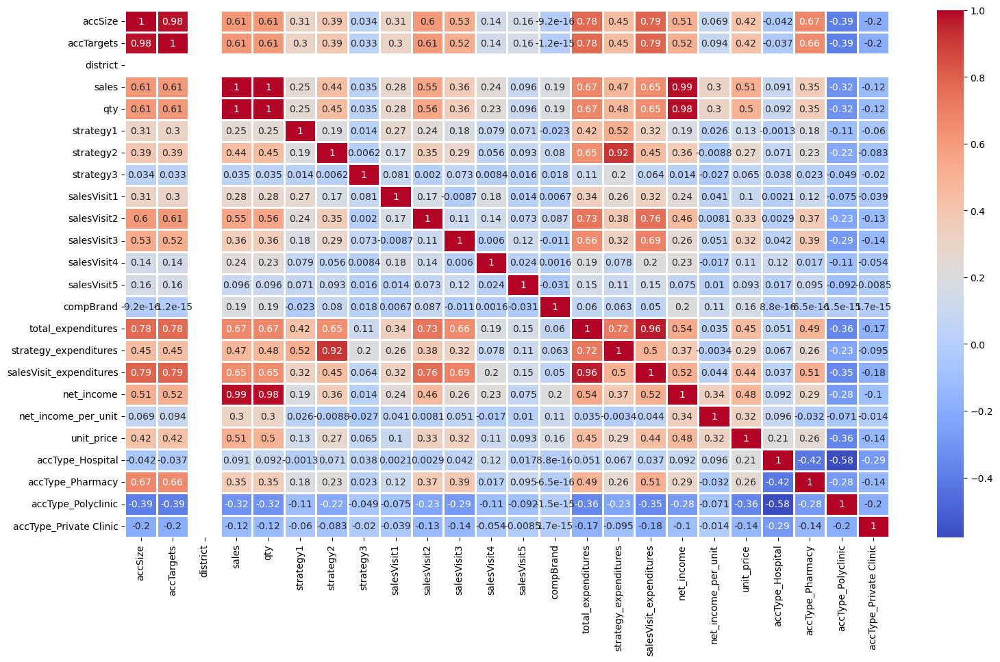

In [51]:
#data_for_corr = data.copy()
data_for_corr = pd.get_dummies(drug_df, columns=["accType"])
data_for_corr = data_for_corr.replace(np.nan, 0).replace(-np.inf, 0).replace(np.inf, 0)
plt.figure(figsize = (18,10))
ax = sns.heatmap(data_for_corr.corr(), annot = True, fmt='.2g',cmap= 'coolwarm',linewidths=1)

>accSize and accTargets are highly correlated

>net_income, qty and sales are highly correlated

>strategy_expendature is correlated with strategy2 thats mean in the current dataset more focus is given to strategy2

12:54:01 - cmdstanpy - INFO - Chain [1] start processing
12:54:01 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987002
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  7916353.39  5041177.64 10921476.37
17 2015-03-01  7232611.37  4399987.48  9903636.13
18 2015-04-01  7867678.84  5310614.43 10841414.42
19 2015-05-01 10494318.89  7711048.30 13375893.76
20 2015-06-01  8314022.05  5363377.39 11160660.77
21 2015-07-01  8411392.36  5544101.50 11328531.31
22 2015-08-01 10276800.17  7590280.75 13275180.80
23 2015-09-01 10938028.33  8543987.31 13818550.59


12:54:02 - cmdstanpy - INFO - Chain [1] start processing
12:54:02 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987005
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 20395625.68 17030466.52 23921637.97
17 2015-03-01 22978467.78 19379103.87 26558047.21
18 2015-04-01 29698881.73 26129207.49 32851799.97
19 2015-05-01 25926978.80 22731948.94 29284390.09
20 2015-06-01 31339664.92 27879231.29 34612031.11
21 2015-07-01 32071210.08 28436454.43 35690973.27
22 2015-08-01 36050685.63 32464111.42 39594569.81
23 2015-09-01 45409323.56 41726589.68 48899753.75


12:54:02 - cmdstanpy - INFO - Chain [1] start processing
12:54:02 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987006
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  8428017.96  6013211.72 10971507.92
17 2015-03-01  7969182.12  5551319.84 10404620.01
18 2015-04-01  8285135.92  5868085.76 10730541.38
19 2015-05-01  9550748.53  7096939.29 11948359.96
20 2015-06-01 10488553.31  7857271.25 12837858.96
21 2015-07-01  8076369.15  5641133.76 10552846.71
22 2015-08-01 11844241.74  9369985.55 14298002.66
23 2015-09-01 15596118.25 13081480.29 18077031.94


12:54:03 - cmdstanpy - INFO - Chain [1] start processing
12:54:03 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987007
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 32554605.08 27648890.85 37479924.61
17 2015-03-01 29833964.82 24734594.07 34975451.62
18 2015-04-01 45084743.07 40203307.75 49852454.29
19 2015-05-01 40634651.19 35766286.02 45689300.49
20 2015-06-01 34347995.10 29610800.38 39053947.23
21 2015-07-01 53689681.94 48570993.72 58732378.74
22 2015-08-01 45683043.43 40475182.71 50675221.89
23 2015-09-01 49152210.24 44317612.82 54219802.25


12:54:03 - cmdstanpy - INFO - Chain [1] start processing
12:54:04 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987008
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 21583385.48 18327807.59 24615410.89
17 2015-03-01 24524498.36 21262879.57 27632508.09
18 2015-04-01 27068943.25 23853354.72 30408329.31
19 2015-05-01 26535812.11 23543168.19 29816675.14
20 2015-06-01 33377151.63 30390446.30 36396809.04
21 2015-07-01 22051092.26 19190094.21 25561704.24
22 2015-08-01 40346946.12 37275604.66 43327189.53
23 2015-09-01 38535420.31 35406793.15 41820077.80


12:54:04 - cmdstanpy - INFO - Chain [1] start processing
12:54:04 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987009
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 4141367.97  3110432.50  5111854.43
17 2015-03-01 4343964.78  3396841.58  5399732.63
18 2015-04-01 4256450.21  3350888.20  5201507.11
19 2015-05-01 4909940.44  3981095.85  5860981.17
20 2015-06-01 4636581.02  3631772.85  5630132.64
21 2015-07-01 4759104.18  3785102.82  5694087.36
22 2015-08-01 5951939.31  4956983.77  6896869.05
23 2015-09-01 4608159.92  3649198.01  5518224.24


12:54:05 - cmdstanpy - INFO - Chain [1] start processing
12:54:05 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987010
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  8338207.31  4703426.98 12001793.74
17 2015-03-01  9319557.14  5903099.45 13029562.20
18 2015-04-01 11525535.40  8056052.47 14932519.05
19 2015-05-01 12017870.66  8535623.68 15552007.87
20 2015-06-01  9744862.22  6440267.01 13243585.06
21 2015-07-01 14764582.70 11031633.16 18115543.92
22 2015-08-01 12865237.25  9513808.38 16211136.80
23 2015-09-01 16492766.54 12767355.72 20025019.31


12:54:05 - cmdstanpy - INFO - Chain [1] start processing
12:54:05 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987014
           ds     yhat  yhat_lower  yhat_upper
16 2015-02-01 71673.43   -36752.77   178922.89
17 2015-03-01 73192.25   -30549.86   175176.10
18 2015-04-01 81703.55   -25980.80   199840.60
19 2015-05-01 57673.24   -56673.84   164608.07
20 2015-06-01 62943.30   -46473.04   170014.41
21 2015-07-01 78447.06   -33115.93   198054.65
22 2015-08-01 85797.86   -30384.52   192209.15
23 2015-09-01 86906.44   -21228.31   196657.26


12:54:06 - cmdstanpy - INFO - Chain [1] start processing
12:54:06 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987015
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 3612146.07   912264.36  6040911.02
17 2015-03-01 3455579.43   924135.76  5932096.09
18 2015-04-01 5735114.56  3270923.56  8189464.21
19 2015-05-01 2724648.11   191213.52  5453136.48
20 2015-06-01 1188174.44 -1348078.02  3643120.67
21 2015-07-01 2605543.91  -162584.25  5205612.54
22 2015-08-01 2437475.95  -152106.48  5022841.44
23 2015-09-01 3637813.72   965462.78  6319287.74


12:54:06 - cmdstanpy - INFO - Chain [1] start processing
12:54:06 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987016
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 164379.22  -255837.02   582732.98
17 2015-03-01 106053.72  -310739.01   522495.64
18 2015-04-01  92299.70  -338190.09   468979.88
19 2015-05-01   -141.21  -384356.39   403120.87
20 2015-06-01  65426.29  -372645.26   459463.81
21 2015-07-01  52142.47  -373136.61   477939.44
22 2015-08-01  38374.75  -337169.51   447880.10
23 2015-09-01  24579.62  -361352.84   418864.72


12:54:07 - cmdstanpy - INFO - Chain [1] start processing
12:54:07 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987017
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 19260533.14 16072701.07 22326504.45
17 2015-03-01 19759300.14 16642260.90 23204775.75
18 2015-04-01 20892775.19 17848463.77 24005475.72
19 2015-05-01 22464100.88 19241468.33 25778507.75
20 2015-06-01 23391080.37 20006632.40 26772047.79
21 2015-07-01 24282461.51 21083151.49 27466985.53
22 2015-08-01 25244754.92 21865859.89 28577534.47
23 2015-09-01 26242362.25 22874058.82 29323519.36


12:54:08 - cmdstanpy - INFO - Chain [1] start processing
12:54:08 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987019
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 4305549.33  1769860.73  6890748.41
17 2015-03-01 3082797.41   410241.64  5532515.19
18 2015-04-01 2984795.86   348073.68  5503173.95
19 2015-05-01 4739183.83  2300194.90  7238132.19
20 2015-06-01 5970303.45  3594298.07  8634364.63
21 2015-07-01 4760431.32  2246468.90  7242701.61
22 2015-08-01 5446308.98  2950504.93  8088015.25
23 2015-09-01 9999816.21  7640420.21 12592407.54


12:54:09 - cmdstanpy - INFO - Chain [1] start processing
12:54:09 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987021
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  5405004.29  3223727.62  7934737.00
17 2015-03-01  8123684.24  5703444.04 10584807.50
18 2015-04-01  7928828.37  5564916.61 10393061.80
19 2015-05-01  9986970.49  7634448.80 12450673.18
20 2015-06-01  9983098.13  7464824.97 12444153.59
21 2015-07-01  8304399.19  5727251.60 10647378.78
22 2015-08-01  9009769.53  6489853.74 11377153.49
23 2015-09-01 12265885.00  9995066.06 14775799.21


12:54:09 - cmdstanpy - INFO - Chain [1] start processing
12:54:09 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987022
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01   57917.61  -228888.50   340790.43
17 2015-03-01    3149.49  -290869.36   296118.23
18 2015-04-01   14301.20  -273928.23   314502.17
19 2015-05-01 -124231.06  -439283.92   170090.65
20 2015-06-01  224631.29   -56765.88   521564.17
21 2015-07-01 -427233.81  -729954.41  -138671.88
22 2015-08-01 -460092.96  -761977.88  -186446.92
23 2015-09-01 -327003.07  -606612.86   -34047.42


12:54:10 - cmdstanpy - INFO - Chain [1] start processing
12:54:10 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987023
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 2605818.67   860281.27  4260900.76
17 2015-03-01 4793079.58  3134189.79  6588286.31
18 2015-04-01 2377445.05   684016.37  4145156.08
19 2015-05-01 3358338.54  1614438.84  5179780.86
20 2015-06-01 2422535.76   763161.24  4183549.41
21 2015-07-01 3839224.74  2030158.20  5538049.55
22 2015-08-01 5164719.23  3532851.32  6973774.53
23 2015-09-01 4058834.38  2360426.08  5804718.65


12:54:11 - cmdstanpy - INFO - Chain [1] start processing
12:54:11 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987024
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 3221855.37  2156946.90  4158675.78
17 2015-03-01 5777426.67  4812171.63  6658038.25
18 2015-04-01 5616273.96  4560402.94  6591685.69
19 2015-05-01 3952741.85  2930541.39  4970250.18
20 2015-06-01 5373438.24  4410146.65  6359511.27
21 2015-07-01 5646719.60  4661152.42  6629176.24
22 2015-08-01 3822004.36  2776683.67  4714987.31
23 2015-09-01 6189116.67  5204208.30  7133848.01


12:54:11 - cmdstanpy - INFO - Chain [1] start processing
12:54:11 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987025
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 13056297.46 10514142.91 15636628.90
17 2015-03-01 15678788.60 13211474.73 18492817.58
18 2015-04-01 14063983.91 11448061.14 16453935.67
19 2015-05-01 15622103.80 13055083.03 18209980.51
20 2015-06-01 19140302.72 16391873.36 21647335.78
21 2015-07-01 15330690.51 12782549.04 17724767.52
22 2015-08-01 18032735.49 15264708.06 20715196.35
23 2015-09-01 18173455.29 15613850.60 20810918.10


12:54:12 - cmdstanpy - INFO - Chain [1] start processing
12:54:12 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987026
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 3015714.51  2407404.94  3593538.98
17 2015-03-01 2591362.06  2060873.17  3128821.89
18 2015-04-01 3402209.20  2858769.27  4000401.20
19 2015-05-01 3622851.62  3051496.50  4168504.42
20 2015-06-01 3899801.52  3358006.45  4499428.53
21 2015-07-01 3860126.30  3308039.78  4429791.81
22 2015-08-01 3906762.51  3368938.66  4409472.47
23 2015-09-01 4516405.05  3995552.64  5073276.99


12:54:12 - cmdstanpy - INFO - Chain [1] start processing
12:54:12 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987027
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 15256763.92 13245999.52 17055606.18
17 2015-03-01 13692806.84 11793307.88 15619881.62
18 2015-04-01 16237228.83 14328701.67 18120843.90
19 2015-05-01 17371311.40 15507417.11 19225757.07
20 2015-06-01 19619276.08 17784584.66 21491560.53
21 2015-07-01 15946093.06 14059603.92 17946509.41
22 2015-08-01 20746634.49 18903525.83 22676714.64
23 2015-09-01 22932509.65 21025703.57 24782996.79


12:54:13 - cmdstanpy - INFO - Chain [1] start processing
12:54:13 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987029
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 3251515.43  1533031.24  5173747.08
17 2015-03-01 3148192.73  1357836.41  4984045.23
18 2015-04-01 3608142.28  1735804.82  5296672.18
19 2015-05-01 3408439.72  1535145.56  5077952.71
20 2015-06-01 3892269.11  2122509.58  5665204.54
21 2015-07-01 4163320.48  2378396.98  5880912.69
22 2015-08-01 4351920.07  2518890.57  6024754.32
23 2015-09-01 3857513.53  2092393.71  5751806.22


12:54:14 - cmdstanpy - INFO - Chain [1] start processing
12:54:14 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\SHUBHAM HARDE\anaconda3\lib\site-packages\prophet\plot.py:68: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).




XYZ-987030
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01    74365.48   -76738.71   225887.38
17 2015-03-01  1549360.86  1399057.92  1691937.92
18 2015-04-01  3409448.61  3268357.76  3540213.76
19 2015-05-01   852366.94   698128.15  1002875.14
20 2015-06-01   -35031.85  -179968.50   109569.52
21 2015-07-01   815461.83   666917.78   960885.93
22 2015-08-01   -48104.85  -192094.45   100914.24
23 2015-09-01 -2099386.23 -2252009.33 -1950465.62


12:54:14 - cmdstanpy - INFO - Chain [1] start processing
12:54:14 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987032
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 278112.08    82861.83   470217.96
17 2015-03-01 281961.02    88897.43   474442.12
18 2015-04-01   -904.62  -209007.39   198577.16
19 2015-05-01 290346.22    94003.65   494633.71
20 2015-06-01 294607.55    83771.81   489795.93
21 2015-07-01 298731.41   110544.23   501861.36
22 2015-08-01 302992.74   108776.70   506102.83
23 2015-09-01 307254.07   114420.31   494876.40


12:54:15 - cmdstanpy - INFO - Chain [1] start processing
12:54:15 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987033
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01   10670.49 -1609169.94  1488765.11
17 2015-03-01   10379.81 -1587642.12  1560369.61
18 2015-04-01 4273575.00  2769243.83  5842437.27
19 2015-05-01   16278.43 -1460134.80  1620973.67
20 2015-06-01 2278584.08   621088.21  3770168.71
21 2015-07-01 2572026.04   968862.23  4118362.75
22 2015-08-01  316259.00 -1248376.74  1961687.34
23 2015-09-01 6348084.19  4782674.03  7783395.18


12:54:16 - cmdstanpy - INFO - Chain [1] start processing
12:54:16 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987034
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  -40009.57  -136341.12    54282.42
17 2015-03-01  -45107.30  -143327.94    51231.19
18 2015-04-01  294526.57   194166.13   390703.56
19 2015-05-01  -56213.08  -160574.72    37824.55
20 2015-06-01  -61857.00  -165136.64    31015.79
21 2015-07-01  -67318.86  -171106.05    39113.12
22 2015-08-01  -72962.78  -172293.10    25263.37
23 2015-09-01 -104139.95  -201513.38    -7664.52


12:54:16 - cmdstanpy - INFO - Chain [1] start processing
12:54:16 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987035
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 -10511.62  -609380.57   538931.75
17 2015-03-01 295208.06  -295104.85   840752.63
18 2015-04-01 247787.08  -366705.93   835023.67
19 2015-05-01 297202.92  -276287.91   868204.81
20 2015-06-01 301355.53  -296260.26   888309.57
21 2015-07-01 308462.38  -283723.91   891419.61
22 2015-08-01 264129.59  -293006.41   853486.59
23 2015-09-01 316767.59  -288984.19   914986.13


12:54:17 - cmdstanpy - INFO - Chain [1] start processing
12:54:17 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987036
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 1014233.67 -1369582.11  3379189.48
17 2015-03-01  796754.45 -1529714.94  3217851.35
18 2015-04-01   12314.77 -2133864.46  2464176.13
19 2015-05-01 -530955.03 -2785490.53  1833209.78
20 2015-06-01 1897944.98  -398730.03  4315238.49
21 2015-07-01 -214319.32 -2367736.85  2255707.92
22 2015-08-01 -288549.84 -2788724.16  2140831.95
23 2015-09-01  266233.34 -2057999.16  2725460.15


12:54:17 - cmdstanpy - INFO - Chain [1] start processing
12:54:18 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987037
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  751329.78  -448966.81  1951283.63
17 2015-03-01 3028759.20  1929226.60  4266468.29
18 2015-04-01 3566008.66  2358317.46  4822309.86
19 2015-05-01 1352093.39   207734.88  2513425.14
20 2015-06-01 1945397.87   814571.92  3123873.74
21 2015-07-01 1905983.13   764941.68  3111235.26
22 2015-08-01 5156555.16  3954196.53  6367906.49
23 2015-09-01 1570534.23   364250.84  2673379.77


12:54:18 - cmdstanpy - INFO - Chain [1] start processing
12:54:18 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987039
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  852467.25   664950.03  1027111.91
17 2015-03-01  860037.20   680991.21  1033866.75
18 2015-04-01 1264463.56  1104618.09  1447044.75
19 2015-05-01 1281434.80  1107914.68  1451035.02
20 2015-06-01  633363.25   451770.67   804571.50
21 2015-07-01 1279248.16  1106484.14  1456517.15
22 2015-08-01 1925097.23  1745250.99  2099849.73
23 2015-09-01  197907.46    35110.49   374409.79


12:54:19 - cmdstanpy - INFO - Chain [1] start processing
12:54:19 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987043
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 11022088.11  8940074.07 13378543.63
17 2015-03-01 11812904.91  9697744.19 14058328.74
18 2015-04-01 13020065.29 10682926.37 15122039.22
19 2015-05-01 12864143.44 10850858.00 15162987.49
20 2015-06-01 13232655.38 10996751.37 15312648.44
21 2015-07-01 12738567.63 10532814.11 14865872.95
22 2015-08-01 13321838.80 11071400.50 15526571.04
23 2015-09-01 13553001.47 11320676.26 15752741.30


12:54:19 - cmdstanpy - INFO - Chain [1] start processing
12:54:20 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987045
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 109589.90  -570119.89   759261.27
17 2015-03-01 506861.07  -111672.27  1091728.09
18 2015-04-01 426327.68  -213332.30  1078476.41
19 2015-05-01 489378.88  -153208.27  1132008.10
20 2015-06-01 677644.73    74414.26  1275290.91
21 2015-07-01 763381.80   124597.54  1406619.60
22 2015-08-01 823233.95   197241.36  1422341.52
23 2015-09-01 534011.38   -67576.72  1220488.03

XYZ-987047
           ds  yhat  yhat_lower  yhat_upper
16 2015-02-01  0.00       -0.00        0.00
17 2015-03-01  0.00       -0.00        0.00
18 2015-04-01  0.00       -0.00        0.00
19 2015-05-01  0.00       -0.00        0.00
20 2015-06-01  0.00       -0.00        0.00
21 2015-07-01  0.00       -0.00        0.00
22 2015-08-01  0.00       -0.00        0.00
23 2015-09-01  0.00       -0.00        0.00


12:54:20 - cmdstanpy - INFO - Chain [1] start processing
12:54:21 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987049
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 2043003.40  1108863.36  3012136.85
17 2015-03-01 2099997.18  1142708.92  3061324.93
18 2015-04-01 2319383.88  1301383.53  3328055.83
19 2015-05-01 2557197.39  1580748.14  3530454.95
20 2015-06-01 2337494.69  1336012.12  3392258.14
21 2015-07-01 2555302.74  1641286.48  3563036.33
22 2015-08-01 2451706.11  1397707.79  3542879.97
23 2015-09-01 2331810.32  1360104.96  3285061.87


12:54:21 - cmdstanpy - INFO - Chain [1] start processing
12:54:21 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987050
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 12539128.20  6221396.13 18531801.57
17 2015-03-01  9875520.53  4087984.69 15838746.14
18 2015-04-01 11296792.91  5159195.74 17570174.17
19 2015-05-01  9889755.58  3796398.48 15869177.51
20 2015-06-01 19223254.85 13226744.94 25492512.48
21 2015-07-01 16552465.34 10595355.69 22409281.06
22 2015-08-01 19415603.40 13113366.59 25578871.41
23 2015-09-01 10080083.53  3945194.22 16531310.08


12:54:22 - cmdstanpy - INFO - Chain [1] start processing
12:54:22 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987052
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 1236829.86   374259.06  2096187.90
17 2015-03-01  916314.59   -59234.18  1879702.41
18 2015-04-01 1156458.04   259118.78  2076200.84
19 2015-05-01 1446184.89   461842.15  2336496.61
20 2015-06-01 1910762.19  1009710.11  2788747.94
21 2015-07-01 1229252.15   338318.93  2147489.09
22 2015-08-01 1281050.37   370530.06  2174234.06
23 2015-09-01 1745627.67   884397.23  2572340.56


12:54:22 - cmdstanpy - INFO - Chain [1] start processing
12:54:22 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987054
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  5611105.85  4654751.29  6542129.13
17 2015-03-01  6552611.38  5542924.14  7505076.11
18 2015-04-01  7145383.05  6171052.50  8056778.86
19 2015-05-01  5843952.83  4891355.86  6822434.42
20 2015-06-01  8575811.66  7670448.25  9531351.19
21 2015-07-01  8565819.48  7694832.23  9486136.06
22 2015-08-01  9559110.68  8626192.53 10479993.19
23 2015-09-01 10081287.35  9097311.09 11016470.74


12:54:23 - cmdstanpy - INFO - Chain [1] start processing
12:54:23 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987056
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 146437.40   -51127.66   350366.72
17 2015-03-01  80657.75  -126619.59   280602.75
18 2015-04-01    314.19  -201673.95   210226.04
19 2015-05-01 230148.20    26550.79   444424.34
20 2015-06-01 244874.50    34795.39   451583.94
21 2015-07-01 259125.76    50896.29   469770.18
22 2015-08-01 336000.14   108691.98   535728.30
23 2015-09-01 288578.36    75146.10   520028.43


12:54:23 - cmdstanpy - INFO - Chain [1] start processing
12:54:24 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987059
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01      0.14        0.14        0.14
17 2015-03-01     -1.65       -1.65       -1.65
18 2015-04-01 852364.16   852364.16   852364.16
19 2015-05-01      0.14        0.14        0.14
20 2015-06-01      0.14        0.14        0.14
21 2015-07-01      0.14        0.14        0.14
22 2015-08-01      0.14        0.14        0.14
23 2015-09-01      0.14        0.14        0.14


12:54:25 - cmdstanpy - INFO - Chain [1] start processing
12:54:25 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987060
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 112171.29  -335692.26   605075.19
17 2015-03-01    -11.01  -443548.80   492354.58
18 2015-04-01 102587.43  -366393.16   555705.36
19 2015-05-01  47568.92  -388817.61   537964.30
20 2015-06-01  -7612.02  -503085.55   440386.11
21 2015-07-01  37660.18  -423062.02   559232.99
22 2015-08-01   7551.92  -436947.03   475247.60
23 2015-09-01   2516.33  -472804.06   463346.07


12:54:25 - cmdstanpy - INFO - Chain [1] start processing
12:54:25 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987061
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  209608.45   -81078.86   492539.94
17 2015-03-01  129089.53  -193146.06   424756.96
18 2015-04-01  -17253.97  -305960.97   283572.63
19 2015-05-01     -37.52  -300036.54   296097.54
20 2015-06-01 -181230.70  -478618.40   127466.75
21 2015-07-01  -70741.44  -380770.04   249130.06
22 2015-08-01   39160.05  -269133.95   346436.57
23 2015-09-01 -131756.95  -410578.50   168284.18


12:54:26 - cmdstanpy - INFO - Chain [1] start processing
12:54:26 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987062
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 1031049.06   118658.53  1944685.63
17 2015-03-01    1726.61  -835722.72   906404.83
18 2015-04-01  387704.83  -544457.07  1270341.51
19 2015-05-01  911685.45     5473.74  1794891.05
20 2015-06-01  305893.82  -611983.30  1218864.09
21 2015-07-01  265658.90  -694765.51  1104953.82
22 2015-08-01 1916729.44  1053937.06  2837757.42
23 2015-09-01 1875153.35   927036.38  2812288.64


12:54:26 - cmdstanpy - INFO - Chain [1] start processing
12:54:27 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987063
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 3205345.56  2377362.38  4103553.71
17 2015-03-01 1301846.04   412352.15  2188445.14
18 2015-04-01 2888097.57  1964844.96  3777060.83
19 2015-05-01 1546565.90   730567.44  2439293.32
20 2015-06-01 4462896.36  3628081.00  5373753.30
21 2015-07-01 2146081.28  1309470.71  3050727.43
22 2015-08-01 2270447.11  1370890.26  3142510.84
23 2015-09-01 3355369.96  2510323.43  4240687.64


12:54:27 - cmdstanpy - INFO - Chain [1] start processing
12:54:27 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987065
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 258257.50    47860.43   451576.35
17 2015-03-01  36256.58  -166889.06   238306.58
18 2015-04-01 213545.95    19568.57   415830.61
19 2015-05-01 247789.15    50669.53   449358.53
20 2015-06-01 193873.90    -8354.42   401312.43
21 2015-07-01 372974.44   172439.27   570240.34
22 2015-08-01 193820.37   -12107.52   403876.04
23 2015-09-01 168313.30   -15925.06   376304.24


12:54:27 - cmdstanpy - INFO - Chain [1] start processing
12:54:28 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987067
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 12348182.71  7605950.23 17537297.98
17 2015-03-01 14456093.69  9281165.43 19953832.92
18 2015-04-01 12652757.64  7485771.19 18272637.26
19 2015-05-01 10457669.69  5423549.21 15722783.37
20 2015-06-01 13830405.92  8744114.25 18844903.80
21 2015-07-01  8931281.20  3910698.92 14712412.98
22 2015-08-01 15393239.72 10075275.99 20616228.15
23 2015-09-01 16700425.18 11605811.46 22026199.46


12:54:28 - cmdstanpy - INFO - Chain [1] start processing
12:54:28 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987069
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01   584698.60  -274813.52  1396919.99
17 2015-03-01  1221345.02   275214.11  2115941.29
18 2015-04-01  4649883.84  3858446.62  5570443.92
19 2015-05-01  3949055.92  3071249.30  4792710.62
20 2015-06-01   854273.95   -45435.65  1761879.02
21 2015-07-01   594722.60  -268922.86  1434245.02
22 2015-08-01  -256147.06 -1120092.55   618495.87
23 2015-09-01 10042272.10  9150077.13 10889879.25


12:54:28 - cmdstanpy - INFO - Chain [1] start processing
12:54:29 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987070
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 156272.86   -51088.18   347580.10
17 2015-03-01 191103.77   -24102.68   392405.85
18 2015-04-01 193830.33   -21330.81   394483.18
19 2015-05-01 227334.13    27886.15   423673.06
20 2015-06-01 260080.57    49431.06   465931.46
21 2015-07-01 299965.63    99785.32   512616.93
22 2015-08-01 318377.79   115996.00   533830.62
23 2015-09-01 336789.94   120696.53   552492.00


12:54:29 - cmdstanpy - INFO - Chain [1] start processing
12:54:29 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987071
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 17631351.55 14650648.50 20653251.01
17 2015-03-01 14972010.95 11820911.11 18111816.16
18 2015-04-01 21486520.00 18600816.20 24535608.02
19 2015-05-01 12977138.05  9930615.88 15931898.47
20 2015-06-01 22460642.28 19646328.06 25721055.10
21 2015-07-01 22514208.40 19499258.60 25223254.21
22 2015-08-01 27737928.88 24534876.25 30731336.84
23 2015-09-01 25854884.27 22589965.07 28908034.88


12:54:30 - cmdstanpy - INFO - Chain [1] start processing
12:54:30 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987072
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 27690937.57 22418368.58 33162378.71
17 2015-03-01 28838583.12 23371603.26 34317238.28
18 2015-04-01 30919085.60 24875754.47 37052232.16
19 2015-05-01 32481971.97 27012940.14 38085147.93
20 2015-06-01 33035368.77 27226333.18 38243196.10
21 2015-07-01 33610360.62 27744986.67 38829011.24
22 2015-08-01 54716248.00 49017253.05 60270055.77
23 2015-09-01 49398025.95 43914800.79 54632781.31

XYZ-987075
           ds  yhat  yhat_lower  yhat_upper
16 2015-02-01  0.00       -0.00        0.00
17 2015-03-01  0.00       -0.00        0.00
18 2015-04-01  0.00       -0.00        0.00
19 2015-05-01  0.00       -0.00        0.00
20 2015-06-01  0.00       -0.00        0.00
21 2015-07-01  0.00       -0.00        0.00
22 2015-08-01  0.00       -0.00        0.00
23 2015-09-01  0.00       -0.00        0.00


12:54:31 - cmdstanpy - INFO - Chain [1] start processing
12:54:31 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987077
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 25474486.88 20198313.96 30850501.62
17 2015-03-01 33663947.11 27831916.23 38917412.94
18 2015-04-01 27608209.61 21782409.90 33517277.10
19 2015-05-01 23392089.28 17808637.06 28746516.91
20 2015-06-01 25667072.40 20125745.84 31501264.84
21 2015-07-01 30902741.57 25337372.93 36556975.53
22 2015-08-01 32928983.42 27370665.19 38815549.45
23 2015-09-01 35952225.47 30062138.07 41829354.22


12:54:32 - cmdstanpy - INFO - Chain [1] start processing
12:54:32 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987079
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01  56700.86  -337007.53   500323.78
17 2015-03-01   4541.32  -359934.29   430687.69
18 2015-04-01 360625.30   -46258.97   740077.81
19 2015-05-01  49023.27  -329457.67   447903.14
20 2015-06-01 290794.62   -94225.01   720100.99
21 2015-07-01 168020.93  -244094.91   586488.42
22 2015-08-01 953683.68   558334.02  1350556.10
23 2015-09-01 827488.46   436176.06  1204350.53


12:54:32 - cmdstanpy - INFO - Chain [1] start processing
12:54:32 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987081
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 180373.35    34250.87   341515.46
17 2015-03-01 486247.07   325637.31   648776.02
18 2015-04-01 360745.30   203980.31   520979.61
19 2015-05-01     -1.13  -162153.63   163669.64
20 2015-06-01 205886.89    40310.11   368048.62
21 2015-07-01 487568.35   336142.84   649906.55
22 2015-08-01 194635.85    50346.05   357948.63
23 2015-09-01 -98296.66  -261810.14    50842.41

XYZ-987082
           ds  yhat  yhat_lower  yhat_upper
16 2015-02-01  0.00       -0.00        0.00
17 2015-03-01  0.00       -0.00        0.00
18 2015-04-01  0.00       -0.00        0.00
19 2015-05-01  0.00       -0.00        0.00
20 2015-06-01  0.00       -0.00        0.00
21 2015-07-01  0.00       -0.00        0.00
22 2015-08-01  0.00       -0.00        0.00
23 2015-09-01  0.00       -0.00        0.00


12:54:33 - cmdstanpy - INFO - Chain [1] start processing
12:54:33 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987083
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 206585.69  -378941.45   710965.74
17 2015-03-01    221.00  -530356.17   527705.84
18 2015-04-01    250.79  -518262.12   578258.45
19 2015-05-01 281516.62  -219887.62   815084.37
20 2015-06-01 307616.16  -253199.05   810153.96
21 2015-07-01 247377.54  -252727.74   788592.59
22 2015-08-01 358973.31  -205086.95   906583.24
23 2015-09-01 271077.86  -281098.57   777892.45


12:54:34 - cmdstanpy - INFO - Chain [1] start processing
12:54:34 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987085
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 2427004.33  1592897.04  3205479.72
17 2015-03-01 3047546.72  2198351.39  3831887.69
18 2015-04-01 3464462.46  2660149.92  4243383.68
19 2015-05-01 3136326.70  2316775.91  3912653.69
20 2015-06-01 3052393.18  2279055.95  3851636.73
21 2015-07-01 3650662.98  2872430.15  4425481.01
22 2015-08-01 3606991.59  2855154.61  4365323.49
23 2015-09-01 4364891.76  3560139.07  5154913.44

XYZ-987086
           ds  yhat  yhat_lower  yhat_upper
16 2015-02-01  0.00       -0.00        0.00
17 2015-03-01  0.00       -0.00        0.00
18 2015-04-01  0.00       -0.00        0.00
19 2015-05-01  0.00       -0.00        0.00
20 2015-06-01  0.00       -0.00        0.00
21 2015-07-01  0.00       -0.00        0.00
22 2015-08-01  0.00       -0.00        0.00
23 2015-09-01  0.00       -0.00        0.00


12:54:34 - cmdstanpy - INFO - Chain [1] start processing
12:54:35 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987087
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01  40782.48  -170411.63   252237.93
17 2015-03-01  -9698.05  -237951.47   223185.50
18 2015-04-01   9519.76  -207002.72   226723.51
19 2015-05-01  58770.35  -161995.44   278844.16
20 2015-06-01  57224.09  -175992.38   273670.76
21 2015-07-01  55727.71  -156035.56   278670.55
22 2015-08-01   9327.19  -214925.99   222366.41
23 2015-09-01 -37073.33  -242248.83   180247.98


12:54:35 - cmdstanpy - INFO - Chain [1] start processing
12:54:35 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987088
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 14058679.95 11983264.78 16350640.09
17 2015-03-01 17177412.83 15167159.64 19490081.14
18 2015-04-01 16139776.55 13974320.11 18370959.02
19 2015-05-01 20347348.62 18209689.36 22358398.76
20 2015-06-01 20261761.83 18161695.90 22298480.34
21 2015-07-01 22408004.92 20351956.10 24535690.62
22 2015-08-01 22848319.13 20691748.58 24963944.60
23 2015-09-01 29509560.69 27133541.30 31524645.69


12:54:35 - cmdstanpy - INFO - Chain [1] start processing
12:54:36 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987089
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 220017.48   -64092.96   501731.12
17 2015-03-01 243171.42   -31705.44   530095.44
18 2015-04-01 264813.85   -20594.38   543641.56
19 2015-05-01 285758.14     1155.00   574408.59
20 2015-06-01 307400.58      450.49   610277.89
21 2015-07-01 328344.87    30011.20   629922.13
22 2015-08-01 344874.90    66448.20   601703.62
23 2015-09-01 381854.63    96786.43   664584.78


12:54:36 - cmdstanpy - INFO - Chain [1] start processing
12:54:36 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987090
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 13557035.12 11442259.52 15861726.16
17 2015-03-01 14592545.07 12524518.28 16803859.30
18 2015-04-01 15418831.33 13245165.95 17485979.18
19 2015-05-01 15639475.57 13466277.52 17682746.64
20 2015-06-01 17259131.06 15112945.08 19420102.78
21 2015-07-01 18104203.92 16036606.47 20257616.03
22 2015-08-01 19123545.01 17052374.54 21269677.38
23 2015-09-01 20032696.29 17897663.33 22054609.94


12:54:36 - cmdstanpy - INFO - Chain [1] start processing
12:54:37 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987091
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  952493.19   415601.16  1503421.57
17 2015-03-01 1035004.15   494349.07  1566401.81
18 2015-04-01 1095556.59   582686.77  1667790.96
19 2015-05-01 1154155.72   580857.17  1715146.94
20 2015-06-01 1360492.67   808631.88  1898758.61
21 2015-07-01 1273307.29   723217.05  1803606.04
22 2015-08-01 1306041.30   766534.87  1864735.88
23 2015-09-01 1626998.15  1060295.83  2191775.28


12:54:37 - cmdstanpy - INFO - Chain [1] start processing
12:54:37 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987092
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  6117069.92  3413765.78  8884534.11
17 2015-03-01  2072363.92  -913618.58  4744300.04
18 2015-04-01  7724059.71  4824420.49 10680836.68
19 2015-05-01  8563700.41  5752634.11 11432003.91
20 2015-06-01  6923006.35  4341996.09  9856751.35
21 2015-07-01  2425730.87  -370506.87  5331463.53
22 2015-08-01 -2988270.33 -5649751.22   -84728.71
23 2015-09-01  8505959.66  5779953.99 11332259.36


12:54:38 - cmdstanpy - INFO - Chain [1] start processing
12:54:38 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987093
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  896654.30   369768.34  1375203.99
17 2015-03-01  620505.99   105948.81  1135244.41
18 2015-04-01  647846.84   179174.55  1160131.17
19 2015-05-01  975149.00   486904.05  1438479.85
20 2015-06-01 1257510.52   789547.93  1752345.24
21 2015-07-01 1538990.07  1032987.99  2017698.55
22 2015-08-01  546248.25    28203.86  1027050.36
23 2015-09-01  573589.10    73126.24  1114876.73


12:54:38 - cmdstanpy - INFO - Chain [1] start processing
12:54:38 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987095
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 -59101.62  -370129.51   232265.13
17 2015-03-01 226324.15   -79834.38   532563.37
18 2015-04-01 118252.31  -174157.57   404268.25
19 2015-05-01 255343.17   -62708.56   558348.45
20 2015-06-01 270090.54   -38131.71   552581.96
21 2015-07-01 284362.19    -1482.36   614155.01
22 2015-08-01 299109.56      521.75   604626.49
23 2015-09-01 287389.79   -19357.22   606908.58


12:54:39 - cmdstanpy - INFO - Chain [1] start processing
12:54:40 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987096
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 3116187.94 -2114655.50  8219822.46
17 2015-03-01 3252522.78 -1656442.41  8311706.21
18 2015-04-01 2846962.44 -2567767.50  7895226.18
19 2015-05-01  852405.97 -4456267.62  5472544.63
20 2015-06-01 3172553.10 -1548260.61  8315895.20
21 2015-07-01 3553260.37 -1523078.83  8566588.09
22 2015-08-01 3293592.61 -2080557.23  8373190.46
23 2015-09-01 3033924.86 -1817863.65  8331488.20


12:54:40 - cmdstanpy - INFO - Chain [1] start processing
12:54:40 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987097
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  852604.13    19007.94  1697470.48
17 2015-03-01 3022046.37  2129589.23  3773674.35
18 2015-04-01 2846231.26  2075114.07  3706757.64
19 2015-05-01 2786030.12  1931856.11  3666132.97
20 2015-06-01 4095665.02  3229780.55  4973801.11
21 2015-07-01 3823792.73  3011913.06  4675188.40
22 2015-08-01 1496226.21   682887.70  2339601.29
23 2015-09-01 -974008.33 -1813146.93  -133852.04


12:54:41 - cmdstanpy - INFO - Chain [1] start processing
12:54:41 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987100
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  762790.77  -386902.27  1902113.00
17 2015-03-01 1686231.92   482918.57  2874519.17
18 2015-04-01 1428037.74   231513.50  2601476.87
19 2015-05-01  976058.59  -236166.03  2270001.34
20 2015-06-01  490805.86  -688297.94  1722473.32
21 2015-07-01 1394097.07   272152.89  2588015.54
22 2015-08-01 2417357.00  1241552.32  3578375.67
23 2015-09-01  593074.34  -579975.97  1760083.57


12:54:42 - cmdstanpy - INFO - Chain [1] start processing
12:54:42 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987102
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01  28297.93   -87041.46   140559.66
17 2015-03-01   3443.93  -114871.02   113546.19
18 2015-04-01 -12773.77  -120485.92    93632.93
19 2015-05-01 -10247.29  -119242.68   103638.68
20 2015-06-01  82007.37   -28275.92   187682.06
21 2015-07-01  53270.16   -52787.34   158901.91
22 2015-08-01 170026.15    52886.30   288773.82
23 2015-09-01 202291.24    89615.26   311904.99


12:54:42 - cmdstanpy - INFO - Chain [1] start processing
12:54:42 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987103
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 13264292.32 10724251.29 15714821.33
17 2015-03-01 12965794.93 10529942.16 15252959.35
18 2015-04-01 15330440.84 12998799.12 17654476.36
19 2015-05-01 14825611.43 12383067.17 17273031.35
20 2015-06-01 15710355.45 13357434.10 18098384.00
21 2015-07-01 15680447.88 13248247.97 18161534.46
22 2015-08-01 26893645.28 24414731.63 29425541.46
23 2015-09-01 32811477.85 30454961.89 35221716.47


12:54:43 - cmdstanpy - INFO - Chain [1] start processing
12:54:43 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987104
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 103912.20  -226046.46   427167.76
17 2015-03-01  95664.22  -242118.02   435247.83
18 2015-04-01 106322.75  -231125.09   425642.59
19 2015-05-01 134512.50  -203564.74   494688.76
20 2015-06-01 163046.08  -184527.61   497768.02
21 2015-07-01 133141.94  -215932.98   471148.79
22 2015-08-01 170613.04  -160736.87   523776.13
23 2015-09-01 194677.85  -139545.42   563215.28


12:54:44 - cmdstanpy - INFO - Chain [1] start processing
12:54:44 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987106
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  764719.94   439013.49  1052316.95
17 2015-03-01  820590.06   500848.66  1126599.89
18 2015-04-01  872081.30   542294.30  1187464.93
19 2015-05-01  942307.10   641059.62  1258410.99
20 2015-06-01 1024893.21   712370.73  1306527.85
21 2015-07-01 1064024.14   739635.14  1369175.76
22 2015-08-01 1125880.35   823615.71  1445099.90
23 2015-09-01 1208466.46   880526.87  1525256.30


12:54:45 - cmdstanpy - INFO - Chain [1] start processing
12:54:45 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987107
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 17775126.48 15579222.96 19926003.27
17 2015-03-01 19906613.54 17675981.87 22003149.09
18 2015-04-01 25683385.35 23602564.01 27715173.21
19 2015-05-01 20596863.28 18646861.19 22806761.37
20 2015-06-01 23036489.52 21030468.02 25169298.54
21 2015-07-01 24629156.73 22374796.00 26665882.46
22 2015-08-01 22563333.07 20481417.66 24644339.36
23 2015-09-01 26407910.60 24315095.11 28534268.51


12:54:45 - cmdstanpy - INFO - Chain [1] start processing
12:54:46 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987109
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 204408.23  -225298.92   674708.70
17 2015-03-01  51274.45  -380313.58   475016.29
18 2015-04-01 261341.39  -166301.94   709846.50
19 2015-05-01 290290.45  -162672.85   749062.12
20 2015-06-01 320204.49  -160982.86   766203.41
21 2015-07-01 349153.55   -98260.28   796032.78
22 2015-08-01 379067.58   -34292.28   808690.76
23 2015-09-01 589134.52   137370.16   998702.82


12:54:46 - cmdstanpy - INFO - Chain [1] start processing
12:54:46 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987111
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  5440399.73  4487063.94  6416902.20
17 2015-03-01  8231922.81  7271356.59  9232327.23
18 2015-04-01  6882825.60  5901854.92  7758596.84
19 2015-05-01 10351766.53  9380403.87 11320472.20
20 2015-06-01 11411310.61 10460562.65 12407080.93
21 2015-07-01 11452194.53 10467557.76 12459417.25
22 2015-08-01 11052493.97 10120365.66 12015725.77
23 2015-09-01 12182075.28 11178654.93 13195639.96

XYZ-987112
           ds  yhat  yhat_lower  yhat_upper
16 2015-02-01  0.00       -0.00        0.00
17 2015-03-01  0.00       -0.00        0.00
18 2015-04-01  0.00       -0.00        0.00
19 2015-05-01  0.00       -0.00        0.00
20 2015-06-01  0.00       -0.00        0.00
21 2015-07-01  0.00       -0.00        0.00
22 2015-08-01  0.00       -0.00        0.00
23 2015-09-01  0.00       -0.00        0.00

XYZ-987113
           ds  yhat  yhat_lower  yhat_upper
16 2015-02-01  0.00       -0.00        0.00
17 2015-03-01  0.00       -0.0

12:54:49 - cmdstanpy - INFO - Chain [1] start processing
12:54:49 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987120
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 5223439.40   619178.92 10213505.50
17 2015-03-01 5401810.11   413760.16 10642330.63
18 2015-04-01 5767686.56  1039043.25 10758736.22
19 2015-05-01 4090726.58  -612170.72  8903740.26
20 2015-06-01 4253805.23  -559886.61  9318278.59
21 2015-07-01 7298006.00  2632744.23 12362939.10
22 2015-08-01 7663882.45  3194614.67 12256024.22
23 2015-09-01 8029758.89  3316570.44 12859038.02

XYZ-987121
           ds  yhat  yhat_lower  yhat_upper
16 2015-02-01  0.00       -0.00        0.00
17 2015-03-01  0.00       -0.00        0.00
18 2015-04-01  0.00       -0.00        0.00
19 2015-05-01  0.00       -0.00        0.00
20 2015-06-01  0.00       -0.00        0.00
21 2015-07-01  0.00       -0.00        0.00
22 2015-08-01  0.00       -0.00        0.00
23 2015-09-01  0.00       -0.00        0.00

XYZ-987124
           ds  yhat  yhat_lower  yhat_upper
16 2015-02-01  0.00       -0.00        0.00
17 2015-03-01  0.00       -0.00        

12:54:50 - cmdstanpy - INFO - Chain [1] start processing
12:54:50 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987127
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 -52666.25  -386067.36   305134.16
17 2015-03-01 192156.56  -126673.54   501962.60
18 2015-04-01 409570.40    66596.57   739908.40
19 2015-05-01 181361.01  -132793.16   529069.27
20 2015-06-01 -88244.71  -425976.20   245191.07
21 2015-07-01 110304.42  -182493.43   442483.31
22 2015-08-01 -27696.26  -353740.40   303170.46
23 2015-09-01 -88004.78  -442820.74   252549.72


12:54:50 - cmdstanpy - INFO - Chain [1] start processing
12:54:51 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987130
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  7671956.86  6030940.46  9294506.14
17 2015-03-01 11949667.89 10387232.84 13603676.32
18 2015-04-01 14810106.48 13222736.14 16503602.99
19 2015-05-01  7838268.22  6282663.88  9498370.70
20 2015-06-01 16330145.82 14746028.36 18032415.90
21 2015-07-01 17001747.90 15358064.42 18694926.06
22 2015-08-01 15463466.54 13833856.41 17042050.28
23 2015-09-01 15679969.99 14023748.23 17422895.75


12:54:51 - cmdstanpy - INFO - Chain [1] start processing
12:54:51 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987133
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 1413713.30   880128.91  1881122.76
17 2015-03-01 1512923.77  1012446.56  2022125.19
18 2015-04-01 1992250.34  1490050.83  2485121.44
19 2015-05-01 1763942.67  1283007.53  2243829.60
20 2015-06-01 1882167.14  1386577.12  2373256.19
21 2015-07-01 1933696.26  1402450.58  2419956.11
22 2015-08-01 1713066.97  1213142.61  2199721.97
23 2015-09-01 2185745.12  1693782.23  2684842.36


12:54:52 - cmdstanpy - INFO - Chain [1] start processing
12:54:52 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987134
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 18842101.10 14216343.12 23193738.43
17 2015-03-01 17897264.84 13248448.93 22586160.75
18 2015-04-01 20290185.00 15418192.52 24840176.59
19 2015-05-01 22712073.78 17793552.79 27528817.43
20 2015-06-01 22668130.13 18185121.20 27302853.66
21 2015-07-01 22484917.70 17787015.09 27583338.81
22 2015-08-01 26288675.93 21450250.42 30992754.37
23 2015-09-01 30184982.56 24920192.08 34965839.62


12:54:52 - cmdstanpy - INFO - Chain [1] start processing
12:54:52 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987135
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 11677268.77  9244733.92 14024988.46
17 2015-03-01 11186592.05  8957478.22 13539357.23
18 2015-04-01 10159952.41  7832261.57 12658732.24
19 2015-05-01 13379384.44 11007849.39 15749396.11
20 2015-06-01 12729901.60 10388814.51 15238488.79
21 2015-07-01 11861611.13  9473727.27 14159001.53
22 2015-08-01 14591788.33 12290395.89 16946977.43
23 2015-09-01 12039352.77  9665275.41 14405281.05


12:54:53 - cmdstanpy - INFO - Chain [1] start processing
12:54:53 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987136
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 18845902.42 13667592.59 24108430.36
17 2015-03-01 20744054.91 15756768.45 25896716.04
18 2015-04-01 23401208.12 18362428.60 28257526.33
19 2015-05-01 22972102.40 17904204.75 28181353.96
20 2015-06-01 27924980.82 22777444.10 33060877.99
21 2015-07-01 29293021.85 24250260.09 34193726.11
22 2015-08-01 28254640.36 23385473.09 33337572.75
23 2015-09-01 29064183.95 24191447.84 34450997.71


12:54:53 - cmdstanpy - INFO - Chain [1] start processing
12:54:53 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987137
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 1819670.94   829290.11  2683595.70
17 2015-03-01 2273864.13  1411942.74  3221824.49
18 2015-04-01 1864010.22   913576.27  2746418.59
19 2015-05-01 2321150.86  1405256.78  3286866.70
20 2015-06-01 2931981.63  1982445.74  3816610.18
21 2015-07-01 2703661.29  1743209.21  3629591.35
22 2015-08-01 2309131.29  1453865.79  3211280.17
23 2015-09-01 3099118.37  2105764.44  4046928.49


12:54:54 - cmdstanpy - INFO - Chain [1] start processing
12:54:54 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987138
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 27157949.40 22945145.33 31408718.19
17 2015-03-01 26111730.10 21979626.63 30378063.76
18 2015-04-01 35372747.60 31026291.41 39687326.03
19 2015-05-01 29806511.43 25537144.73 33932316.74
20 2015-06-01 29227272.01 24893526.49 33229815.13
21 2015-07-01 29683056.54 25395440.36 34086885.93
22 2015-08-01 41119899.30 36729562.54 44900501.67
23 2015-09-01 39101657.72 34798107.25 43062911.23


12:54:54 - cmdstanpy - INFO - Chain [1] start processing
12:54:54 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987139
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 2556975.39  1248081.66  3954848.37
17 2015-03-01 3546158.08  2285879.61  4956188.41
18 2015-04-01 3899276.73  2493317.99  5198485.79
19 2015-05-01 4198162.36  2878500.71  5663271.95
20 2015-06-01 4598713.33  3293819.17  5937817.69
21 2015-07-01 4375843.54  2989964.94  5715495.58
22 2015-08-01 4491800.51  3030265.29  5904539.52
23 2015-09-01 4750054.55  3263628.32  6113697.63


12:54:55 - cmdstanpy - INFO - Chain [1] start processing
12:54:55 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987141
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  6868422.65  4870870.29  8930270.69
17 2015-03-01  8490151.75  6316437.93 10570489.67
18 2015-04-01  9641461.19  7653192.30 11657644.33
19 2015-05-01  9464096.29  7276540.19 11588164.58
20 2015-06-01  9648499.43  7503193.97 11700239.47
21 2015-07-01 11405235.08  9419985.47 13486592.24
22 2015-08-01 10869043.10  9012046.84 12846828.73
23 2015-09-01 13228163.58 11031422.73 15135669.11


12:54:55 - cmdstanpy - INFO - Chain [1] start processing
12:54:56 - cmdstanpy - INFO - Chain [1] done processing


12:54:56 - cmdstanpy - INFO - Chain [1] start processing


XYZ-987143
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 200063.34    84829.05   305524.51
17 2015-03-01 350716.58   239870.68   454953.88
18 2015-04-01 255569.35   152357.78   362146.78
19 2015-05-01 215810.12   110378.38   316869.33
20 2015-06-01 280260.72   171407.82   383211.00
21 2015-07-01 259953.83   161274.85   361197.68
22 2015-08-01 271068.79   166770.70   379818.60
23 2015-09-01 261413.51   161931.88   357893.83


12:54:56 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987144
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  911241.45   -78570.35  1833288.62
17 2015-03-01 1209003.71   208241.14  2016150.00
18 2015-04-01 1519205.91   619370.17  2456572.41
19 2015-05-01 1052693.87   101501.57  2023238.67
20 2015-06-01 1101963.81   179722.68  2070091.42
21 2015-07-01 1626441.07   759519.59  2588050.38
22 2015-08-01 1246792.33   279716.42  2144010.14
23 2015-09-01 1462643.62   534153.68  2428594.36


12:54:57 - cmdstanpy - INFO - Chain [1] start processing
12:54:57 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987145
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  317749.22    91125.92   521745.02
17 2015-03-01  840500.33   610822.24  1062021.59
18 2015-04-01    -681.11  -217687.24   208874.72
19 2015-05-01  214425.57     6382.49   445341.43
20 2015-06-01  223261.91    12259.81   449383.36
21 2015-07-01  -84242.73  -326378.06   122022.35
22 2015-08-01 1270189.32  1048943.14  1481304.10
23 2015-09-01  378178.33   144403.67   592815.44


12:54:57 - cmdstanpy - INFO - Chain [1] start processing
12:54:57 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987146
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  8676380.65  6985008.48 10214379.61
17 2015-03-01 13808022.85 12077941.82 15508572.92
18 2015-04-01 10362808.22  8680517.86 12045817.58
19 2015-05-01 11327853.31  9525407.45 12913917.78
20 2015-06-01 14829794.16 13133776.39 16472929.51
21 2015-07-01 16144740.66 14506093.66 17655263.07
22 2015-08-01 10578786.65  8973333.46 12269012.30
23 2015-09-01 11984079.38 10251059.12 13713924.34


12:54:58 - cmdstanpy - INFO - Chain [1] start processing
12:54:58 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987147
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  5570488.36  4141257.02  6901803.11
17 2015-03-01  5987591.14  4630005.98  7302167.68
18 2015-04-01  7599411.76  6259749.35  9015173.50
19 2015-05-01  6921349.14  5513150.82  8268338.11
20 2015-06-01 16095187.23 14726069.42 17420354.63
21 2015-07-01  7977895.70  6712898.64  9358516.09
22 2015-08-01 13661799.85 12357923.94 14995862.47
23 2015-09-01 18398021.97 17102049.75 19722754.84


12:54:58 - cmdstanpy - INFO - Chain [1] start processing
12:54:59 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987148
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 304504.60  -101473.02   723536.57
17 2015-03-01 224696.30  -184678.84   639587.15
18 2015-04-01 357700.82     1912.07   772636.19
19 2015-05-01 504487.67    75948.59   920950.58
20 2015-06-01 532438.15   111101.42   945942.22
21 2015-07-01 461775.13    51394.70   866091.39
22 2015-08-01 489725.72    71927.63   873102.10
23 2015-09-01 495650.30    76586.13   888653.14


12:54:59 - cmdstanpy - INFO - Chain [1] start processing
12:54:59 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987149
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01     20.52  -346045.21   313441.76
17 2015-03-01 504835.11   203712.74   841740.80
18 2015-04-01 487153.25   179829.91   811944.94
19 2015-05-01 592236.18   268579.66   906024.55
20 2015-06-01 533380.12   205027.32   855823.47
21 2015-07-01 597288.84   281001.22   937566.74
22 2015-08-01 620781.18   291872.17   930716.56
23 2015-09-01 438402.52   117398.17   752445.51


12:55:00 - cmdstanpy - INFO - Chain [1] start processing
12:55:00 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987150
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 1752195.04   900302.98  2549124.26
17 2015-03-01 2557105.59  1779089.85  3342548.49
18 2015-04-01 2141861.20  1360156.21  2933933.19
19 2015-05-01 2411513.11  1559927.70  3240005.47
20 2015-06-01 2510333.72  1680106.78  3297647.68
21 2015-07-01 2324533.76  1523384.22  3142076.75
22 2015-08-01 2761532.96  1986864.62  3580401.69
23 2015-09-01 3094900.94  2287729.12  3929641.33


12:55:00 - cmdstanpy - INFO - Chain [1] start processing
12:55:01 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987151
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  270554.10 -1238802.15  1767469.31
17 2015-03-01 1307809.34  -260476.26  2777330.37
18 2015-04-01  776359.20  -659730.66  2386265.27
19 2015-05-01 -388057.80 -1891087.96  1093282.25
20 2015-06-01 1095682.52  -368644.19  2592064.09
21 2015-07-01  -55479.09 -1614327.40  1485132.22
22 2015-08-01  725833.83  -745800.66  2263932.23
23 2015-09-01 -679882.24 -2181951.83   802015.54


12:55:01 - cmdstanpy - INFO - Chain [1] start processing
12:55:01 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987153
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 208158.88  -251146.98   665570.94
17 2015-03-01 220039.95  -236571.01   675701.50
18 2015-04-01 282265.86  -152326.80   699650.09
19 2015-05-01 196851.87  -270012.47   627966.99
20 2015-06-01 259077.77  -159396.74   719870.00
21 2015-07-01 222740.18  -222824.18   683304.36
22 2015-08-01 284961.55  -159259.40   713267.55
23 2015-09-01 273581.94  -207449.50   691481.64


12:55:02 - cmdstanpy - INFO - Chain [1] start processing
12:55:02 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987156
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 30384043.99 26840240.39 33745867.56
17 2015-03-01 31202653.84 27363367.56 34937808.92
18 2015-04-01 35120484.22 31518453.62 38615718.58
19 2015-05-01 32901267.20 29301881.34 36530376.02
20 2015-06-01 38350878.69 34819379.28 41703666.72
21 2015-07-01 41322429.96 37706742.43 45017681.49
22 2015-08-01 40668619.61 36910456.44 44117853.07
23 2015-09-01 44613216.84 41262044.62 48282982.59


12:55:03 - cmdstanpy - INFO - Chain [1] start processing
12:55:03 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987157
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 1178884.31   616542.50  1733178.45
17 2015-03-01 1015973.48   471311.33  1527927.49
18 2015-04-01 1275326.64   739219.72  1789897.34
19 2015-05-01 1534024.51   990435.02  2050407.35
20 2015-06-01 1647266.13  1120504.54  2181576.39
21 2015-07-01 1641940.33  1107852.62  2146630.41
22 2015-08-01 1824149.59  1298150.83  2340980.57
23 2015-09-01 1740246.92  1182007.61  2230979.05


12:55:03 - cmdstanpy - INFO - Chain [1] start processing
12:55:04 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987160
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 12350900.78  9612591.60 15335407.43
17 2015-03-01 12134448.15  9253469.42 14922165.11
18 2015-04-01 13611101.46 10885368.78 16416330.82
19 2015-05-01 15383480.86 12623130.31 18091114.53
20 2015-06-01 16793522.93 14229810.15 19859817.79
21 2015-07-01 16977263.52 14356791.89 19810321.29
22 2015-08-01 18254082.83 15746365.80 21023874.03
23 2015-09-01 19930570.14 17170190.39 22899254.69


12:55:04 - cmdstanpy - INFO - Chain [1] start processing
12:55:04 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987161
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  2559375.73  2012336.91  3105931.12
17 2015-03-01  2704795.64  2140984.77  3248530.36
18 2015-04-01  4187978.48  3617991.32  4750301.62
19 2015-05-01  7672127.93  7098006.09  8257347.58
20 2015-06-01  3927809.25  3364964.42  4500903.13
21 2015-07-01  2330112.75  1753323.48  2903565.18
22 2015-08-01   437831.92  -156802.66  1012684.56
23 2015-09-01 -3985393.70 -4527030.23 -3377428.61


12:55:05 - cmdstanpy - INFO - Chain [1] start processing
12:55:05 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987163
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 2270968.31  1319441.95  3314545.56
17 2015-03-01 2211881.32  1223251.18  3254216.50
18 2015-04-01 2773410.18  1776255.18  3761085.81
19 2015-05-01 2881641.71  1926595.90  3836784.05
20 2015-06-01 3087190.48  2120360.58  4063680.45
21 2015-07-01 2407543.50  1425467.11  3452104.63
22 2015-08-01 2986366.71  2071507.30  4021959.36
23 2015-09-01 3438762.14  2425925.18  4417377.16


12:55:05 - cmdstanpy - INFO - Chain [1] start processing
12:55:05 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987164
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 26945243.40 23052001.95 30650071.13
17 2015-03-01 27849309.29 24321491.59 31685356.58
18 2015-04-01 29700502.13 26009535.50 33517711.07
19 2015-05-01 33921937.61 30154648.13 37551751.07
20 2015-06-01 33195028.88 29300078.59 36882344.83
21 2015-07-01 37821051.50 34011532.82 41525251.24
22 2015-08-01 43626036.18 39676621.62 47408874.27
23 2015-09-01 44631875.65 40839294.34 48240042.70


12:55:06 - cmdstanpy - INFO - Chain [1] start processing
12:55:06 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987165
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  7772751.80  5835567.61  9675880.70
17 2015-03-01  7777904.94  5961772.34  9785864.44
18 2015-04-01  8548914.87  6713613.61 10492938.88
19 2015-05-01  4687390.47  2823568.75  6594037.05
20 2015-06-01  9843457.21  8050600.40 11812026.92
21 2015-07-01  9995462.69  8202681.83 11950609.97
22 2015-08-01  9511917.68  7647488.80 11498155.35
23 2015-09-01 11105957.24  9156813.31 13064476.53


12:55:06 - cmdstanpy - INFO - Chain [1] start processing
12:55:07 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987166
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 11214556.98  7238506.03 15181052.24
17 2015-03-01 13032479.55  8927610.36 17251617.76
18 2015-04-01 11109441.24  7096423.24 15171492.79
19 2015-05-01 12666861.71  8467313.76 16487942.66
20 2015-06-01 13192329.41  9069096.85 17189210.02
21 2015-07-01 14123067.27 10206668.46 18058484.43
22 2015-08-01 14648535.01 10642044.67 18871249.43
23 2015-09-01 14446844.77 10507582.08 18528852.76


12:55:07 - cmdstanpy - INFO - Chain [1] start processing
12:55:07 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987168
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 33939094.41 28111163.30 39740661.59
17 2015-03-01 30093995.48 24534140.37 35592189.60
18 2015-04-01 34293090.10 28621754.37 39652871.79
19 2015-05-01 34473105.15 29147851.52 40100339.79
20 2015-06-01 40897084.31 35056406.85 46105630.25
21 2015-07-01 40821874.63 35124745.28 46544845.31
22 2015-08-01 42862695.66 37182504.41 48638838.97
23 2015-09-01 40091955.01 34463199.24 45185786.58

XYZ-987170
           ds  yhat  yhat_lower  yhat_upper
16 2015-02-01  0.00       -0.00        0.00
17 2015-03-01  0.00       -0.00        0.00
18 2015-04-01  0.00       -0.00        0.00
19 2015-05-01  0.00       -0.00        0.00
20 2015-06-01  0.00       -0.00        0.00
21 2015-07-01  0.00       -0.00        0.00
22 2015-08-01  0.00       -0.00        0.00
23 2015-09-01  0.00       -0.00        0.00


12:55:08 - cmdstanpy - INFO - Chain [1] start processing
12:55:08 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987172
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 29730959.74 24226451.76 35266478.83
17 2015-03-01 37219400.78 31897588.79 42365314.12
18 2015-04-01 44080734.67 38752013.63 49903694.01
19 2015-05-01 40048093.72 34942224.83 45302409.36
20 2015-06-01 50912349.93 45754758.11 56308622.35
21 2015-07-01 51040669.20 45570298.61 56186345.84
22 2015-08-01 51586676.79 46326344.19 56711802.84
23 2015-09-01 57215356.06 51932520.81 62352624.71


12:55:09 - cmdstanpy - INFO - Chain [1] start processing
12:55:09 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987173
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  9034069.60  6542157.54 11708892.07
17 2015-03-01  9449062.56  6963480.15 11744099.89
18 2015-04-01 11241669.56  8674319.34 13720828.23
19 2015-05-01 10688866.22  8103641.92 13141809.56
20 2015-06-01 12457885.39  9956367.66 14895361.81
21 2015-07-01 14238063.82 11737884.34 16547870.75
22 2015-08-01 14216591.69 11593419.60 16767334.31
23 2015-09-01 12968541.33 10555712.62 15709865.25


12:55:09 - cmdstanpy - INFO - Chain [1] start processing
12:55:09 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987174
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 7254294.77  5137593.86  9285055.11
17 2015-03-01 7671540.56  5411963.94  9864956.45
18 2015-04-01 7330414.45  5180024.34  9587467.45
19 2015-05-01 9549129.10  7359476.98 11575099.43
20 2015-06-01 6459110.26  4356533.74  8686661.00
21 2015-07-01 9945989.57  7939424.68 12167180.45
22 2015-08-01 8882509.09  6720457.34 10954750.86
23 2015-09-01 7835660.05  5809441.34 10005690.27


12:55:10 - cmdstanpy - INFO - Chain [1] start processing
12:55:10 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987175
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01  -94569.60  -465501.71   283892.47
17 2015-03-01    -132.00  -364344.42   409997.50
18 2015-04-01     175.80  -375552.66   364387.81
19 2015-05-01   16222.34  -385097.74   369699.00
20 2015-06-01  726920.63   379731.86  1095744.28
21 2015-07-01 1160814.11   777967.73  1510504.49
22 2015-08-01  527296.73   123963.47   883660.53
23 2015-09-01  830252.44   481317.21  1194201.25


12:55:10 - cmdstanpy - INFO - Chain [1] start processing
12:55:10 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987177
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 2191749.79  1358353.10  3016926.32
17 2015-03-01 1780543.40   904692.69  2570156.29
18 2015-04-01 1827199.33   976880.76  2571269.81
19 2015-05-01 1892203.34  1086712.81  2662361.35
20 2015-06-01 2869910.67  2037639.61  3679256.82
21 2015-07-01 2768311.08  1912625.87  3622447.74
22 2015-08-01 3540622.02  2771149.96  4393751.64
23 2015-09-01 2895398.55  2121945.65  3726636.81


12:55:11 - cmdstanpy - INFO - Chain [1] start processing
12:55:11 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987179
           ds       yhat  yhat_lower  yhat_upper
16 2015-02-01 1128120.48   232639.04  2032574.15
17 2015-03-01 1296601.42   405137.33  2183434.25
18 2015-04-01 1553739.53   677520.42  2504716.62
19 2015-05-01 1770680.20   822534.73  2648349.39
20 2015-06-01 1916312.45  1042402.84  2778780.15
21 2015-07-01 1966187.35  1090489.32  2850979.74
22 2015-08-01 2070018.50  1221389.66  2968753.31
23 2015-09-01 2551271.74  1754726.42  3455931.03


12:55:11 - cmdstanpy - INFO - Chain [1] start processing
12:55:11 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987180
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 224616.77  -402022.28   829580.32
17 2015-03-01 -31304.19  -651095.47   526578.25
18 2015-04-01 213600.22  -395117.62   793551.48
19 2015-05-01 276604.82  -312138.60   858939.43
20 2015-06-01 422400.84  -199914.13  1029787.70
21 2015-07-01 200290.70  -375470.43   809930.33
22 2015-08-01 500854.51  -119204.22  1109193.51
23 2015-09-01 844867.29   210767.27  1415689.89


12:55:12 - cmdstanpy - INFO - Chain [1] start processing
12:55:12 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987181
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 -83025.78  -317862.70   150903.66
17 2015-03-01 -48166.47  -277783.66   195179.08
18 2015-04-01 -42415.07  -269447.82   173662.36
19 2015-05-01  -8651.98  -245917.13   218921.07
20 2015-06-01  74248.38  -168660.57   291109.82
21 2015-07-01   2665.29  -226756.14   216648.72
22 2015-08-01   8416.68  -219242.44   237002.66
23 2015-09-01  14168.08  -217920.13   266225.72


12:55:12 - cmdstanpy - INFO - Chain [1] start processing
12:55:13 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987183
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01  68019.74  -430179.63   523417.02
17 2015-03-01 371751.25   -97195.21   809976.98
18 2015-04-01 373192.41  -147667.13   859648.06
19 2015-05-01 355399.33  -100322.85   799219.03
20 2015-06-01 311183.51  -163810.85   783357.03
21 2015-07-01 320110.74  -155217.01   785407.72
22 2015-08-01 382776.20   -92264.27   843971.54
23 2015-09-01 285119.73  -207508.10   723994.11


12:55:13 - cmdstanpy - INFO - Chain [1] start processing
12:55:13 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987185
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01  7799954.47  6536245.96  9087376.46
17 2015-03-01  7464346.93  6122815.45  8794470.81
18 2015-04-01  7626595.78  6228810.05  9072109.10
19 2015-05-01 10267220.27  8933003.31 11551405.67
20 2015-06-01 10419387.69  9037174.11 11803982.54
21 2015-07-01  9791057.49  8475159.95 11078636.11
22 2015-08-01 12232374.95 10789785.92 13560431.64
23 2015-09-01 13182730.03 11840445.07 14589228.06


12:55:14 - cmdstanpy - INFO - Chain [1] start processing
12:55:14 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987186
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 12483062.21 10313476.21 14676842.69
17 2015-03-01 16756240.13 14525270.95 18912997.48
18 2015-04-01 17858711.46 15804216.60 19946699.68
19 2015-05-01 14663788.30 12422486.67 16889590.06
20 2015-06-01 14776158.22 12702679.75 16893947.68
21 2015-07-01 17790875.47 15630013.77 19975666.49
22 2015-08-01 17055211.24 14788613.47 19350587.97
23 2015-09-01 15657753.23 13475891.04 17822512.06

XYZ-987187
           ds  yhat  yhat_lower  yhat_upper
16 2015-02-01  0.00       -0.00        0.00
17 2015-03-01  0.00       -0.00        0.00
18 2015-04-01  0.00       -0.00        0.00
19 2015-05-01  0.00       -0.00        0.00
20 2015-06-01  0.00       -0.00        0.00
21 2015-07-01  0.00       -0.00        0.00
22 2015-08-01  0.00       -0.00        0.00
23 2015-09-01  0.00       -0.00        0.00


12:55:15 - cmdstanpy - INFO - Chain [1] start processing
12:55:15 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987189
           ds        yhat  yhat_lower  yhat_upper
16 2015-02-01 22666368.67 15823612.94 29697769.43
17 2015-03-01 22645712.23 15435531.52 29985689.37
18 2015-04-01 25569943.38 18349185.13 32645539.54
19 2015-05-01 18014977.39 10969587.45 25083480.72
20 2015-06-01 17350972.03 10579574.70 24399815.30
21 2015-07-01 25085212.85 18409780.94 32251121.01
22 2015-08-01 18815280.37 11126445.46 26096150.02
23 2015-09-01 25413272.88 18514559.71 31805612.53


12:55:15 - cmdstanpy - INFO - Chain [1] start processing
12:55:15 - cmdstanpy - INFO - Chain [1] done processing



XYZ-987190
           ds      yhat  yhat_lower  yhat_upper
16 2015-02-01 115614.07  -186681.82   414982.41
17 2015-03-01  59748.86  -241309.26   371349.19
18 2015-04-01  34722.06  -255048.31   319323.15
19 2015-05-01 146651.88  -159509.05   438731.97
20 2015-06-01 140073.68  -159058.64   467913.88
21 2015-07-01  33860.47  -277220.95   337334.17
22 2015-08-01 127129.49  -173633.04   409048.58
23 2015-09-01 120551.29  -190415.09   402516.63


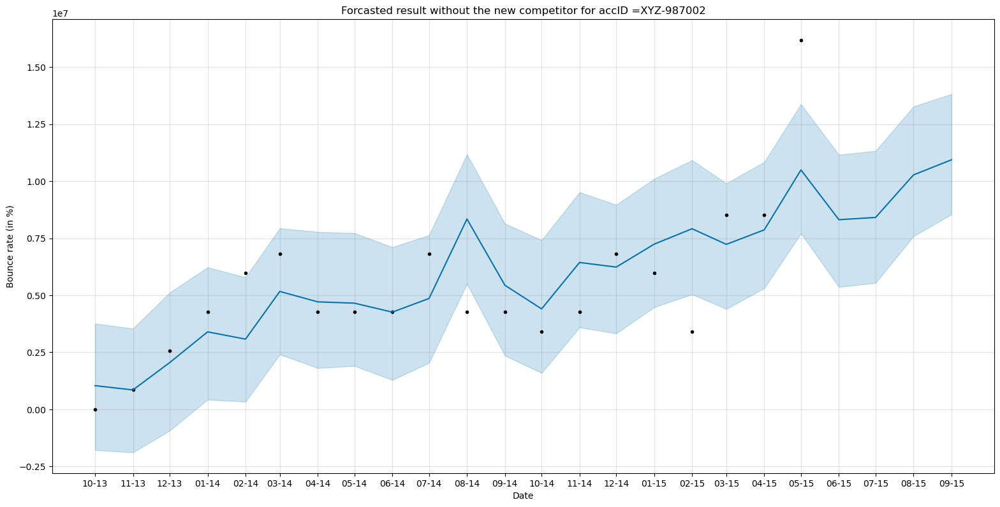

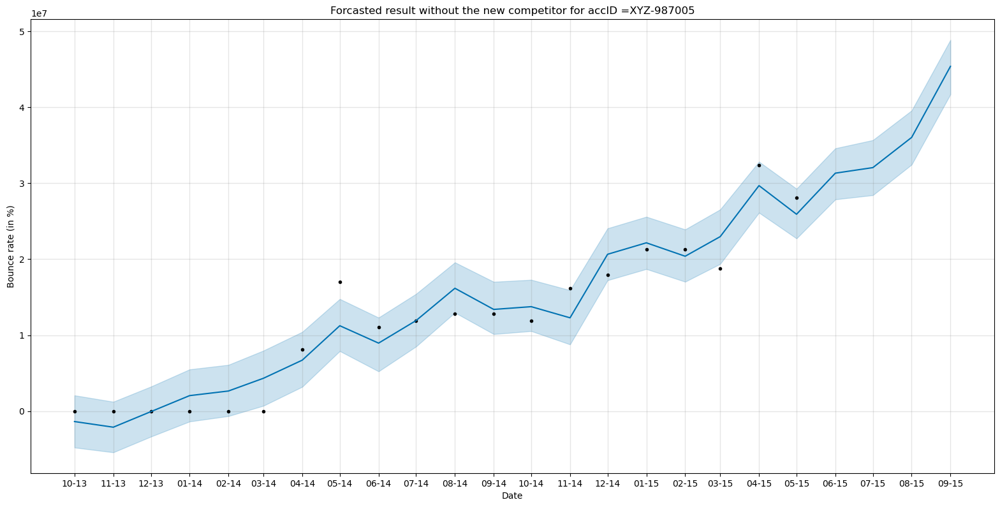

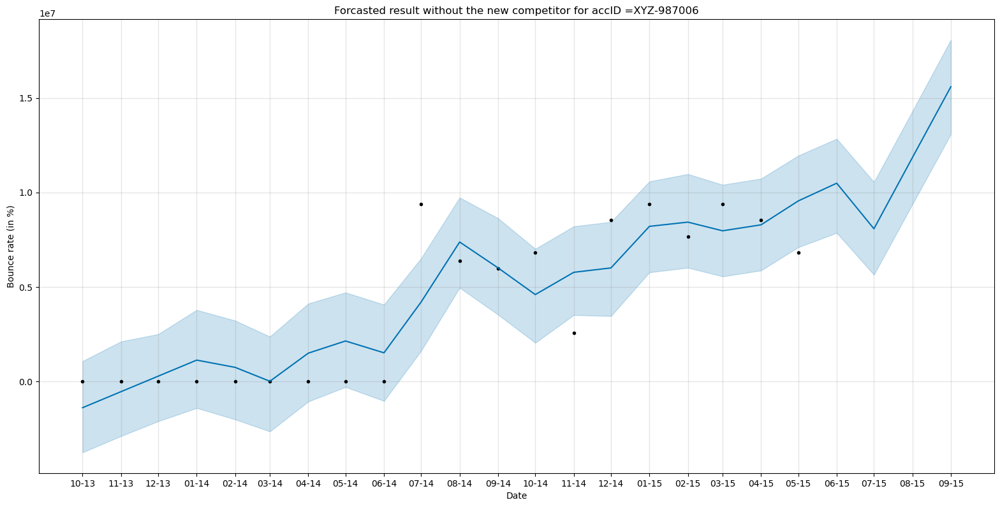

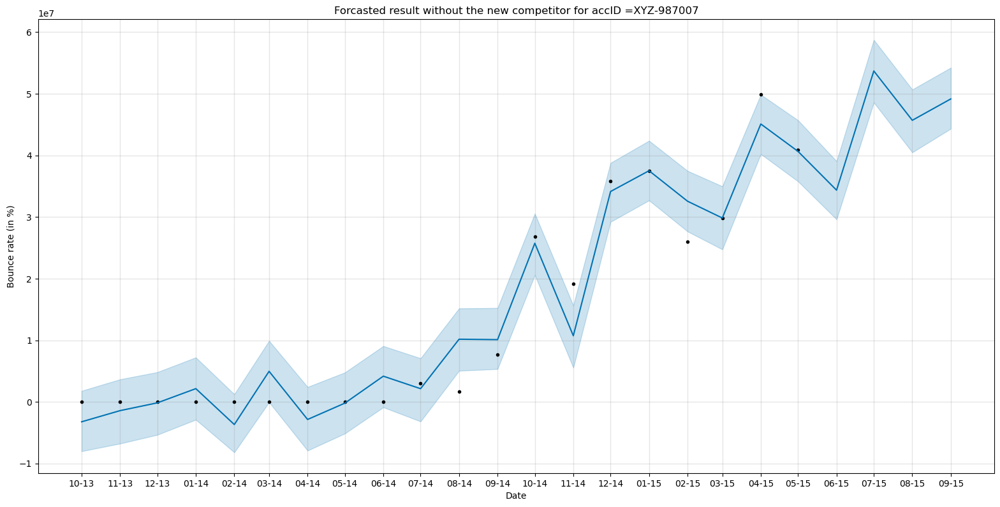

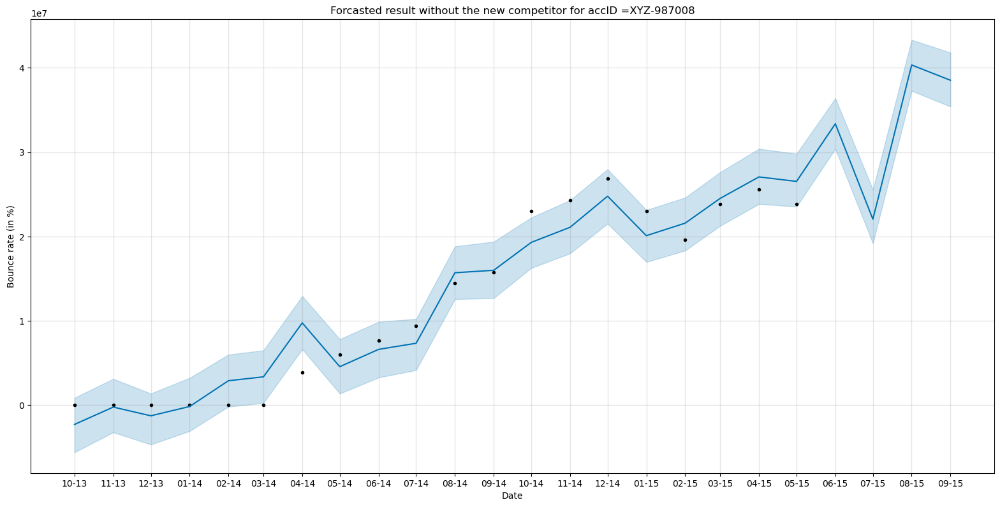

...

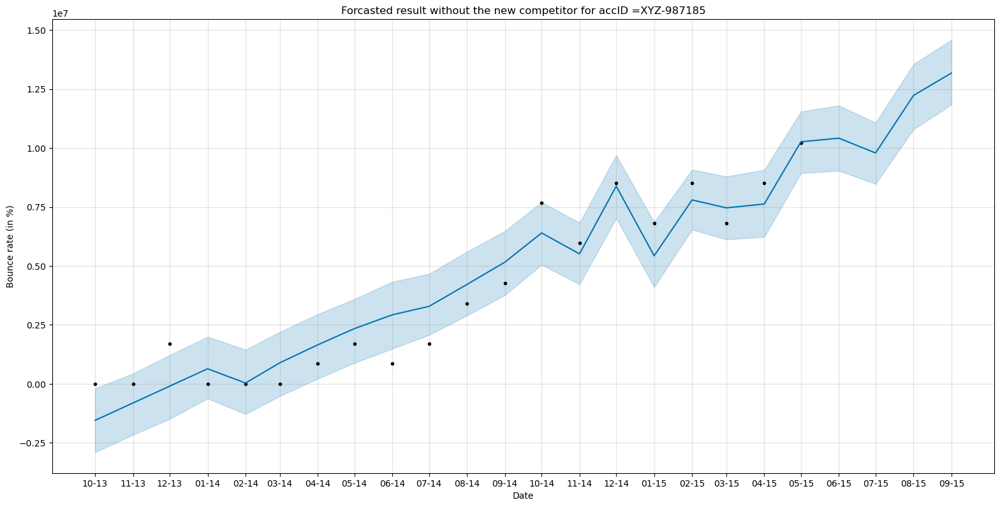

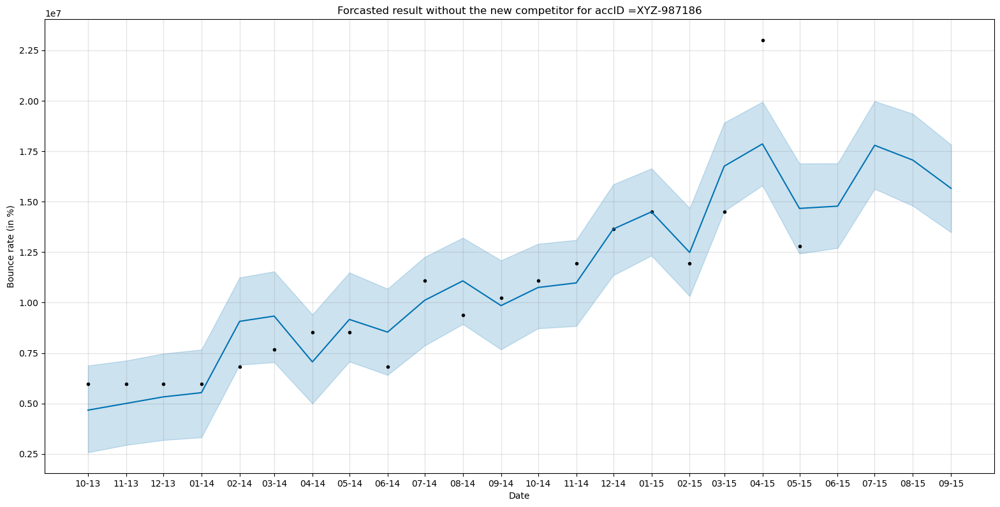

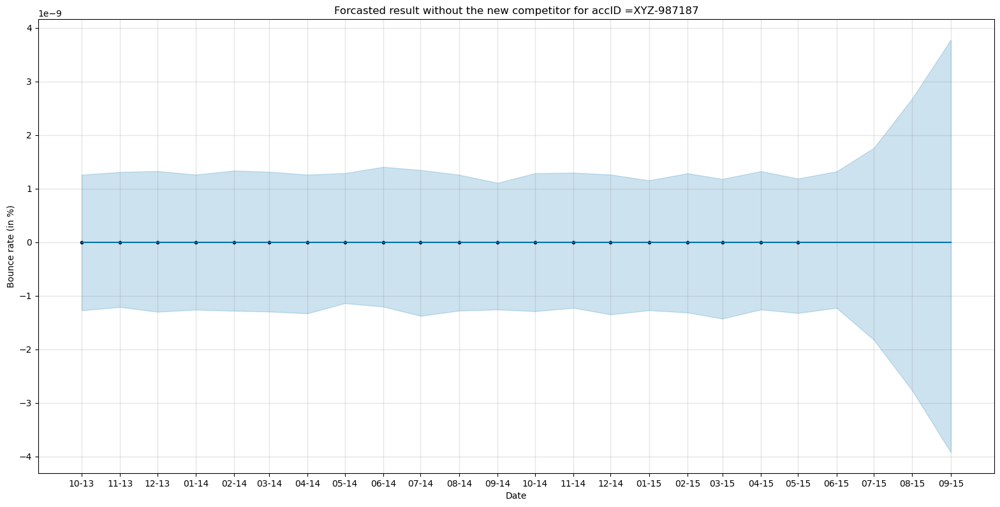

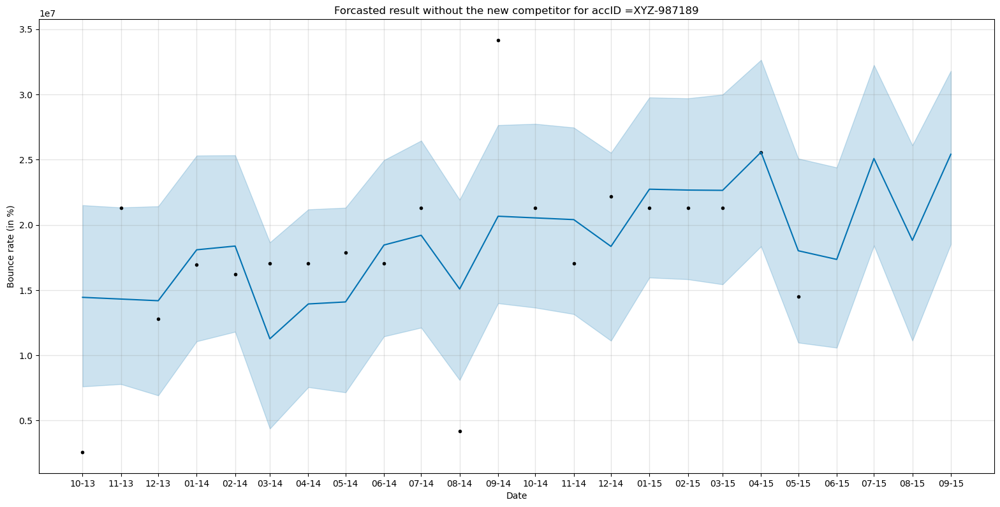

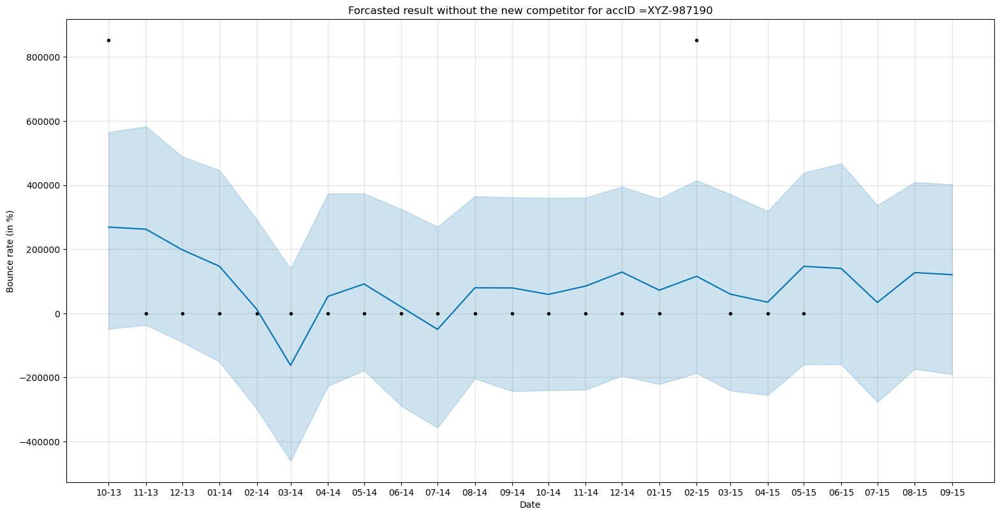

In [52]:
full_time_series_data = pd.DataFrame(columns=['ds', 'trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper',
                                              'additive_terms', 'additive_terms_lower', 'additive_terms_upper',
                                              'extra_regressors_additive', 'extra_regressors_additive_lower',
                                              'extra_regressors_additive_upper', 'salesVisit1', 'salesVisit1_lower',
                                              'salesVisit1_upper', 'salesVisit2', 'salesVisit2_lower',
                                              'salesVisit2_upper', 'salesVisit3', 'salesVisit3_lower',
                                              'salesVisit3_upper', 'salesVisit4', 'salesVisit4_lower',
                                              'salesVisit4_upper', 'salesVisit5', 'salesVisit5_lower',
                                              'salesVisit5_upper', 'strategy1', 'strategy1_lower', 'strategy1_upper',
                                              'strategy2', 'strategy2_lower', 'strategy2_upper', 'strategy3',
                                              'strategy3_lower', 'strategy3_upper', 'multiplicative_terms',
                                              'multiplicative_terms_lower', 'multiplicative_terms_upper', 'yhat', 'accID'])

for i in drug_df['accID'].unique():
    data_time_series_all = drug_df[(drug_df['accID'] == i)]
    data_time_series_all = data_time_series_all.sort_values(by=['month'])
    data_time_series_all = data_time_series_all.reset_index()
    data_time_series = data_time_series_all[(data_time_series_all['compBrand'] == 4)]
    data_time_series = data_time_series[['month', 'sales', 'strategy1', 'strategy2', 'strategy3',
                                         'salesVisit1', 'salesVisit2', 'salesVisit3', 'salesVisit4', 'salesVisit5']]
    data_time_series.columns = ['ds', 'y', 'strategy1', 'strategy2', 'strategy3',
                                'salesVisit1', 'salesVisit2', 'salesVisit3', 'salesVisit4', 'salesVisit5']

    m = Prophet()
    m.add_regressor('strategy1')
    m.add_regressor('strategy2')
    m.add_regressor('strategy3')
    m.add_regressor('salesVisit1')
    m.add_regressor('salesVisit2')
    m.add_regressor('salesVisit3')
    m.add_regressor('salesVisit4')
    m.add_regressor('salesVisit5')

    m.fit(data_time_series)
    future = m.make_future_dataframe(periods=4, freq='MS')
    future['strategy1'] = data_time_series_all['strategy1']
    future['strategy2'] = data_time_series_all['strategy2']
    future['strategy3'] = data_time_series_all['strategy3']
    future['salesVisit1'] = data_time_series_all['salesVisit1']
    future['salesVisit2'] = data_time_series_all['salesVisit2']
    future['salesVisit3'] = data_time_series_all['salesVisit3']
    future['salesVisit4'] = data_time_series_all['salesVisit4']
    future['salesVisit5'] = data_time_series_all['salesVisit5']

    fcst = m.predict(future)
    print()
    fig = m.plot(fcst, xlabel='Date', ylabel='Bounce rate (in %)', figsize=(16, 8))
    fcst['accID'] = i
    ax = fig.gca()
    ax.set_title("Forcasted result without the new competitor for accID =" + i, size=12)
    ax.set_xticks(future['ds'])
    ax.set_xticklabels((future['ds'].dt.strftime('%m-%y').tolist()))
    full_time_series_data = pd.concat([full_time_series_data, fcst], ignore_index=True)
    print(i)
    print(fcst[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(8))

In [53]:
data_with_5_compBrand = drug_df[drug_df['compBrand'] == 5]
display(data_with_5_compBrand.head(2))

,accID,accType,accSize,accTargets,district,month,sales,qty,strategy1,strategy2,...,salesVisit4,salesVisit5,compBrand,total_expenditures,strategy_expenditures,salesVisit_expenditures,net_income,net_income_per_unit,unit_price,quarter
21,XYZ-987002,Pharmacy,700,25,3,2015-06-01,11933113,115,0.00,115380.00,...,0.00,0.00,5,2440380.00,115380.00,2325000.00,9492733.00,82545.50,103766.20,2015Q2
22,XYZ-987002,Pharmacy,700,25,3,2015-07-01,12785478,123,0.00,416114.00,...,0.00,0.00,5,3341114.00,416114.00,2925000.00,9444364.00,76783.45,103946.98,2015Q3


In [54]:
time_series_data_when_compBrand_5 = full_time_series_data[full_time_series_data['ds'] >= '2015-06-01']
time_series_data_when_compBrand_5 = time_series_data_when_compBrand_5[['accID', 'ds', 'yhat', 'yhat_lower', 'yhat_upper']]
time_series_data_when_compBrand_5.columns = ['accID', 'month', 'forcasted_sales', 'forcasted_sales_lower', 'forcasted_sales_upper']
display(time_series_data_when_compBrand_5.head(2))

,accID,month,forcasted_sales,forcasted_sales_lower,forcasted_sales_upper
20,XYZ-987002,2015-06-01,8314022.05,5363377.39,11160660.77
21,XYZ-987002,2015-07-01,8411392.36,5544101.50,11328531.31


In [55]:
combined_data_when_5_compBrand =  pd.merge(data_with_5_compBrand, time_series_data_when_compBrand_5, how="left", 
                                            on=["accID", 'month'],)

In [56]:
combined_data_when_5_compBrand['qty_abs'] = combined_data_when_5_compBrand['qty'].abs()
combined_data_when_5_compBrand['sales_dff'] = combined_data_when_5_compBrand['forcasted_sales'] - combined_data_when_5_compBrand['sales']
combined_data_when_5_compBrand['precent_sales_dff'] = ((combined_data_when_5_compBrand['sales_dff']/combined_data_when_5_compBrand['sales'])*100).replace(-np.inf, 0).replace(np.inf, 0)

In [57]:
fig = px.scatter(combined_data_when_5_compBrand, x="sales", y="forcasted_sales", color="accType",
                 size='qty_abs', hover_data=["net_income","sales", "forcasted_sales", "sales_dff", "precent_sales_dff", "qty",
                                              'strategy1', 'strategy2', 'strategy3', 'accType'])
fig.update_layout(title = "sales(in the presence of new dug) vs forcasted prices(in the absence of new dug) for accType", title_font_color="red", yaxis=dict(tickformat="20,.2f"))
fig.write_html("sales vs forcasted prices for accType.html")
fig.show()

In [58]:
combined_data_when_5_compBranda_agg = combined_data_when_5_compBrand.groupby('accType').agg({'sales':'sum', 'forcasted_sales': 'sum', 
        'strategy1':'sum', 'strategy2':'sum', 'strategy3':'sum', 'salesVisit_expenditures':'sum','total_expenditures':'sum' }).reset_index()
combined_data_when_5_compBranda_agg['precent_sales_dff'] = ((combined_data_when_5_compBranda_agg['forcasted_sales'] - combined_data_when_5_compBranda_agg['sales'])/(combined_data_when_5_compBranda_agg['sales']))*100
combined_data_when_5_compBranda_agg['percentage_strategy1'] = (combined_data_when_5_compBranda_agg['strategy1']/combined_data_when_5_compBranda_agg['total_expenditures'])*100
combined_data_when_5_compBranda_agg['percentage_strategy2'] = (combined_data_when_5_compBranda_agg['strategy2']/combined_data_when_5_compBranda_agg['total_expenditures'])*100
combined_data_when_5_compBranda_agg['percentage_strategy3'] = (combined_data_when_5_compBranda_agg['strategy3']/combined_data_when_5_compBranda_agg['total_expenditures'])*100
combined_data_when_5_compBranda_agg['percentage_salesVisit'] = (combined_data_when_5_compBranda_agg['salesVisit_expenditures']/combined_data_when_5_compBranda_agg['total_expenditures'])*100
display(combined_data_when_5_compBranda_agg[["accType","sales","forcasted_sales","precent_sales_dff","percentage_strategy1","percentage_strategy2","percentage_strategy3","percentage_salesVisit"]])

,accType,sales,forcasted_sales,precent_sales_dff,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,Hospital,1889906690,2166787371.84,14.65,1.30,18.51,1.25,78.94
1,Pharmacy,1581904543,1738509123.66,9.90,2.57,16.30,0.32,80.82
2,Polyclinic,153851906,98577950.57,-35.93,1.12,9.37,0.00,89.50
3,Private Clinic,63075021,91801836.35,45.54,0.30,20.43,1.44,77.83


Note: we are using the same expenditures in the presence and absence of a new drug for time series forecasting

>In Hospital, we might see an overall 14.65% drop in presence of new drug

>In Pharmacy, we might see an overall 9.90% drop in presence of new drug

>In Polyclinic, we might see the overall 35.93% up in presence of the new drug. Cause we are not spending much on strategy2 as strategy2 is the best strategy2 in the absence of a new drug for Polyclinic

>In Private Clinics, we might see an overall 45.54% drop in presence of the new drug. this is too high cause here we have a 1/4 ratio in strategy2 and sales visit

### Analysing the performance of best strategies quarterly for each category

In [60]:
over_all_data_comparison_top3 = pd.DataFrame(columns = over_all_data_comparison.columns)
for i in over_all_data_comparison['accType'].unique():
  temp_over_all_data_comparison_top3 = over_all_data_comparison[(over_all_data_comparison['accType'] == i) & (over_all_data_comparison['compBrand'] == 4)]
  temp_over_all_data_comparison_top3 = temp_over_all_data_comparison_top3.nlargest(3, 'net_income')
  over_all_data_comparison_top3 = pd.concat([over_all_data_comparison_top3, temp_over_all_data_comparison_top3], ignore_index = True)
  temp_over_all_data_comparison_top3 = over_all_data_comparison[(over_all_data_comparison['accType'] == i) & (over_all_data_comparison['compBrand'] == 5)]
  temp_over_all_data_comparison_top3 = temp_over_all_data_comparison_top3.nlargest(3, 'net_income')
  over_all_data_comparison_top3 = pd.concat([over_all_data_comparison_top3, temp_over_all_data_comparison_top3], ignore_index = True)
display(over_all_data_comparison_top3.head(50))

,type_of_agg,accType,compBrand,qty,sales,net_income,strategy1,strategy2,strategy3,total_expenditures,strategy_expenditures,salesVisit_expenditures,unit_price,net_income_per_unit,expenditures_per_unit,percentage_profit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,data_only_with_salesVisit_expenditures,Hospital,4,18113,1891994983,1386419983.00,0.00,0.00,0.00,505575000.00,0.00,505575000.00,104455.09,76542.81,27912.27,274.23,0.00,0.00,0.00,100.00
1,data_with_strategy2_and_salesVisit_expenditures,Hospital,4,15963,1667439384,1140275808.00,0.00,154488576.00,0.00,527163576.00,154488576.00,372675000.00,104456.52,71432.43,33024.09,216.30,0.00,29.31,0.00,70.69
2,data_with_strategy1_and_salesVisit_expenditures,Hospital,4,5279,559279413,426113148.00,25016265.00,0.00,0.00,133166265.00,25016265.00,108150000.00,105944.20,80718.54,25225.66,319.99,18.79,0.00,0.00,81.21
3,data_with_strategy2_and_salesVisit_expenditures,Hospital,5,8778,932913688,763087276.00,0.00,51701412.00,0.00,169826412.00,51701412.00,118125000.00,106278.62,86931.79,19346.82,449.33,0.00,30.44,0.00,69.56
4,data_only_with_salesVisit_expenditures,Hospital,5,6581,686878479,584578479.00,0.00,0.00,0.00,102300000.00,0.00,102300000.00,104372.96,88828.21,15544.75,571.44,0.00,0.00,0.00,100.00
5,data_with_strategy1_and_salesVisit_expenditures,Hospital,5,906,90776892,76592434.00,2259458.00,0.00,0.00,14184458.00,2259458.00,11925000.00,100195.25,84539.11,15656.13,539.97,15.93,0.00,0.00,84.07
6,data_with_strategy1_strategy2_and_salesVisit_expenditures,Pharmacy,4,10916,1145152623,784158654.00,32509642.00,58409327.00,0.00,360993969.00,90918969.00,270075000.00,104905.88,71835.71,33070.17,217.22,9.01,16.18,0.00,74.81
7,data_with_strategy2_and_salesVisit_expenditures,Pharmacy,4,10798,1132409760,730664895.00,0.00,75194865.00,0.00,401744865.00,75194865.00,326550000.00,104872.18,67666.69,37205.49,181.87,0.00,18.72,0.00,81.28
8,data_only_with_salesVisit_expenditures,Pharmacy,4,7882,850404740,617604740.00,0.00,0.00,0.00,232800000.00,0.00,232800000.00,107892.00,78356.35,29535.65,265.29,0.00,0.00,0.00,100.00
9,data_with_strategy2_and_salesVisit_expenditures,Pharmacy,5,8646,898137193,720747071.00,0.00,33990122.00,0.00,177390122.00,33990122.00,143400000.00,103878.93,83361.91,20517.02,406.31,0.00,19.16,0.00,80.84


In [64]:
#cheking the quarterly performance of the above type_of_agg
List_top3_types_of_data = []
quarterly_data_with_zero_expenditures = aggregation_func(drug_df,[], False, True)
quarterly_data_with_zero_expenditures['type_of_agg'] = 'data_with_zero_expenditures'
List_top3_types_of_data.append('quarterly_data_with_zero_expenditures')

quarterly_data_only_with_salesVisit_expenditures = aggregation_func(drug_df,[], True, True)
quarterly_data_only_with_salesVisit_expenditures['type_of_agg'] = 'data_only_with_salesVisit_expenditures'
List_top3_types_of_data.append('quarterly_data_only_with_salesVisit_expenditures')

quarterly_data_with_strategy1_and_salesVisit_expenditures = aggregation_func(drug_df,['strategy1'], True, True)
quarterly_data_with_strategy1_and_salesVisit_expenditures['type_of_agg'] = 'data_with_strategy1_and_salesVisit_expenditures'
List_top3_types_of_data.append('quarterly_data_with_strategy1_and_salesVisit_expenditures')

quarterly_data_with_strategy2_and_salesVisit_expenditures = aggregation_func(drug_df,['strategy2'], True, True)
quarterly_data_with_strategy2_and_salesVisit_expenditures['type_of_agg'] = 'data_with_strategy2_and_salesVisit_expenditures'
List_top3_types_of_data.append('quarterly_data_with_strategy2_and_salesVisit_expenditures')

quarterly_data_with_strategy1_strategy2_and_salesVisit_expenditures = aggregation_func(drug_df,['strategy1', 'strategy2'], True, True)
quarterly_data_with_strategy1_strategy2_and_salesVisit_expenditures['type_of_agg'] = 'data_with_strategy1_strategy2_and_salesVisit_expenditures'
List_top3_types_of_data.append('quarterly_data_with_strategy1_strategy2_and_salesVisit_expenditures')

drug_df[(drug_df['total_expenditures'] == 0)]
quarter aggregation
drug_df[(drug_df['strategy_expenditures'] == 0) & (drug_df['salesVisit_expenditures'] > 0)]
quarter aggregation
drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy1']) & (drug_df['strategy1'] > 0)]
quarter aggregation
drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy2']) & (drug_df['strategy2'] > 0)]
quarter aggregation
drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy1'] + drug_df['strategy2']) & (drug_df['strategy1'] > 0) & (drug_df['strategy2'] > 0)]
quarter aggregation


In [65]:
quarterly_top3_data_comparison = pd.DataFrame(columns = ['type_of_agg','accType','quarter', 'compBrand', 'qty', 'sales', 'net_income', 'strategy1',
       'strategy2', 'strategy3', 'total_expenditures', 'strategy_expenditures',
       'salesVisit_expenditures', 'unit_price', 'net_income_per_unit',
       'expenditures_per_unit', 'percentage_profit',
       'percentage_strategy1', 'percentage_strategy2',
       'percentage_strategy3', 'percentage_salesVisit'])

for agg_data in List_top3_types_of_data:
  quarterly_top3_data_comparison = pd.concat([quarterly_top3_data_comparison, eval(agg_data)], ignore_index=True)
display(quarterly_top3_data_comparison.head(2))

,type_of_agg,accType,quarter,compBrand,qty,sales,net_income,strategy1,strategy2,strategy3,...,strategy_expenditures,salesVisit_expenditures,unit_price,net_income_per_unit,expenditures_per_unit,percentage_profit,percentage_strategy1,percentage_strategy2,percentage_strategy3,percentage_salesVisit
0,data_with_zero_expenditures,Hospital,2013Q4,4,1566,165870262,165870262.00,0.00,0.00,0.00,...,0.00,0.00,105919.71,105919.71,0.00,0.00,NaN,NaN,NaN,NaN
1,data_with_zero_expenditures,Hospital,2014Q1,4,140,14490209,14490209.00,0.00,0.00,0.00,...,0.00,0.00,103501.49,103501.49,0.00,0.00,NaN,NaN,NaN,NaN


In [66]:
quarterly_top3_data_comparison_exp = quarterly_top3_data_comparison.replace(np.nan, 0).replace(-np.inf, 0).replace(np.inf, 0)

In [67]:
quarterly_top3_data_comparison_exp['qty_abs'] = quarterly_top3_data_comparison_exp['qty'].abs().astype(int)
quarterly_top3_data_comparison_exp['str_quarter'] = quarterly_top3_data_comparison_exp['quarter'].astype(str)
for i in quarterly_top3_data_comparison_exp['type_of_agg'].unique():
  temp_quarterly_top3_data_comparison_exp = quarterly_top3_data_comparison_exp[quarterly_top3_data_comparison_exp['type_of_agg'] == i]
  fig = px.scatter(temp_quarterly_top3_data_comparison_exp, x="str_quarter", y="net_income", color="accType",
                  hover_data=["type_of_agg","net_income","sales", "str_quarter", "accType", "compBrand", "net_income_per_unit","unit_price",
                                                'percentage_strategy1', 'percentage_strategy2','percentage_strategy3', 'percentage_salesVisit',])
  fig.update_layout(title = "quarterly performace of " + i, title_font_color="red", yaxis=dict(tickformat="20,.2f"))
  fig.write_html("quarterly performace of " +i+".html")
  fig.show()

In [68]:
quarterly_top3_data_comparison_exp['type_of_agg'].unique()

array(['data_with_zero_expenditures',
       'data_only_with_salesVisit_expenditures',
       'data_with_strategy1_and_salesVisit_expenditures',
       'data_with_strategy2_and_salesVisit_expenditures',
       'data_with_strategy1_strategy2_and_salesVisit_expenditures'],
      dtype=object)

Findings: 

> 1. data_with_zero_expenditures: Performance this strategy is decreases after the 2015Q1 and this was the best strategy in 2013

>2. data_only_with_salesVisit_expenditures : this is the best strategy since 2014

>3. data_with_strategy1_and_salesVisit_expenditures: Performance this strategy is decreases in the presence of new drug

>4. data_with_strategy2_and_salesVisit_expenditures: This is the best strategy in the presence of new drug

>5. data_with_strategy1_strategy2_and_salesVisit_expenditures: This is an average perform strategy.

 ### Statistical testing
 **Covariance** shows you how the two variables differ, 

 whereas **correlation** shows you how the two variables are related

 **Variance** refers to the spread of a data set around its mean value, while a 
 
 **covariance** refers to the measure of the directional relationship between two random variables.

**Collinearity** is a linear association between two predictors. 

**Multicollinearity** is a situation where two or more predictors are highly linearly related. In general, an absolute correlation coefficient of >0.7 among two or more predictors indicates the presence of multicollinearity.

Variance inflation factor (VIF): 1/(1-R2) 

Adjusted R squared is calculated by dividing the residual mean square error by the total mean square error

r2 = 1 - sum squared regression (SSR)/total sum of squares (SST)

R2 assumes that every single variable explains the variation in the dependent variable. The adjusted R2 tells you the percentage of variation explained by only the independent variables that actually affect the dependent variable.

The regression has five key assumptions:
1. Linear relationship.
2. Multivariate normality - error or residual is normally distributed and independent from each other i.e., mean of residual = 0
3. No or little multicollinearity - 
4. No auto-correlation - 
5. Homoscedasticity - variance around the regression line is same for all values of predictor

**Precision** is how good the model is at predicting a specific category = TP / (TP + FP)

**AUC:** As the prediction threshold is changed, the AUC captures the number of correct positive predictions versus the number of incorrect positive predictions.

**Recall** tells you how many times the model was able to detect a specific category. Sensitivity(recall) = TP / (FN + TP)

**Is T5 better than BERT?**
Google's T5 is one of the most advanced natural language models to date. It builds on top of previous work on Transformer models in general. Unlike BERT, which had only encoder blocks, and GPT-2, which had only decoder blocks, T5 uses both.

**Transformers** boils down to three main concepts:
1. **Positional Encodings**: Remember that RNNs, the old way of doing translation, understood word order by processing words sequentially. But this is also what made them hard to parallelize.
Transformers get around this barrier via an innovational called positional encodings. The idea is to take all of the words in your input sequence–an English sentence, in this case–and append each word with a number it’s order. So, you feed your network a sequence like:[("Dale", 1), ("says", 2), ("hello", 3), ("world", 4)]. At first, before the Transformer has been trained on any data, it doesn’t know how to interpret these positional encodings. But as the model sees more and more examples of sentences and their encodings, it learns how to use them effectively.
2. **Attention:** Attention is a mechanism that allows a text model to “look at” every single word in the original sentence when making a decision about how to translate words in the output sentence. **And how does the model know which words it should be “attending” to at each time step?** It’s something that’s learned from training data. By seeing thousands of examples of French and English sentences, the model learns what types of words are interdependent. It learns how to respect gender, plurality, and other rules of grammar.
3. **Self-Attention**: Self-attention help neural networks disambiguate words, do part-of-speech tagging, entity resolution, learn semantic roles and a lot more.

**Naïve**: It is called Naïve because it assumes that the occurrence of a certain feature is independent of the occurrence of other features.

Positively(left) skewed samples have a few very high values. In positively skewed distributions, the Mode <=Median <=Mean. A good example of a positively skewed distribution is an income distribution. In the US, a very small number of people make a very large amount of money (e.g., Bill Gates) and most people make a whole lot less.

Negatively skewed samples have a few very low values. In negatively skewed distributions Mean <= Median <= Mode (note the ordering of the three measures of central tendency is reversed from a positively skewed distribution). Examples of negatively skewed distributions are scores on easy tests (only a small number of people get low scores and most people get high scores) and retirement age (a few people retire really young while most people don’t retire until they are 65).

In [71]:
#Checking for homogeneity of variance test
stats.levene(drug_df[(drug_df['strategy1'] == drug_df['strategy_expenditures']) & (drug_df['strategy1'] > 0)]['sales'],
             drug_df[(drug_df['strategy2'] == drug_df['strategy_expenditures']) & (drug_df['strategy2'] > 0)]['sales'],
             drug_df[(drug_df['strategy3'] == drug_df['strategy_expenditures']) & (drug_df['strategy3'] > 0)]['sales'])

LeveneResult(statistic=1.1532506974729801, pvalue=0.3161536710038296)

In [72]:
#Checking for homogeneity of variance test
stats.levene(drug_df[(drug_df['strategy1'] == drug_df['strategy_expenditures']) & (drug_df['strategy1'] > 0)]['net_income'],
             drug_df[(drug_df['strategy2'] == drug_df['strategy_expenditures']) & (drug_df['strategy2'] > 0)]['net_income'],
             drug_df[(drug_df['strategy3'] == drug_df['strategy_expenditures']) & (drug_df['strategy3'] > 0)]['net_income'])

LeveneResult(statistic=0.8011556926375238, pvalue=0.4491837306692238)

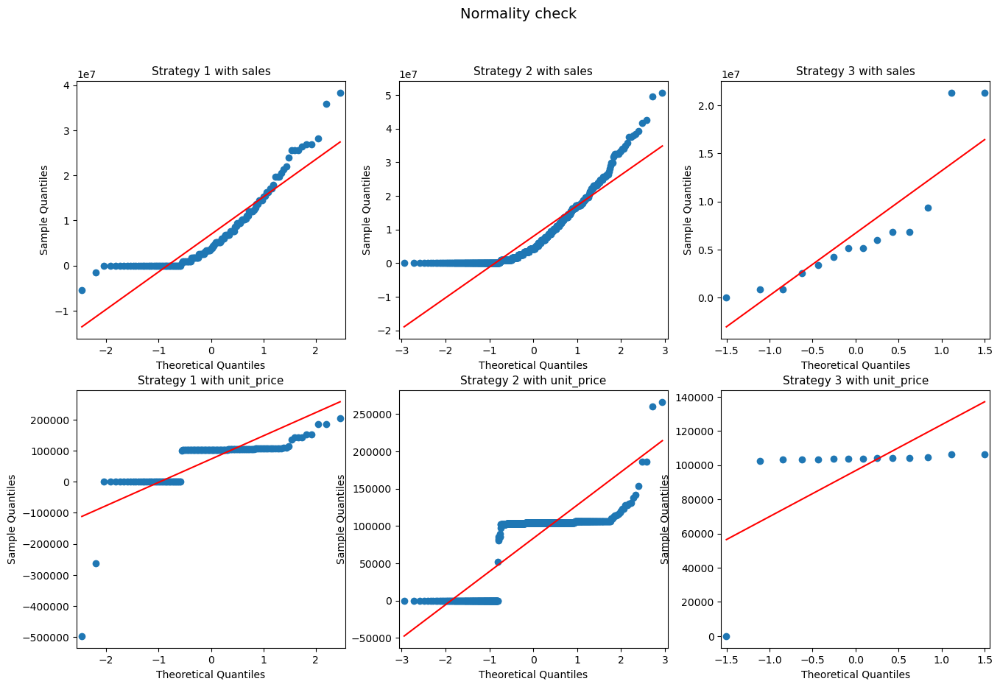

In [73]:
fig, axs = plt.subplots(2,3, figsize=(16,10))
qqplot(np.array(drug_df[(drug_df['strategy1'] == drug_df['strategy_expenditures']) & (drug_df['strategy1'] > 0)]['sales']), line='s', ax=axs[0,0])
qqplot(np.array(drug_df[(drug_df['strategy2'] == drug_df['strategy_expenditures']) & (drug_df['strategy2'] > 0)]['sales']), line='s', ax=axs[0,1])
qqplot(np.array(drug_df[(drug_df['strategy3'] == drug_df['strategy_expenditures']) & (drug_df['strategy3'] > 0)]['sales']), line='s', ax=axs[0,2])

qqplot(np.array(drug_df[(drug_df['strategy1'] == drug_df['strategy_expenditures']) & (drug_df['strategy1'] > 0)]['unit_price']), line='s', ax=axs[1,0])
qqplot(np.array(drug_df[(drug_df['strategy2'] == drug_df['strategy_expenditures']) & (drug_df['strategy2'] > 0)]['unit_price']), line='s', ax=axs[1,1])
qqplot(np.array(drug_df[(drug_df['strategy3'] == drug_df['strategy_expenditures']) & (drug_df['strategy3'] > 0)]['unit_price']), line='s', ax=axs[1,2])

fig.suptitle('Normality check', fontsize = 14)
axs[0,0].set_title('Strategy 1 with sales',  fontsize = 11)
axs[0,1].set_title('Strategy 2 with sales',  fontsize = 11)
axs[0,2].set_title('Strategy 3 with sales',  fontsize = 11)
axs[1,0].set_title('Strategy 1 with unit_price',  fontsize = 11)
axs[1,1].set_title('Strategy 2 with unit_price',  fontsize = 11)
axs[1,2].set_title('Strategy 3 with unit_price',  fontsize = 11)
plt.show()

In [74]:
#Normality Test - Shapiro Wilks Test
print(stats.shapiro(drug_df[(drug_df['strategy1'] == drug_df['strategy_expenditures']) & (drug_df['strategy1'] > 0)]['sales']))
print(stats.shapiro(drug_df[(drug_df['strategy2'] == drug_df['strategy_expenditures']) & (drug_df['strategy2'] > 0)]['sales']))
print(stats.shapiro(drug_df[(drug_df['strategy3'] == drug_df['strategy_expenditures']) & (drug_df['strategy3'] > 0)]['sales']))

ShapiroResult(statistic=0.8319554328918457, pvalue=1.3452607083852541e-11)
ShapiroResult(statistic=0.8229351043701172, pvalue=1.7980812296303295e-25)
ShapiroResult(statistic=0.779592752456665, pvalue=0.0028222736436873674)


All the three strategies fail the Shapiro Wilks as p-value is less than or equal to 0.05 threfore th null hypothesis that the data are normally distributed is rejected. We will do Anderson Darling Test

In [75]:
#Anderson Darling Test
print(stats.anderson(drug_df[(drug_df['strategy1'] == drug_df['strategy_expenditures']) & (drug_df['strategy1'] > 0)]['sales']))
print(stats.anderson(drug_df[(drug_df['strategy2'] == drug_df['strategy_expenditures']) & (drug_df['strategy2'] > 0)]['sales']))
print(stats.anderson(drug_df[(drug_df['strategy3'] == drug_df['strategy_expenditures']) & (drug_df['strategy3'] > 0)]['sales']))

AndersonResult(statistic=8.101636414257598, critical_values=array([0.561, 0.639, 0.767, 0.894, 1.064]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
AndersonResult(statistic=32.608512150622346, critical_values=array([0.572, 0.652, 0.782, 0.912, 1.085]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
AndersonResult(statistic=1.2246606442835102, critical_values=array([0.497, 0.566, 0.68 , 0.793, 0.943]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))


Since the test statistic is greater compared to all the critical values, we reject the Null Hypothesis. Since Normality Assumption has failed, we will perform Kruskal Wallis test

In [76]:
stats.kruskal(drug_df[(drug_df['strategy1'] == drug_df['strategy_expenditures']) & (drug_df['strategy1'] > 0)]['sales'],
              drug_df[(drug_df['strategy2'] == drug_df['strategy_expenditures']) & (drug_df['strategy2'] > 0)]['sales'],
              drug_df[(drug_df['strategy3'] == drug_df['strategy_expenditures']) & (drug_df['strategy3'] > 0)]['sales'])

KruskalResult(statistic=1.9917393456510615, pvalue=0.3694020458874732)

Based on Kruskal Walllis test, we can reject the Null Hypothesis that mean are same across all the groups. Since we need to find which group is better, we will perform Tukey Test

In [78]:
def data_selection_func(drug_df, list_of_strategies, include_salesVisit = False, quarter = False):
  if isinstance(list_of_strategies, list):
    if(all(x in ['strategy1', 'strategy2', 'strategy3'] for x in list_of_strategies)):
      n_strategies = len(list_of_strategies)
      if (n_strategies == 0  and include_salesVisit == False):
        print("drug_df[(drug_df['total_expenditures'] == 0)]")
        temp_df = drug_df[(drug_df['total_expenditures'] == 0)]
      elif (n_strategies == 0  and include_salesVisit == True):
        print("drug_df[(drug_df['strategy_expenditures'] == 0) & (drug_df['salesVisit_expenditures'] > 0)]")
        temp_df = drug_df[(drug_df['strategy_expenditures'] == 0) & (drug_df['salesVisit_expenditures'] > 0)]
      else:
        temp_sing = n_strategies
        if include_salesVisit:
          expenditures_addition_str = "drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == "
        else:
          expenditures_addition_str = "drug_df[(drug_df['total_expenditures'] == "
        expenditures_and_str = ""
        for strategy in list_of_strategies:
          expenditures_addition_str = expenditures_addition_str + "drug_df['"+strategy+"']"
          expenditures_and_str = expenditures_and_str + " & (drug_df['"+strategy+"'] > 0)"
          temp_sing = temp_sing - 1
          if temp_sing > 0:
            expenditures_addition_str = expenditures_addition_str + " + "
          else:
            expenditures_str = expenditures_addition_str + ")"
            expenditures_str = expenditures_str + expenditures_and_str + "]"
        print(expenditures_str)
        temp_df = eval(expenditures_str)
      return temp_df
    else:
      raise KeyError(", ".join(list_of_strategies) + " is not in ['strategy1', 'strategy2', 'strategy3']")
  else:
    raise TypeError("Please pass strategies in side list e.g., ['strategy1] or ['strategy1', 'strategy2'] or [] for no strategy")




In [80]:
data_with_zero_expenditures = data_selection_func(drug_df, [], False)
data_with_zero_expenditures['strategy_type'] = 'data_with_zero_expenditures'

data_only_with_salesVisit_expenditures = data_selection_func(drug_df, [], True)
data_only_with_salesVisit_expenditures['strategy_type'] = 'data_only_with_salesVisit_expenditures'

data_only_with_strategy1_expenditures = data_selection_func(drug_df, ['strategy1'], False)
data_only_with_strategy1_expenditures['strategy_type'] = 'data_only_with_strategy1_expenditures'

data_with_strategy1_and_salesVisit_expenditures = data_selection_func(drug_df, ['strategy1'], True)
data_with_strategy1_and_salesVisit_expenditures['strategy_type'] = 'data_with_strategy1_and_salesVisit_expenditures'

data_only_with_strategy2_expenditures = data_selection_func(drug_df, ['strategy2'], False)
data_only_with_strategy2_expenditures['strategy_type'] = 'data_only_with_strategy2_expenditures'

data_with_strategy2_and_salesVisit_expenditures = data_selection_func(drug_df, ['strategy2'], True)
data_with_strategy2_and_salesVisit_expenditures['strategy_type'] = 'data_with_strategy2_and_salesVisit_expenditures'

data_only_with_strategy3_expenditures = data_selection_func(drug_df, ['strategy3'], False)
data_only_with_strategy3_expenditures['strategy_type'] = 'data_only_with_strategy3_expenditures'

data_with_strategy3_and_salesVisit_expenditures = data_selection_func(drug_df, ['strategy3'], True)
data_with_strategy3_and_salesVisit_expenditures['strategy_type'] = 'data_with_strategy3_and_salesVisit_expenditures'

data_only_with_strategy1_and_strategy2_expenditures = data_selection_func(drug_df, ['strategy1', 'strategy2'], False)
data_only_with_strategy1_and_strategy2_expenditures['strategy_type'] = 'data_only_with_strategy1_and_strategy2_expenditures'

data_with_strategy1_strategy2_and_salesVisit_expenditures = data_selection_func(drug_df, ['strategy1', 'strategy2'], True)
data_with_strategy1_strategy2_and_salesVisit_expenditures['strategy_type'] = 'data_with_strategy1_strategy2_and_salesVisit_expenditures'

data_only_with_strategy1_and_strategy3_expenditures = data_selection_func(drug_df, ['strategy1', 'strategy3'], False)
data_only_with_strategy1_and_strategy3_expenditures['strategy_type'] = 'data_only_with_strategy1_and_strategy3_expenditures'

data_with_strategy1_strategy3_and_salesVisit_expenditures = data_selection_func(drug_df, ['strategy1', 'strategy3'], True)
data_with_strategy1_strategy3_and_salesVisit_expenditures['strategy_type'] = 'data_with_strategy1_strategy3_and_salesVisit_expenditures'

data_only_with_strategy2_and_strategy3_expenditures = data_selection_func(drug_df, ['strategy2', 'strategy3'], False)
data_only_with_strategy2_and_strategy3_expenditures['strategy_type'] = 'data_only_with_strategy2_and_strategy3_expenditures'

data_with_strategy2_strategy3_and_salesVisit_expenditures = data_selection_func(drug_df, ['strategy2', 'strategy3'], True)
data_with_strategy2_strategy3_and_salesVisit_expenditures['strategy_type'] = 'data_with_strategy2_strategy3_and_salesVisit_expenditures'

data_only_with_strategies_expenditures = data_selection_func(drug_df, ['strategy1','strategy2', 'strategy3'], False)
data_only_with_strategies_expenditures['strategy_type'] = 'data_only_with_strategies_expenditures'

data_with_all_type_of_expenditures = data_selection_func(drug_df, ['strategy1','strategy2', 'strategy3'], True)
data_with_all_type_of_expenditures['strategy_type'] = 'data_with_all_type_of_expenditures'

drug_df[(drug_df['total_expenditures'] == 0)]
drug_df[(drug_df['strategy_expenditures'] == 0) & (drug_df['salesVisit_expenditures'] > 0)]
drug_df[(drug_df['total_expenditures'] == drug_df['strategy1']) & (drug_df['strategy1'] > 0)]
drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy1']) & (drug_df['strategy1'] > 0)]
drug_df[(drug_df['total_expenditures'] == drug_df['strategy2']) & (drug_df['strategy2'] > 0)]
drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy2']) & (drug_df['strategy2'] > 0)]
drug_df[(drug_df['total_expenditures'] == drug_df['strategy3']) & (drug_df['strategy3'] > 0)]
drug_df[ (drug_df['salesVisit_expenditures'] > 0) & (drug_df['strategy_expenditures'] == drug_df['strategy3']) & (drug_df['strategy3'] > 0)]
drug_df[(drug_df['total_expenditures'] == drug_df['strategy1'] + drug_df['strategy2']) & (drug_df['strategy1'] > 0) & (drug_df['strategy2'] > 0)]
drug_df[ (d

In [81]:
data_with_all_type_of_strategies = pd.DataFrame(columns = ['accID', 'accType', 'accSize', 'accTargets', 'district', 'month',
       'sales', 'qty', 'strategy1', 'strategy2', 'strategy3', 'salesVisit1',
       'salesVisit2', 'salesVisit3', 'salesVisit4', 'salesVisit5', 'compBrand',
       'total_expenditures', 'strategy_expenditures',
       'salesVisit_expenditures', 'net_income', 'net_income_per_unit',
       'unit_price', 'quarter', 'strategy_type'])

for strategy_type in List_of_all_types_of_data:
  data_with_all_type_of_strategies = pd.concat([data_with_all_type_of_strategies, eval(strategy_type)], ignore_index=True)

data_with_all_type_of_strategies = data_with_all_type_of_strategies.replace(np.nan, 0).replace(-np.inf, 0).replace(np.inf, 0)
data_with_all_type_of_strategies['sales'] = data_with_all_type_of_strategies['sales'].astype(float)

In [82]:
def tukey_test(df, var):
    tukey=pairwise_tukeyhsd(endog=df['sales'],groups=df['strategy_type'], alpha=0.05)
    print(tukey)
    if df['strategy_type'].nunique() > 2:
      tukey.plot_simultaneous()
      title="Comparison between strategy_type in " + var
      plt.title(title)
      plt.xlabel("Sales")
      plt.ylabel("strateges")
      plt.show()

                                                             Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                              
                          group1                                                    group2                             meandiff    p-adj      lower          upper      reject
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures       data_only_with_strategy1_and_strategy2_expenditures  -1483188.6625    1.0 -23036938.3335  20070561.0084  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy1_expenditures  -1994607.4625 0.9975  -8834291.8489   4845076.9239  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures    461269

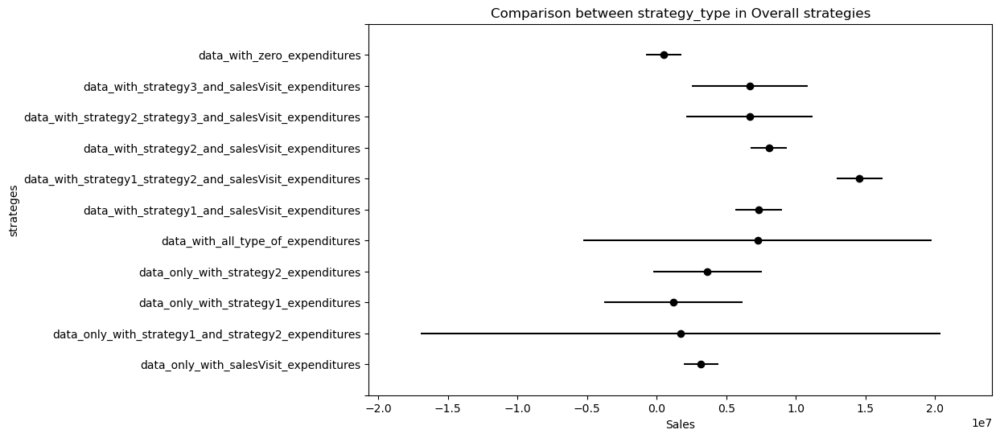

In [83]:
tukey_test(data_with_all_type_of_strategies,"Overall strategies")

                                                             Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                             
                          group1                                                    group2                             meandiff   p-adj      lower          upper      reject
-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures       data_only_with_strategy1_and_strategy2_expenditures -1218230.6941    1.0 -20602354.0612   18165892.673  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy1_expenditures -1597059.3608 0.9994   -8083381.301   4889262.5795  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures -1040654.2774 

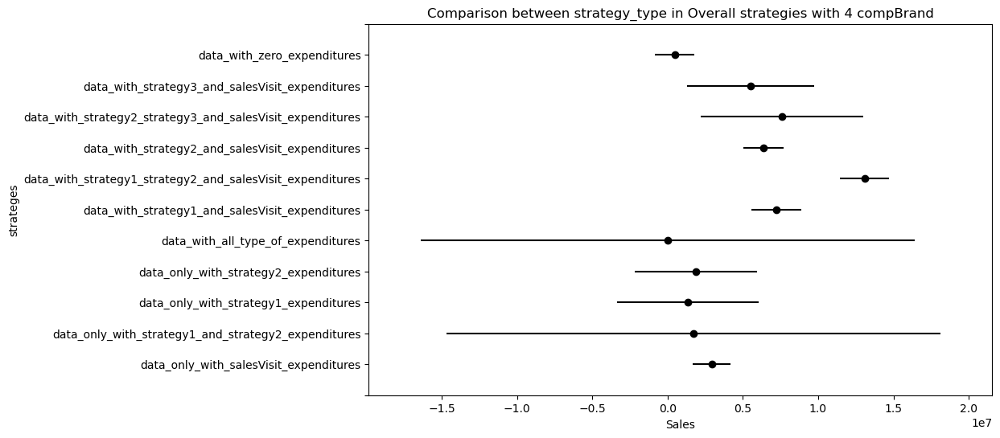

In [84]:
tukey_test(data_with_all_type_of_strategies[data_with_all_type_of_strategies['compBrand'] == 4],"Overall strategies with 4 compBrand")

                                                             Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                              
                          group1                                                    group2                             meandiff    p-adj      lower          upper      reject
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy1_expenditures  -4269743.0949    1.0 -30984529.4858   22445043.296  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures   4680091.1551 0.9839   -8755952.729  18116135.0393  False
                   data_only_with_salesVisit_expenditures                        data_with_all_type_of_expenditures  10220464

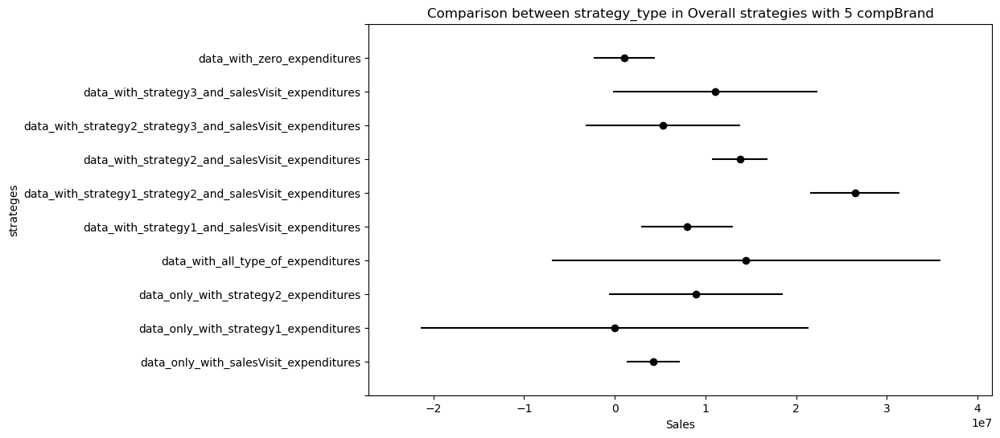

In [85]:
tukey_test(data_with_all_type_of_strategies[data_with_all_type_of_strategies['compBrand'] == 5],"Overall strategies with 5 compBrand")

In [86]:
data_with_strategies_Pharmacy = data_with_all_type_of_strategies[data_with_all_type_of_strategies['accType'] =='Pharmacy']
data_with_strategies_Hospital = data_with_all_type_of_strategies[data_with_all_type_of_strategies['accType'] =='Hospital']
data_with_strategies_Polyclinic = data_with_all_type_of_strategies[data_with_all_type_of_strategies['accType'] =='Polyclinic']
data_with_strategies_Private_Clinic = data_with_all_type_of_strategies[data_with_all_type_of_strategies['accType'] =='Private Clinic']

data_with_strategies_Pharmacy_4 = data_with_all_type_of_strategies[(data_with_all_type_of_strategies['accType'] =='Pharmacy') & (data_with_all_type_of_strategies['compBrand'] == 4)]
data_with_strategies_Hospital_4 = data_with_all_type_of_strategies[(data_with_all_type_of_strategies['accType'] =='Hospital') & (data_with_all_type_of_strategies['compBrand'] == 4)]
data_with_strategies_Polyclinic_4 = data_with_all_type_of_strategies[(data_with_all_type_of_strategies['accType'] =='Polyclinic') & (data_with_all_type_of_strategies['compBrand'] == 4)]
data_with_strategies_Private_Clinic_4 = data_with_all_type_of_strategies[(data_with_all_type_of_strategies['accType'] =='Private Clinic') & (data_with_all_type_of_strategies['compBrand'] == 4)]


data_with_strategies_Pharmacy_5 = data_with_all_type_of_strategies[(data_with_all_type_of_strategies['accType'] =='Pharmacy') & (data_with_all_type_of_strategies['compBrand'] == 5)]
data_with_strategies_Hospital_5 = data_with_all_type_of_strategies[(data_with_all_type_of_strategies['accType'] =='Hospital') & (data_with_all_type_of_strategies['compBrand'] == 5)]
data_with_strategies_Polyclinic_5 = data_with_all_type_of_strategies[(data_with_all_type_of_strategies['accType'] =='Polyclinic') & (data_with_all_type_of_strategies['compBrand'] == 5)]
data_with_strategies_Private_Clinic_5 = data_with_all_type_of_strategies[(data_with_all_type_of_strategies['accType'] =='Private Clinic') & (data_with_all_type_of_strategies['compBrand'] == 5)]

                                                             Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                             
                          group1                                                    group2                             meandiff    p-adj      lower          upper     reject
-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy1_expenditures  -7009519.9514 0.9996 -40014927.7147 25995887.8119  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures    235584.0486    1.0 -32769823.7147 33240991.8119  False
                   data_only_with_salesVisit_expenditures                        data_with_all_type_of_expenditures   6628323.0486

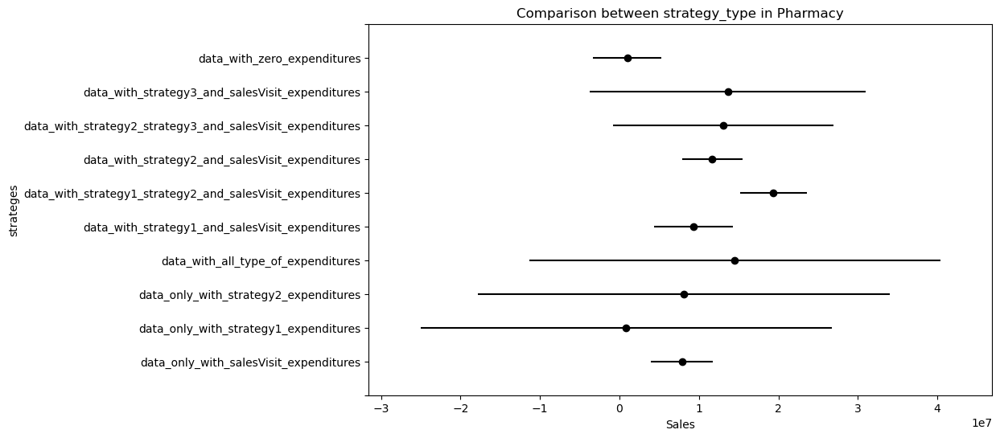

In [87]:
tukey_test(data_with_strategies_Pharmacy,"Pharmacy")

                                                             Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                              
                          group1                                                    group2                             meandiff    p-adj      lower          upper      reject
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy1_expenditures  -6175773.3471 0.9991 -34875561.0489  22524014.3546  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures   1069330.6529    1.0 -27630457.0489  29769118.3546  False
                   data_only_with_salesVisit_expenditures           data_with_strategy1_and_salesVisit_expenditures   2270632

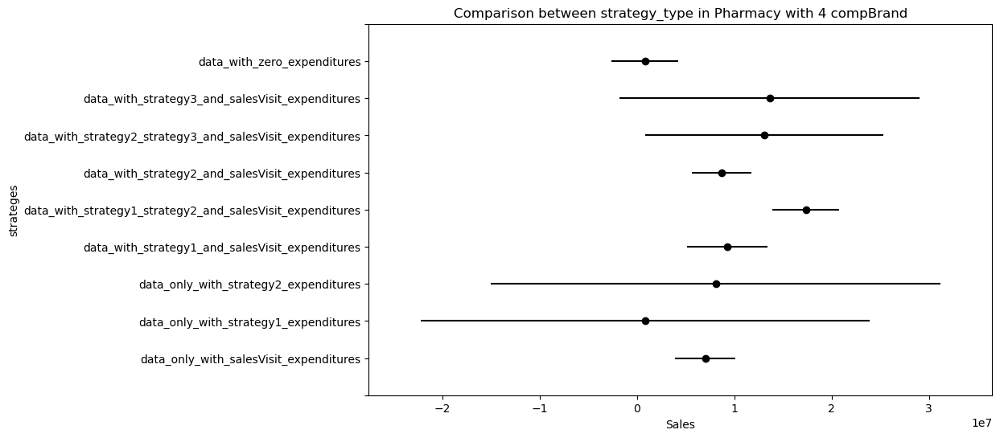

In [88]:
tukey_test(data_with_strategies_Pharmacy_4,"Pharmacy with 4 compBrand")

                                                             Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                             
                          group1                                                    group2                             meandiff    p-adj      lower          upper     reject
-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures                        data_with_all_type_of_expenditures    2242090.913    1.0 -33844691.9504 38328873.7765  False
                   data_only_with_salesVisit_expenditures           data_with_strategy1_and_salesVisit_expenditures  -2673214.7536 0.9992 -24358672.4171 19012242.9098  False
                   data_only_with_salesVisit_expenditures data_with_strategy1_strategy2_and_salesVisit_expenditures  19289394.7312

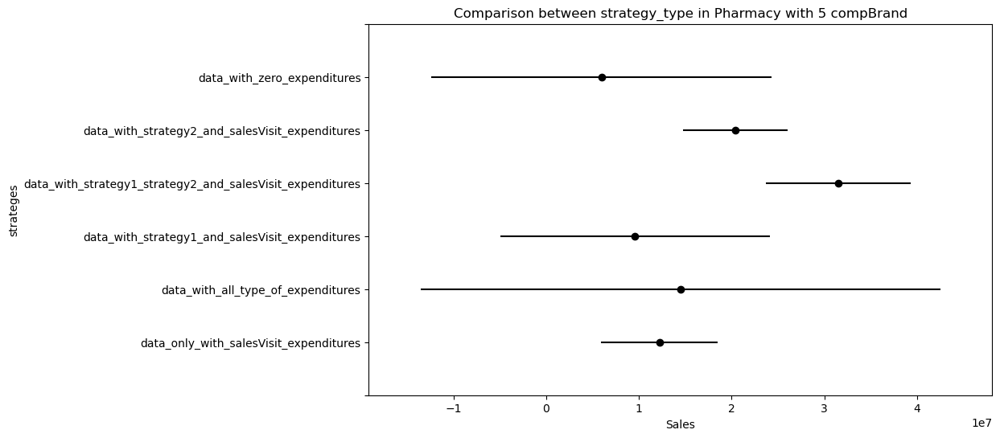

In [89]:
tukey_test(data_with_strategies_Pharmacy_5,"Pharmacy with 5 compBrand")

                                                            Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                             
                          group1                                                    group2                             meandiff   p-adj      lower          upper     reject
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures       data_only_with_strategy1_and_strategy2_expenditures -2448045.3011    1.0 -23475057.2897 18578966.6874  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy1_expenditures -1382588.5511    1.0 -11921418.1614  9156241.0591  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures  3802633.0322 0.942

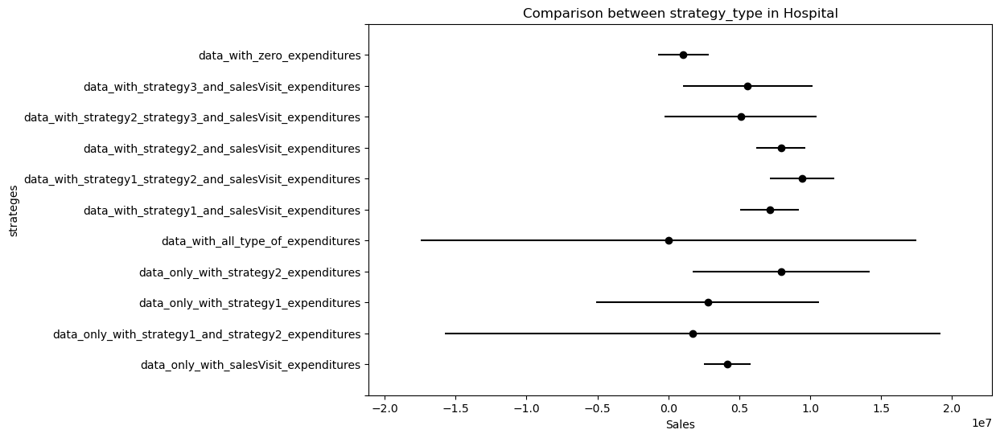

In [90]:
tukey_test(data_with_strategies_Hospital,"Hospital")

                                                            Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                             
                          group1                                                    group2                             meandiff   p-adj      lower          upper     reject
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures       data_only_with_strategy1_and_strategy2_expenditures -2049228.2996    1.0 -21473401.2963 17374944.6971  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy1_expenditures  -983771.5496    1.0 -10724663.1132   8757120.014  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures  -855916.6996    1.

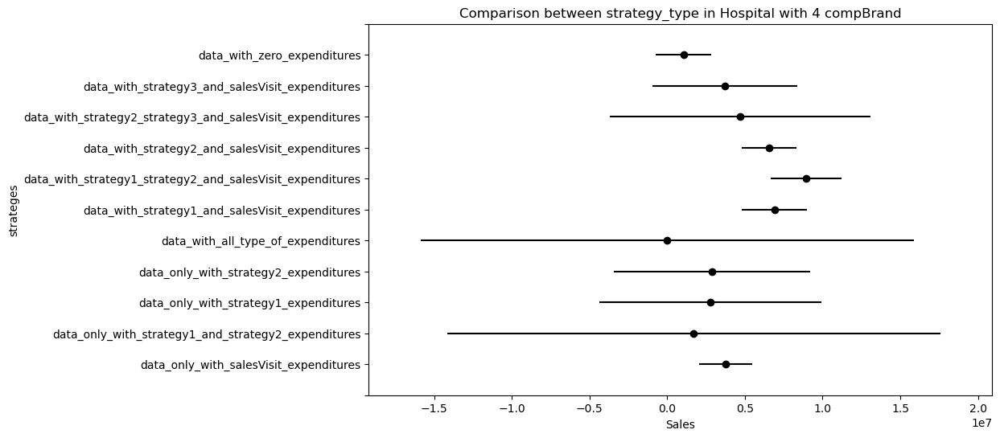

In [91]:
tukey_test(data_with_strategies_Hospital_4,"Hospital with 4 compBrand")

                                                             Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                             
                          group1                                                    group2                             meandiff    p-adj      lower          upper     reject
-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures  27371485.7692 0.0114   3689431.9122 51053539.6262   True
                   data_only_with_salesVisit_expenditures           data_with_strategy1_and_salesVisit_expenditures   3206932.9692 0.9113  -4562337.1528 10976203.0913  False
                   data_only_with_salesVisit_expenditures data_with_strategy1_strategy2_and_salesVisit_expenditures   9471816.7692

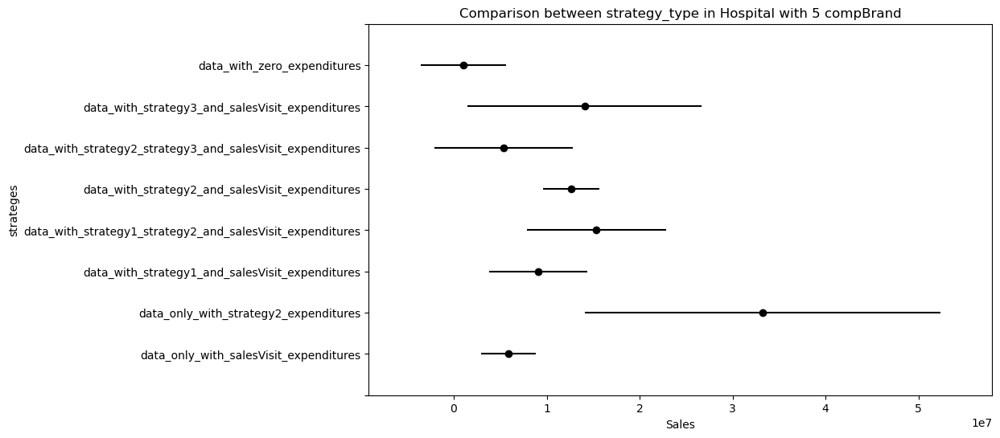

In [92]:
tukey_test(data_with_strategies_Hospital_5,"Hospital with 5 compBrand")

                                                           Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                            
                          group1                                                    group2                             meandiff   p-adj      lower        upper     reject
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy1_expenditures  -498572.4258 0.9976 -3089957.4671 2092812.6155  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures  -133273.1401    1.0 -1526647.2771 1260100.9968  False
                   data_only_with_salesVisit_expenditures           data_with_strategy1_and_salesVisit_expenditures   779975.4075 0.7245  -723269

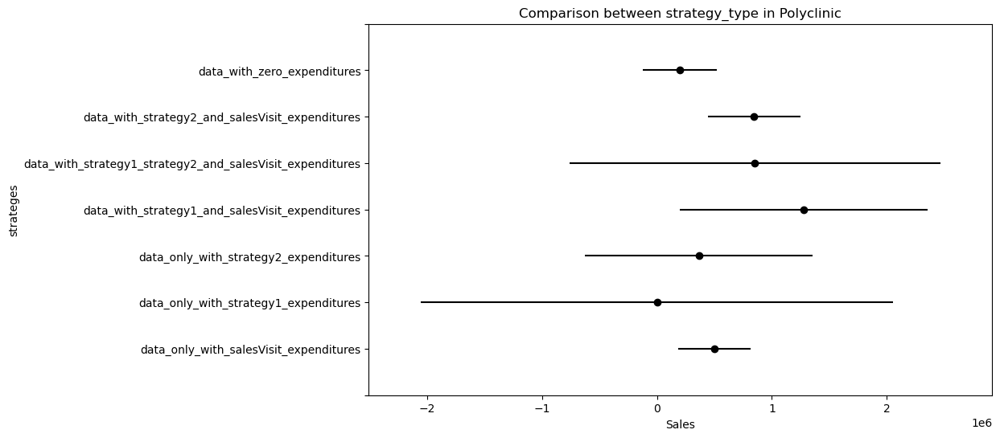

In [93]:
tukey_test(data_with_strategies_Polyclinic,"Polyclinic")

                                                           Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                            
                          group1                                                    group2                             meandiff   p-adj      lower        upper     reject
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy1_expenditures  -343736.5327 0.9999 -3514222.8978 2826749.8323  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures  -343736.5327 0.9955 -1936020.0601 1248546.9946  False
                   data_only_with_salesVisit_expenditures           data_with_strategy1_and_salesVisit_expenditures  1190520.8673 0.1726  -235753

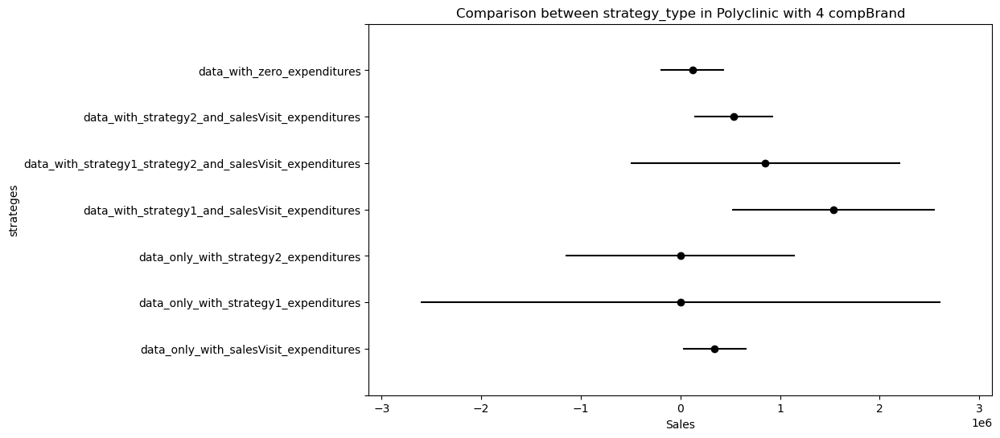

In [94]:
tukey_test(data_with_strategies_Polyclinic_4,"Polyclinic with 4 compBrand")

                                                 Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                  
                     group1                                          group2                        meandiff   p-adj      lower        upper     reject
------------------------------------------------------------------------------------------------------------------------------------------------------
         data_only_with_salesVisit_expenditures           data_only_with_strategy1_expenditures  -1133021.939 0.9863 -6130200.8892 3864157.0112  False
         data_only_with_salesVisit_expenditures           data_only_with_strategy2_expenditures   -280656.939 0.9998 -3200333.1494 2639019.2713  False
         data_only_with_salesVisit_expenditures data_with_strategy1_and_salesVisit_expenditures  -1133021.939 0.9863 -6130200.8892 3864157.0112  False
         data_only_with_salesVisit_expenditures data_with_strategy2_and_salesVisit_expenditure

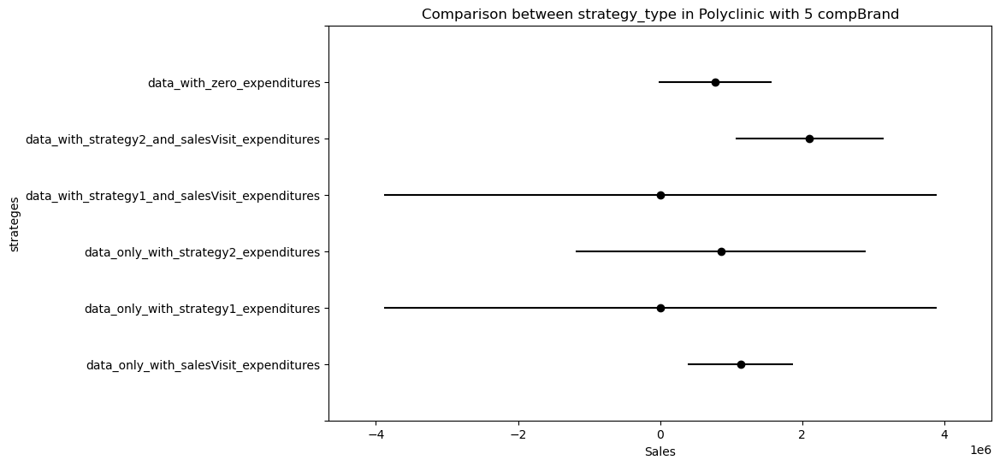

In [95]:
tukey_test(data_with_strategies_Polyclinic_5,"Polyclinic with 5 compBrand")

                                                            Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                             
                          group1                                                    group2                             meandiff   p-adj      lower          upper     reject
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy1_expenditures -1750244.9612 0.9793  -7315824.0338  3815334.1115  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures -1750244.9612 0.9936  -8534430.2964   5033940.374  False
                   data_only_with_salesVisit_expenditures           data_with_strategy1_and_salesVisit_expenditures  -613757.9612    1.

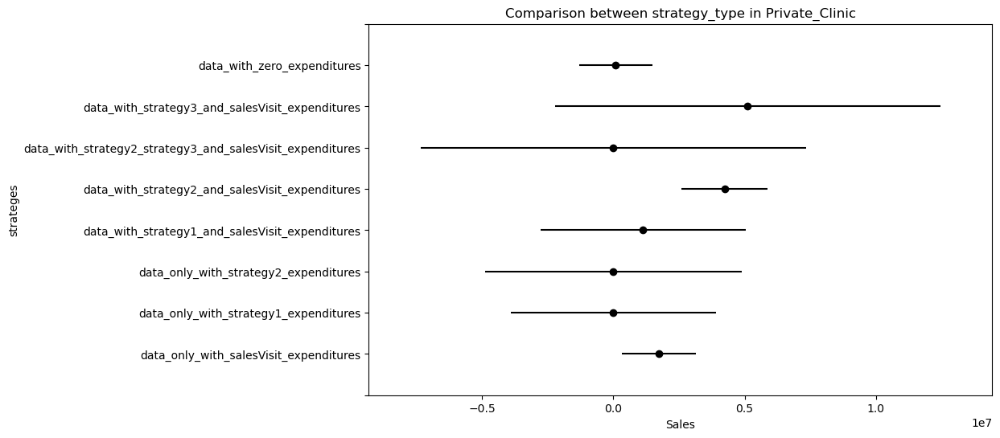

In [96]:
tukey_test(data_with_strategies_Private_Clinic,"Private_Clinic")

                                                            Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                             
                          group1                                                    group2                             meandiff   p-adj      lower          upper     reject
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy1_expenditures -2243377.7639 0.9014  -7907853.6352  3421098.1074  False
                   data_only_with_salesVisit_expenditures                     data_only_with_strategy2_expenditures -2243377.7639 0.9601  -9134510.0806  4647754.5528  False
                   data_only_with_salesVisit_expenditures           data_with_strategy1_and_salesVisit_expenditures  -538647.2639    1.

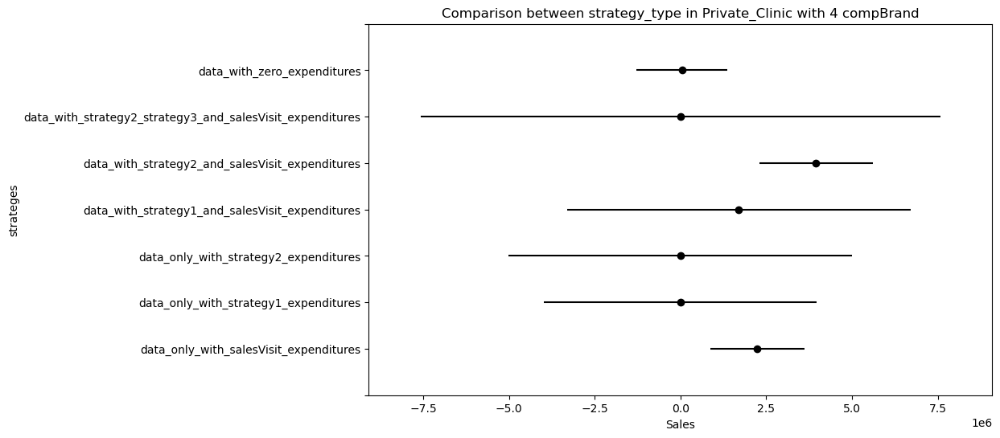

In [97]:
tukey_test(data_with_strategies_Private_Clinic_4,"Private_Clinic with 4 compBrand")

                                                  Multiple Comparison of Means - Tukey HSD, FWER=0.05                                                   
                     group1                                          group2                        meandiff   p-adj      lower          upper     reject
--------------------------------------------------------------------------------------------------------------------------------------------------------
         data_only_with_salesVisit_expenditures data_with_strategy1_and_salesVisit_expenditures  -604904.2581 0.9986  -6759677.0707  5549868.5546  False
         data_only_with_salesVisit_expenditures data_with_strategy2_and_salesVisit_expenditures  4793408.5753 0.0001   2091552.1052  7495265.0453   True
         data_only_with_salesVisit_expenditures data_with_strategy3_and_salesVisit_expenditures  4509286.7419 0.2427  -1645486.0707 10664059.5546  False
         data_only_with_salesVisit_expenditures                     data_with_zero

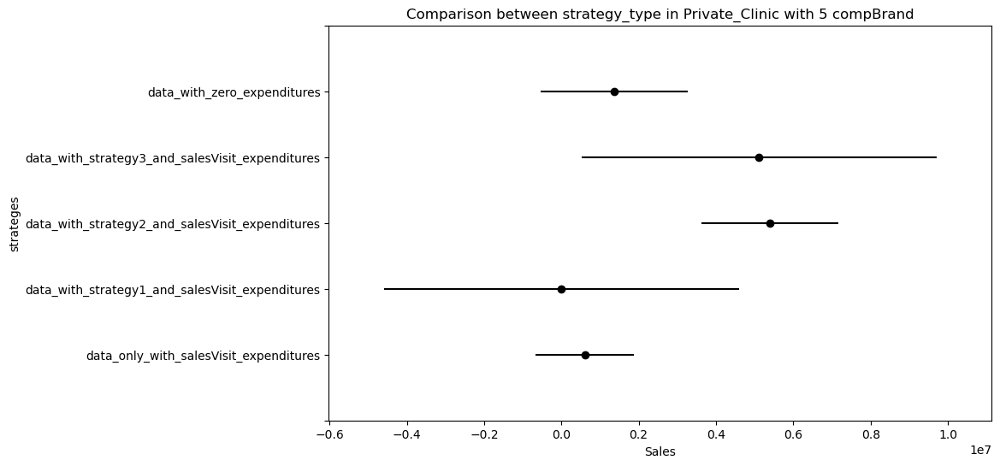

In [98]:
tukey_test(data_with_strategies_Private_Clinic_5,"Private_Clinic with 5 compBrand")

### Finding:
1. All the three strategies fail the Shapiro Wilks as p-value is less than or equal to 0.05 therefore the null hypothesis that the data are normally distributed is rejected.
2. Based Anderson Darling Test the test statistic is greater compared to all the critical values, we reject the Null Hypothesis. Since Normality Assumption has failed for strategy1,strategy2,strategy3
3. Based on Kruskal Walllis test, we can reject the Null Hypothesis that mean are same across all the groups(strategy1,strategy2,strategy3)

#4. Best Result from Tukey Test
### a. Over all:
        i)  data_with_strategy1_strategy2_and_salesVisit_expenditures
### b. presence of new drug
        i)   Hospital : data_only_with_strategy2_expenditures
        ii)  Pharmacy : data_only_with_salesVisit_expenditures and  data_with_strategy1_strategy2_and_salesVisit_expenditures
        iii) Poly clinic: data_with_strategy2_and_salesVisit_expenditures
        iv)  Private clinic: data_with_strategy2_and_salesVisit_expenditures and data_only_with_salesVisit_expenditures